In [1]:
# Import necessary libraries
import os
import time
import psutil
import librosa
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout, Bidirectional, BatchNormalization, GlobalAveragePooling1D
from tensorflow.keras.callbacks import Callback, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, CSVLogger
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
import tensorflow as tf
import parselmouth


In [2]:
# Check GPU availability
def check_gpu():
    gpus = tf.config.list_physical_devices('GPU')
    if gpus:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print(f"Found {len(gpus)} GPU(s): {[gpu.name for gpu in gpus]}")
    else:
        print("No GPU devices found.")
    return gpus

check_gpu()

Found 1 GPU(s): ['/physical_device:GPU:0']


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [3]:
# Callback to stop training after a specified time limit
class TimeLimit(Callback):
    def __init__(self, hours):
        super().__init__()
        self.limit = hours * 3600
        self.start = None

    def on_train_begin(self, logs=None):
        self.start = time.time()

    def on_epoch_end(self, epoch, logs=None):
        if time.time() - self.start > self.limit:
            print(f"You have run for more than {self.limit/3600:.1f} hours, stopping.")
            self.model.stop_training = True


In [4]:

# Callback to print progress
class Progress(Callback):
    def __init__(self):
        super().__init__()
        self.last_time = time.time()

    def on_epoch_begin(self, epoch, logs=None):
        print(f"\nEpoch {epoch+1}/400")
        self.last_time = time.time()

    def on_batch_end(self, batch, logs=None):
        if batch % 10 == 0:
            current_time = time.time()
            print(f"Batch {batch}, loss: {logs['loss']:.4f}, time: {current_time - self.last_time:.2f}s")
            self.last_time = current_time

In [ ]:
# Callback to monitor memory usage
#class MemoryUsage(Callback):
    #def on_epoch_end(self, epoch, logs=None):
        #print(f"RAM Usage: {psutil.Process().memory_info().rss / 1024 / 1024:.2f} MB")

In [8]:
def extract_features(audio_path, rttm_path, output_dir):
    try:
        os.makedirs(output_dir, exist_ok=True)
        filename = Path(audio_path).stem
        print(f"Processing file: {filename}")

        # Load audio using librosa for MFCC extraction
        audio, sr = librosa.load(audio_path, sr=None)
        hop_length = 512

        # Extract F0 using parselmouth
        sound = parselmouth.Sound(audio_path)
        pitch = sound.to_pitch(time_step=hop_length / sr)
        f0 = pitch.selected_array['frequency']
        f0 = np.where(f0 > 0, f0, 0)

        # Extract MFCC using librosa
        mfcc = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=13, hop_length=hop_length).T
        time = librosa.frames_to_time(np.arange(len(mfcc)), sr=sr, hop_length=hop_length)

        # Ensure f0 and time have the same length
        min_length = min(len(f0), len(time))
        f0 = f0[:min_length]
        time = time[:min_length]

        df = pd.DataFrame({'time': time, 'F0': f0})
        for i in range(mfcc.shape[1]):
            df[f'MFCC_{i+1}'] = mfcc[:min_length, i]

        df['speaker'] = ''
        if os.path.exists(rttm_path):
            with open(rttm_path, 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    start_time, duration, speaker = float(parts[3]), float(parts[4]), parts[7]
                    mask = (df['time'] >= start_time) & (df['time'] < (start_time + duration))
                    df.loc[mask, 'speaker'] = speaker

        df['Label'] = (df['speaker'] != df['speaker'].shift(1)).astype(int)
        df.to_csv(os.path.join(output_dir, f"{filename}_features.csv"), index=False)
        return True
    except Exception as e:
        print(f"Error processing {audio_path}: {str(e)}")
        return False

In [28]:
import pandas as pd

# Load the features CSV file
df = pd.read_csv('C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\New session\\Ses01F_impro01_features.csv')

# Display the top ten lines of the DataFrame
print(df.head(10))

    time   F0      MFCC_1     MFCC_2     MFCC_3     MFCC_4     MFCC_5  \
0  0.000  0.0  -69.628975  15.522291 -50.016235  11.158049 -22.432968   
1  0.032  0.0  -83.490570  18.859728 -54.906128  15.887014 -31.639133   
2  0.064  0.0 -142.149260  22.125004 -47.303886  25.457293 -24.822605   
3  0.096  0.0 -180.241520  30.812970 -30.473549  38.558280  -9.388384   
4  0.128  0.0 -209.867390  35.576004 -21.114986  53.902706  -0.006636   
5  0.160  0.0 -240.183290  29.971280 -19.075806  56.152172  -0.224858   
6  0.192  0.0 -273.703370  23.709950 -11.017614  56.818607   0.058581   
7  0.224  0.0 -311.575100  18.349342  -3.572881  59.603180   2.396767   
8  0.256  0.0 -335.156700  17.359430   0.683571  54.829033  -0.562584   
9  0.288  0.0 -360.722200  17.713726   6.190329  52.446815  -2.682403   

      MFCC_6     MFCC_7     MFCC_8     MFCC_9    MFCC_10    MFCC_11   MFCC_12  \
0  23.665804 -35.208140  11.437664 -27.208817  19.289051 -23.124740 -2.891694   
1  23.817630 -38.062958  12.010540

In [10]:
# Process session files
def process_session(session_id):
    base_dir = 'C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\IEMOCAP\\IEMOCAP'
    session_dir = os.path.join(base_dir, f'Session{session_id}', 'dialog', 'wav')
    output_dir = 'C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\New session'
    audio_files = [f for f in os.listdir(session_dir) if f.endswith('.wav')]
    processed_count = 0

    for audio_file in audio_files:
        audio_path = os.path.join(session_dir, audio_file)
        rttm_path = os.path.join(base_dir, 'reference', f'{Path(audio_file).stem}.rttm')
        if extract_features(audio_path, rttm_path, output_dir):
            processed_count += 1

    return processed_count


# # Process all sessions
total_processed = 0
for session_id in range(1, 6):
    total_processed += process_session(session_id)

print(f"\nTotal files processed: {total_processed}")

Processing file: Ses01F_impro01
Processing file: Ses01F_impro02
Processing file: Ses01F_impro03
Processing file: Ses01F_impro04
Processing file: Ses01F_impro05
Processing file: Ses01F_impro06
Processing file: Ses01F_impro07
Processing file: Ses01F_script01_1
Processing file: Ses01F_script01_2
Processing file: Ses01F_script01_3
Processing file: Ses01F_script02_1
Processing file: Ses01F_script02_2
Processing file: Ses01F_script03_1
Processing file: Ses01F_script03_2
Processing file: Ses01M_impro01
Processing file: Ses01M_impro02
Processing file: Ses01M_impro03
Processing file: Ses01M_impro04
Processing file: Ses01M_impro05
Processing file: Ses01M_impro06
Processing file: Ses01M_impro07
Processing file: Ses01M_script01_1
Processing file: Ses01M_script01_2
Processing file: Ses01M_script01_3
Processing file: Ses01M_script02_1
Processing file: Ses01M_script02_2
Processing file: Ses01M_script03_1
Processing file: Ses01M_script03_2
Processing file: Ses02F_impro01
Processing file: Ses02F_impro0

In [11]:
# Visualize features
def visualize_features(csv_file_path):
    df = pd.read_csv(csv_file_path)
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 10))
    ax1.plot(df['time'], df['F0'])
    ax1.set_title('Fundamental Frequency (F0) Over Time')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Frequency (Hz)')

    mfcc_cols = [col for col in df.columns if col.startswith('MFCC')]
    im = ax2.imshow(df[mfcc_cols].T, aspect='auto', origin='lower')
    ax2.set_title('MFCC Features Over Time')
    ax2.set_xlabel('Time Frame')
    ax2.set_ylabel('MFCC Coefficient')
    plt.colorbar(im, ax=ax2)
    plt.tight_layout()
    plt.show()

In [13]:
# Prepare dataset
def prepare_dataset():
    features_dir = 'C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\New session'
    train_data, val_data, test_data = [], [], []
    csv_files = [f for f in os.listdir(features_dir) if f.endswith('_features.csv')]

    for csv_file in csv_files:
        df = pd.read_csv(os.path.join(features_dir, csv_file))
        session_num = int(csv_file[3:5])
        features = df[['F0'] + [f'MFCC_{i}' for i in range(1, 14)]].values
        target = df['Label'].values

        if session_num <= 3:
            train_data.append((features, target))
        elif session_num == 4:
            val_data.append((features, target))
        else:
            test_data.append((features, target))

    return train_data, val_data, test_data

In [14]:
# Create model
def create_model(input_shape):
    model = Sequential([
        Bidirectional(LSTM(128, return_sequences=True, kernel_regularizer=tf.keras.regularizers.l2(0.02)), input_shape=input_shape),
        BatchNormalization(),
        Dropout(0.5),
        Bidirectional(LSTM(64, return_sequences=True, kernel_regularizer=tf.keras.regularizers.l2(0.02))),
        BatchNormalization(),
        Dropout(0.5),
        GlobalAveragePooling1D(),
        Dense(64, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.02)),
        BatchNormalization(),
        Dropout(0.5),
        Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.02)),
        BatchNormalization(),
        Dropout(0.5),
        Dense(1, activation='sigmoid')
    ])

    optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, clipnorm=1.0)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy', tf.keras.metrics.Recall(), tf.keras.metrics.Precision(), tf.keras.metrics.AUC()])
    return model

In [15]:
# Prepare sequences
def prepare_sequences(data, window_size):
    X_sequences, y_sequences = [], []
    for features, target in data:
        scaler = StandardScaler()
        features = scaler.fit_transform(features)
        augmented_features = [features]

        noise_levels = [0.005, 0.01]
        for level in noise_levels:
            augmented_features.append(features + np.random.normal(0, level, features.shape))

        if len(features) > window_size * 2:
            stretch_rates = [0.9, 1.1]
            for rate in stretch_rates:
                try:
                    stretched = librosa.effects.time_stretch(features.T, rate=rate).T
                    if len(stretched) >= len(features):
                        augmented_features.append(stretched[:len(features)])
                except:
                    pass

        padded_features = [np.pad(aug, ((window_size-1, 0), (0, 0)), mode='reflect') for aug in augmented_features]
        change_indices = np.where(target == 1)[0]
        no_change_indices = np.where(target == 0)[0]
        n_changes = len(change_indices)
        n_no_changes = min(len(no_change_indices), n_changes * 2)

        distances = np.array([np.min(np.abs(idx - change_indices)) for idx in no_change_indices])
        weights = np.exp(-distances / window_size)
        weights /= np.sum(weights)

        sampled_no_change = np.random.choice(no_change_indices, size=n_no_changes, replace=False, p=weights)
        selected_indices = np.concatenate([change_indices, sampled_no_change])
        np.random.shuffle(selected_indices)

        for i in selected_indices:
            if i + window_size <= len(padded_features[0]):
                X_sequences.append(padded_features[0][i:i+window_size])
                y_sequences.append(target[i])

                for j in range(1, len(padded_features)):
                    if i + window_size <= len(padded_features[j]) and np.random.random() < 0.3:
                        X_sequences.append(padded_features[j][i:i+window_size])
                        y_sequences.append(target[i])

                        if np.random.random() < 0.2:
                            idx1, idx2 = np.random.choice(len(padded_features), 2, replace=False)
                            if (i + window_size <= len(padded_features[idx1]) and i + window_size <= len(padded_features[idx2])):
                                alpha = np.random.beta(0.4, 0.4)
                                mixed = alpha * padded_features[idx1][i:i+window_size] + (1 - alpha) * padded_features[idx2][i:i+window_size]
                                X_sequences.append(mixed)
                                y_sequences.append(target[i])

    return np.array(X_sequences), np.array(y_sequences)

In [16]:
# Train model
def train_model():
    train_data, val_data, test_data = prepare_dataset()
    window_size = 100
    X_train, y_train = prepare_sequences(train_data, window_size)
    X_val, y_val = prepare_sequences(val_data, window_size)
    model = create_model((window_size, X_train.shape[-1]))

    callbacks = [
        ModelCheckpoint('best_model.keras', monitor='val_auc', save_best_only=True, mode='max'),
        ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=8, min_lr=0.00001, mode='min'),
        EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True),
        TimeLimit(hours=1),
        Progress(),
        #MemoryUsage(),
        CSVLogger('training_log.csv')
    ]

    print("Starting GPU training...")
    start_time = time.time()
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=400, batch_size=128, callbacks=callbacks, shuffle=True, verbose=1, use_multiprocessing=True, workers=4)
    print(f"Training took {(time.time() - start_time)/60:.2f} minutes")
    return model, history

In [17]:
# Evaluate model
def evaluate_model(model, test_data, window_size):
    X_test, y_test = prepare_sequences(test_data, window_size)
    y_pred = model.predict(X_test)
    fpr, tpr, thresholds = roc_curve(y_test, y_pred)
    optimal_idx = np.argmax(tpr - fpr)
    optimal_threshold = thresholds[optimal_idx]
    y_pred_binary = (y_pred > optimal_threshold).astype(int)

    print(f"Optimal threshold: {optimal_threshold:.3f}")
    print("Classification Report:")
    print(classification_report(y_test, y_pred_binary))
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred_binary))

    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, label=f'ROC curve (AUC = {auc(fpr, tpr):.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend()
    plt.show()

In [18]:
# Plot training history
def plot_training_history(history):
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'])

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'])
    plt.tight_layout()
    plt.show()


Found 1 GPU(s): ['/physical_device:GPU:0']


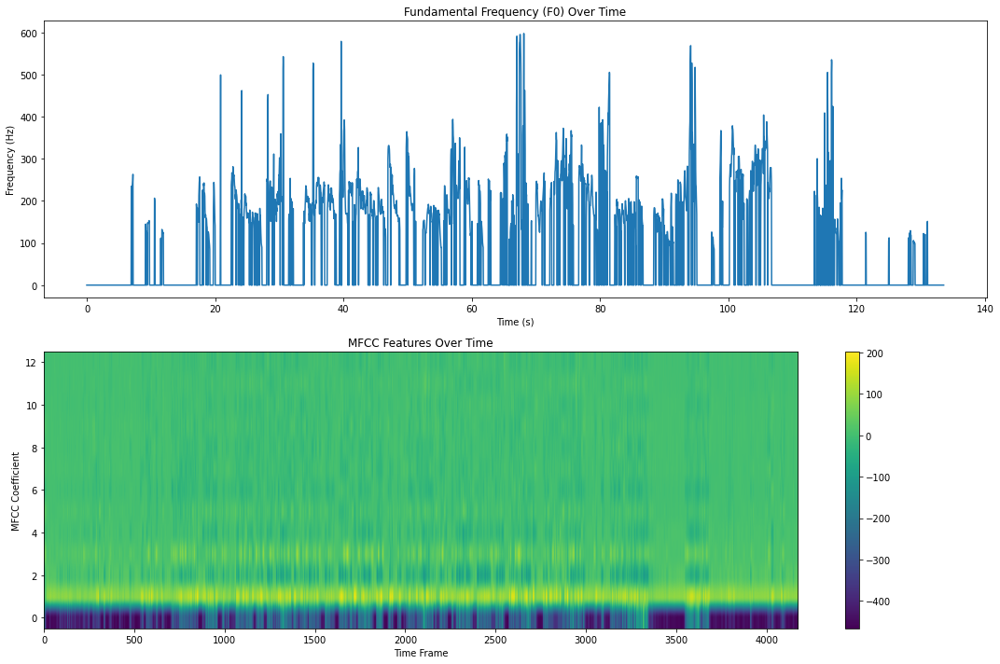

Starting GPU training...
Train on 35400 samples, validate on 12529 samples

Epoch 1/400
Epoch 1/400
Batch 0, loss: 14.7506, time: 205.62s
35400/35400 [==============================] - 226s 6ms/sample - loss: 12.4114 - accuracy: 0.5106 - recall: 0.4889 - precision: 0.3398 - auc: 0.5080 - val_loss: 10.0531 - val_accuracy: 0.5754 - val_recall: 0.3059 - val_precision: 0.3451 - val_auc: 0.5068

Epoch 2/400
Epoch 2/400
Batch 0, loss: 10.1763, time: 0.05s
35400/35400 [==============================] - 19s 528us/sample - loss: 8.5117 - accuracy: 0.5287 - recall: 0.4247 - precision: 0.3380 - auc: 0.5050 - val_loss: 6.8568 - val_accuracy: 0.6344 - val_recall: 0.1461 - val_precision: 0.3752 - val_auc: 0.5336

Epoch 3/400
Epoch 3/400
Batch 0, loss: 6.9692, time: 0.06s
35400/35400 [==============================] - 19s 523us/sample - loss: 5.8793 - accuracy: 0.5448 - recall: 0.3763 - precision: 0.3386 - auc: 0.5056 - val_loss: 4.7771 - val_accuracy: 0.6512 - val_recall: 0.0621 - val_precision: 0.3

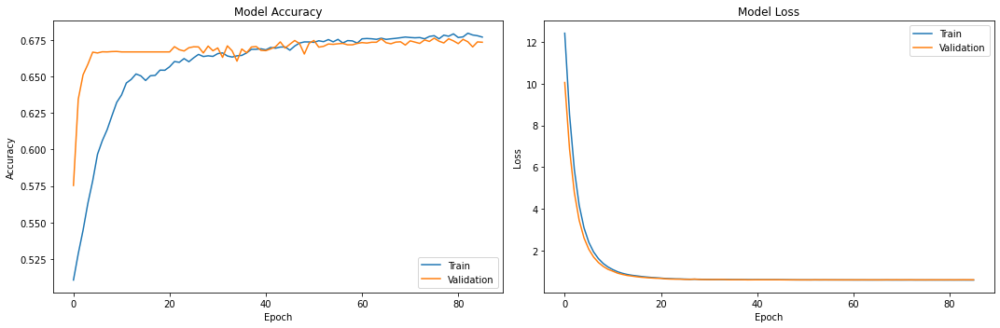

Optimal threshold: 0.357
Classification Report:
              precision    recall  f1-score   support

           0       0.77      0.59      0.67      9610
           1       0.44      0.64      0.52      4800

    accuracy                           0.61     14410
   macro avg       0.60      0.62      0.59     14410
weighted avg       0.66      0.61      0.62     14410

Confusion Matrix:
[[5713 3897]
 [1747 3053]]


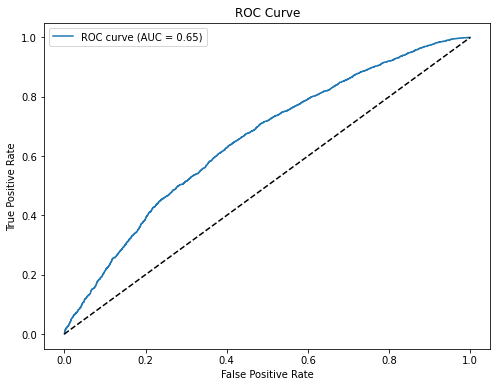

In [20]:
# Main execution
if __name__ == "__main__":
    check_gpu()
    features_dir = 'C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\New session'
    sample_csv = os.path.join(features_dir, 'Ses01F_impro01_features.csv')
    if os.path.exists(sample_csv):
        visualize_features(sample_csv)
    else:
        print(f"File not found: {sample_csv}")

    model, history = train_model()
    plot_training_history(history)
    _, _, test_data = prepare_dataset()
    evaluate_model(model, test_data, 100)

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_impro01_features.csv


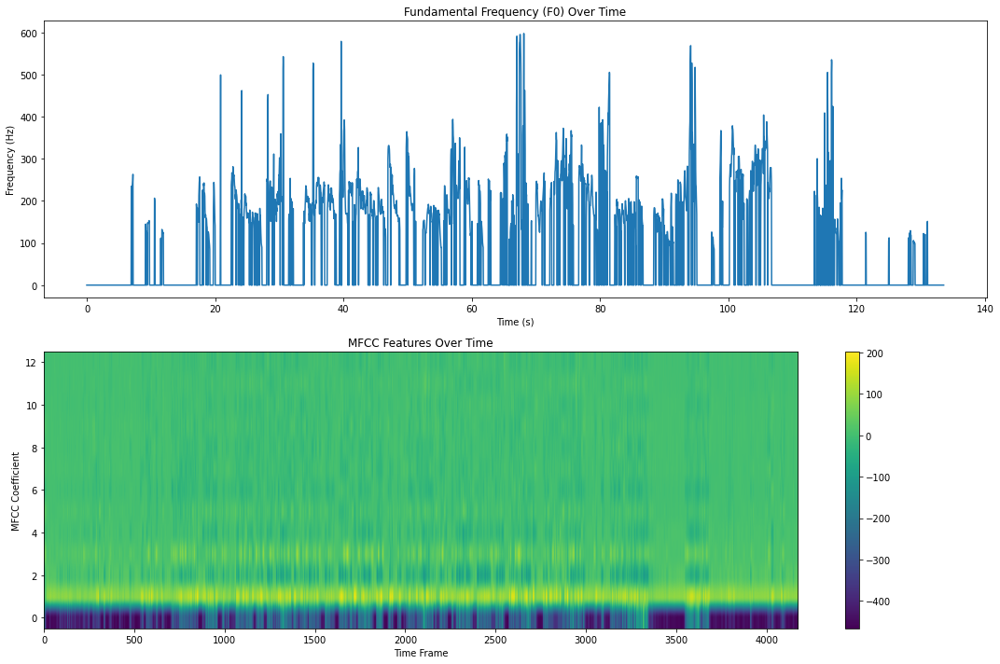

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_impro02_features.csv


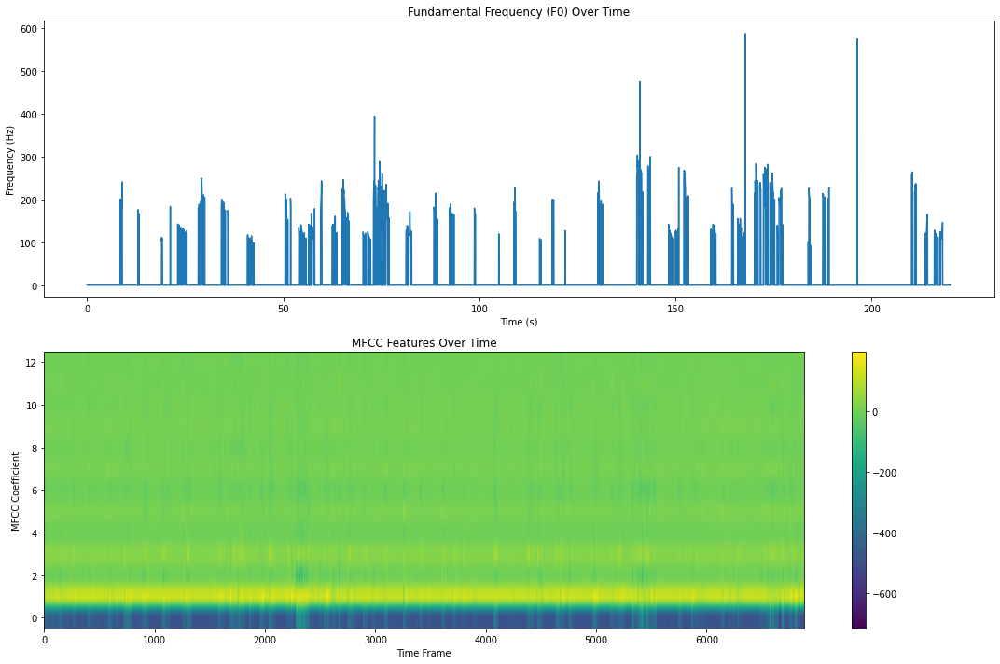

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_impro03_features.csv


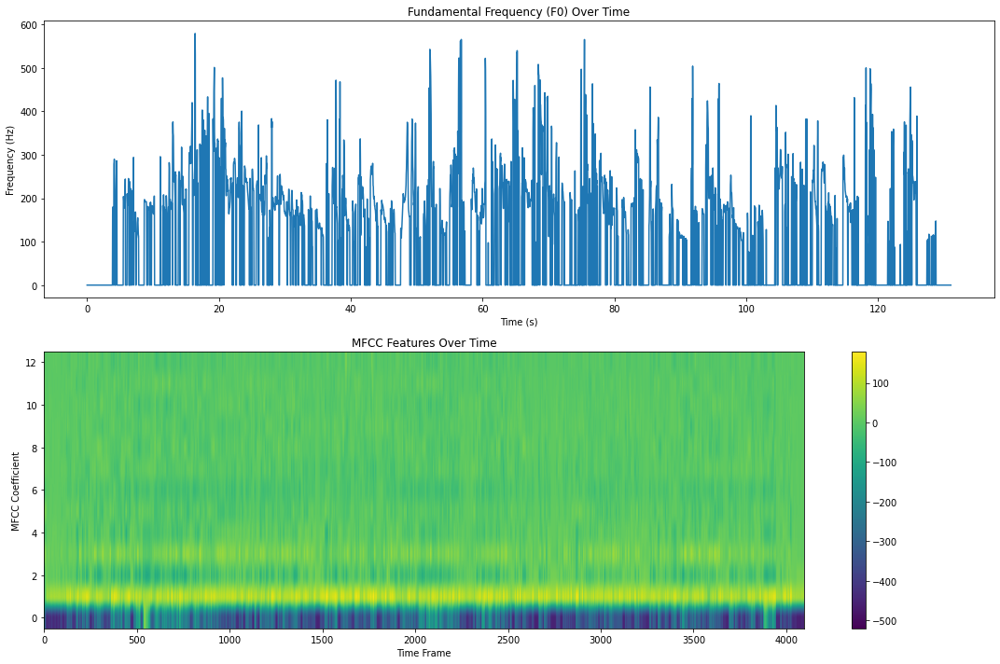

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_impro04_features.csv


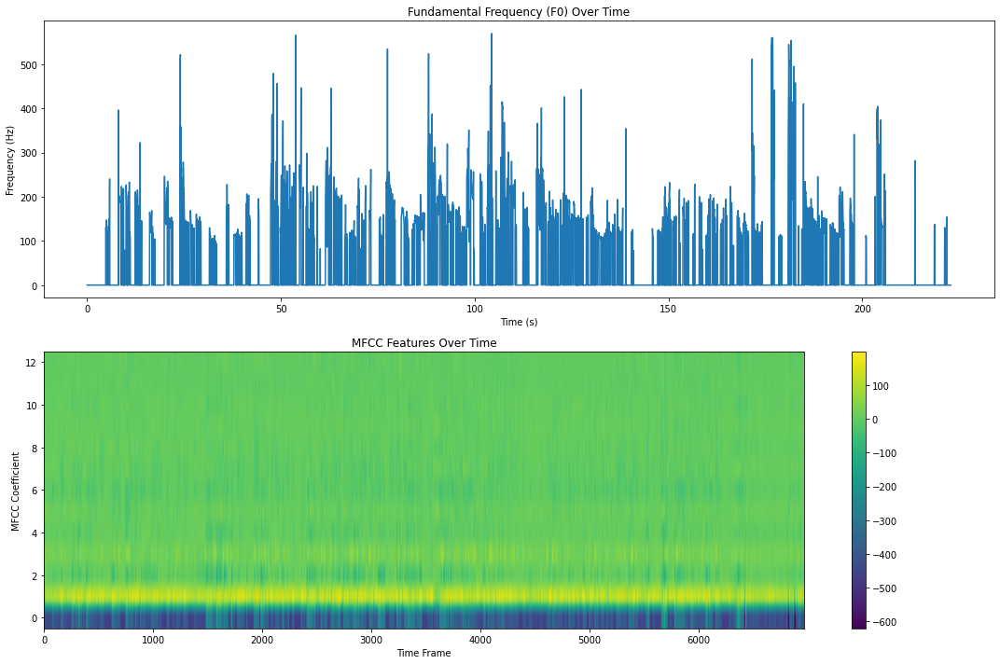

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_impro05_features.csv


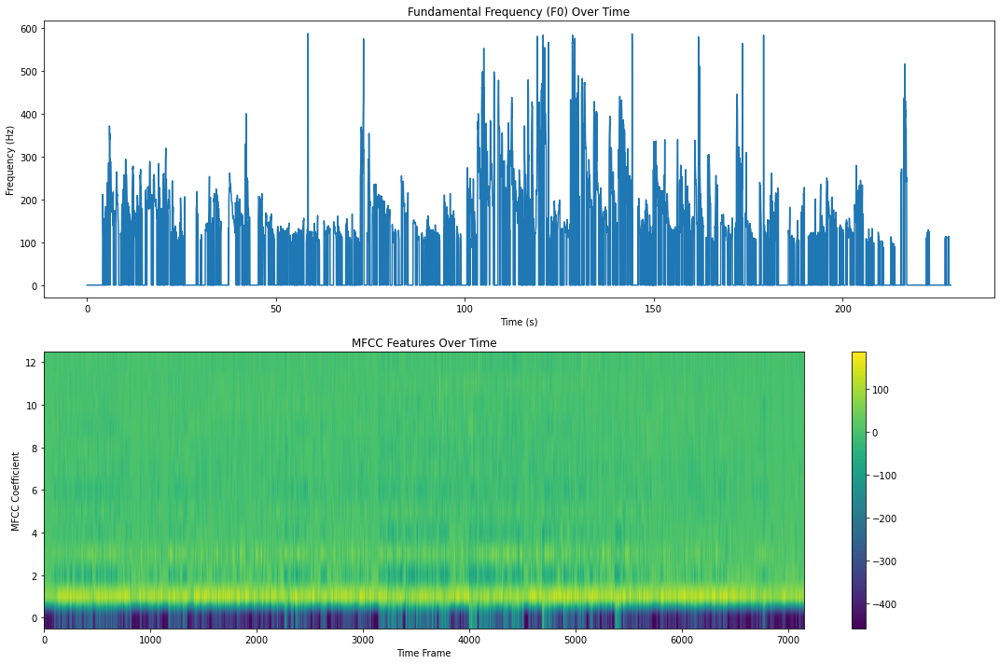

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_impro06_features.csv


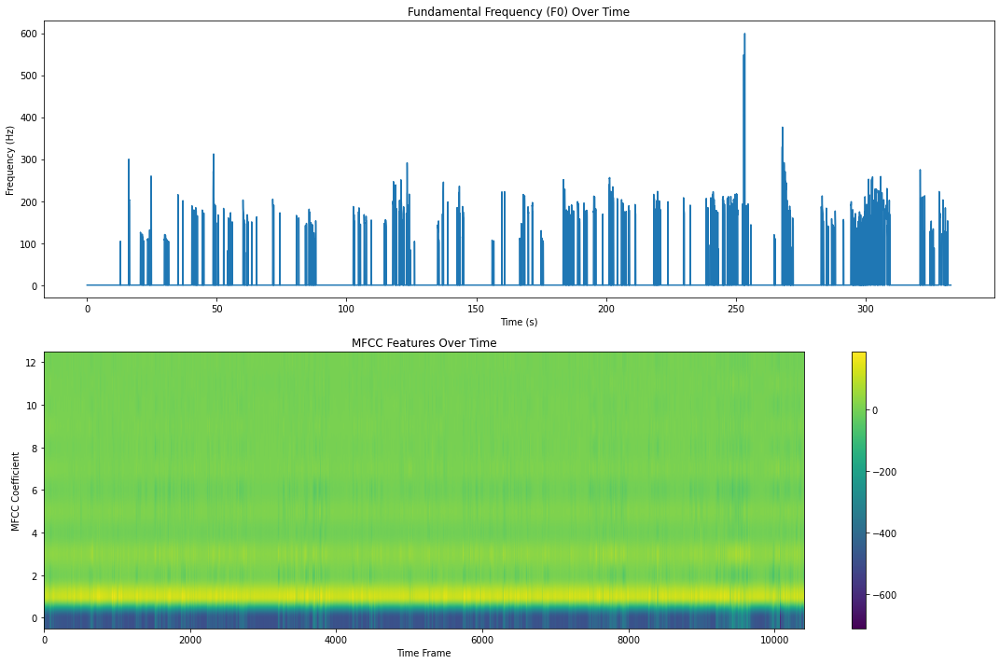

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_impro07_features.csv


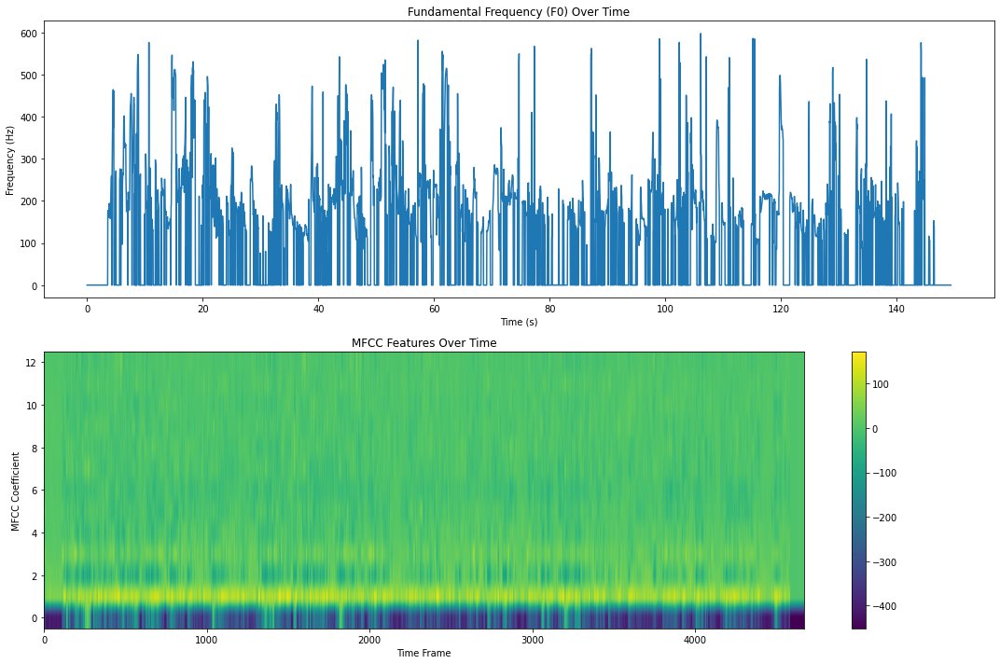

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_script01_1_features.csv


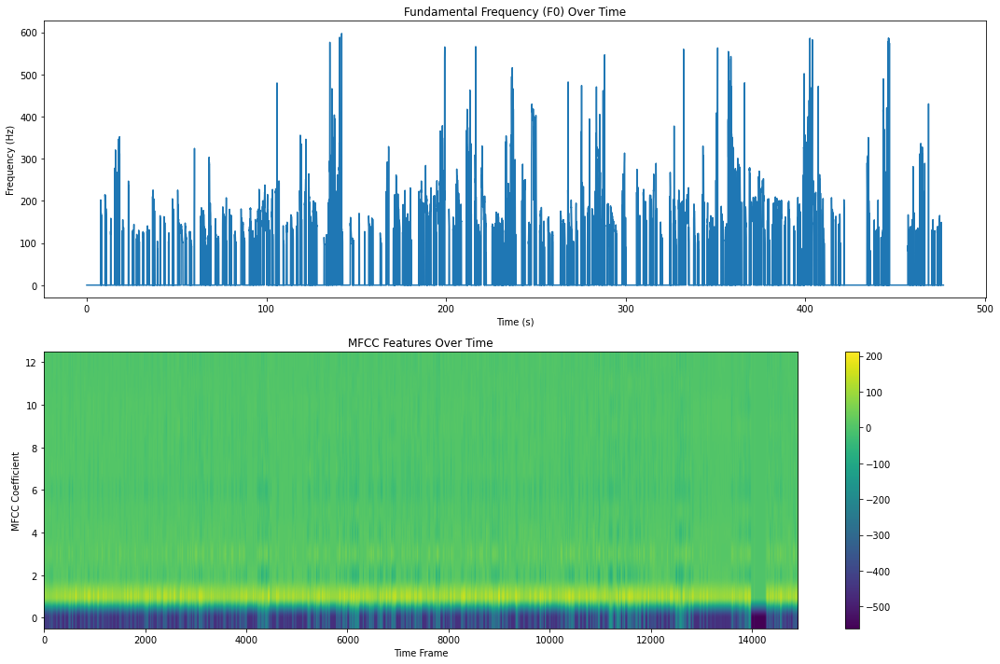

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_script01_2_features.csv


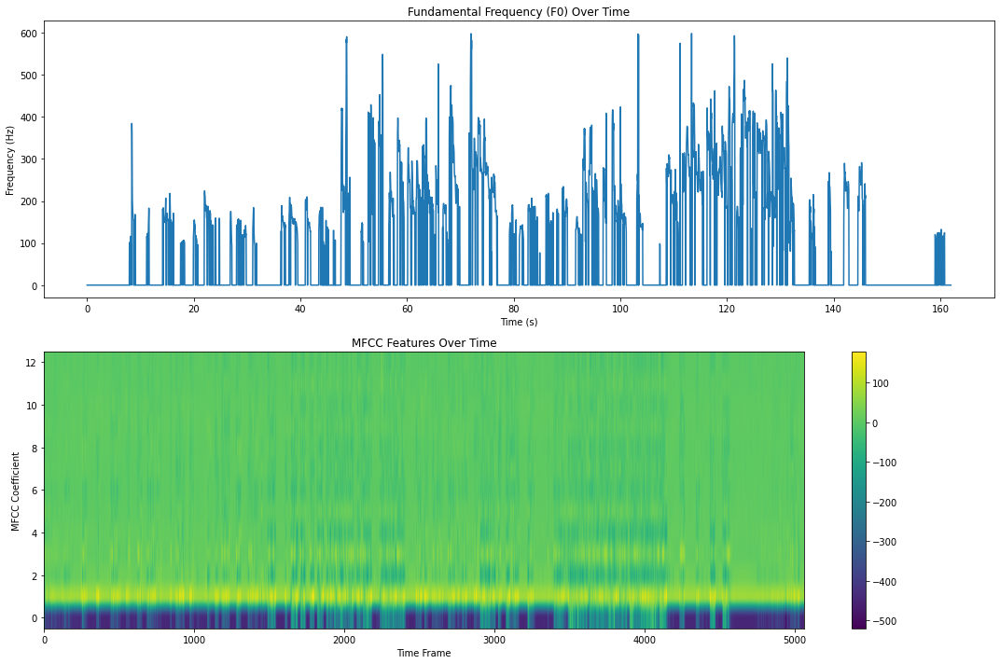

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_script01_3_features.csv


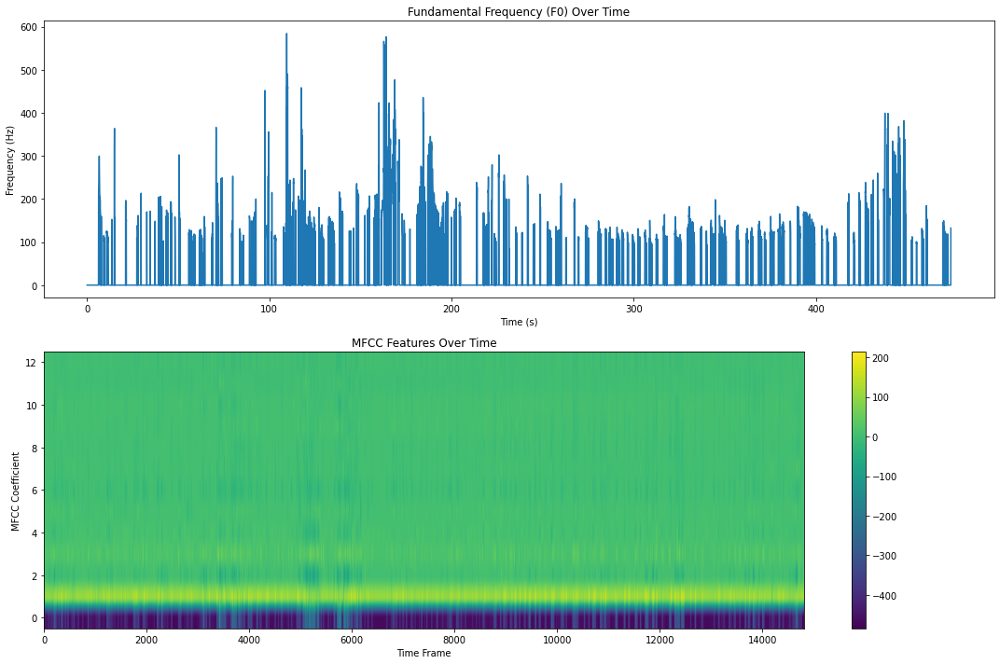

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_script02_1_features.csv


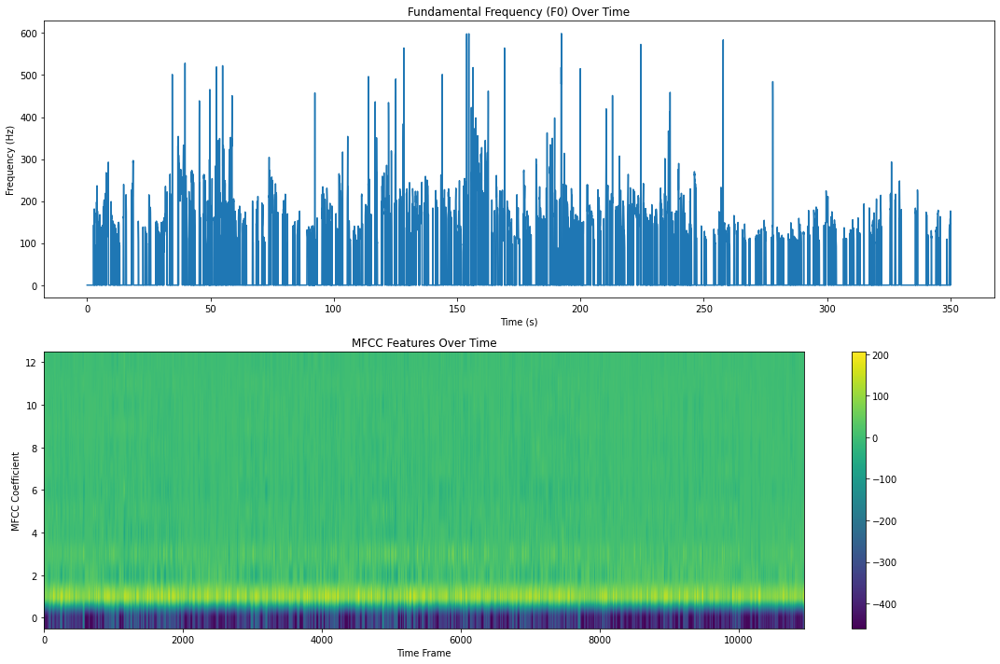

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_script02_2_features.csv


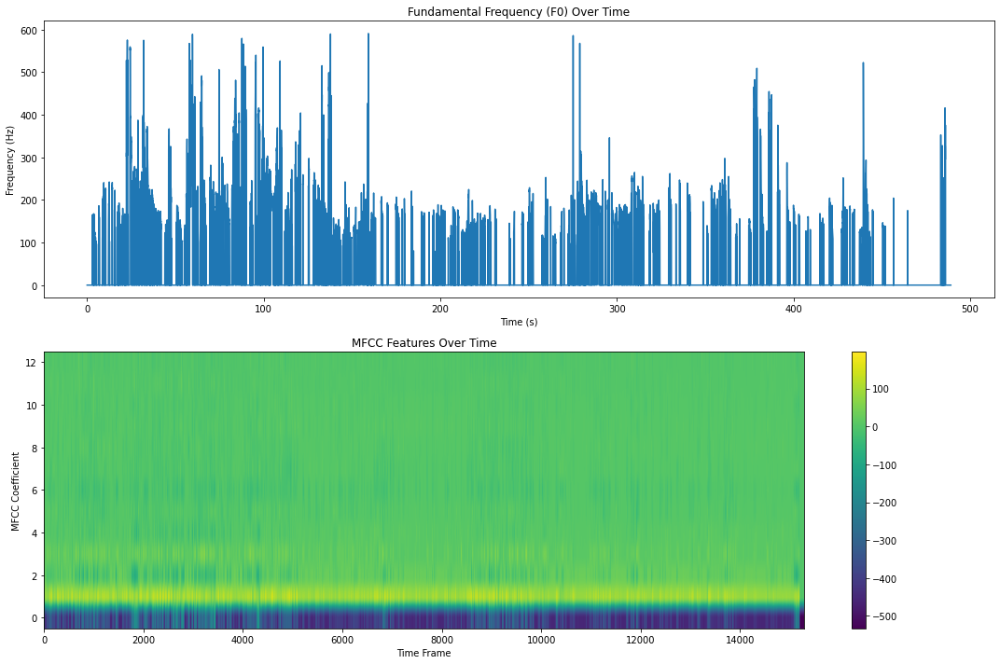

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_script03_1_features.csv


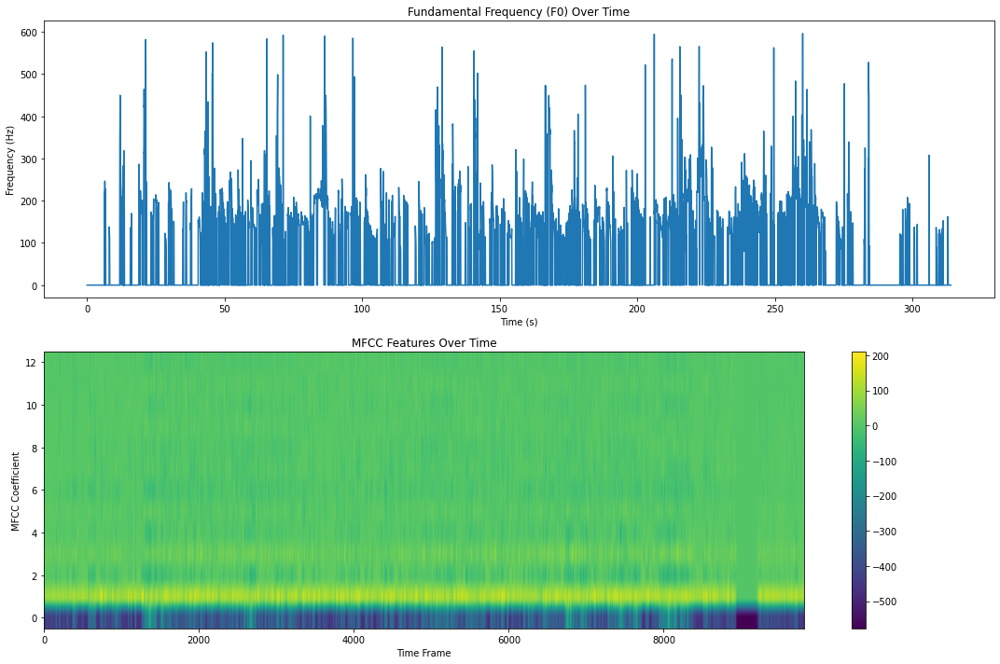

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01F_script03_2_features.csv


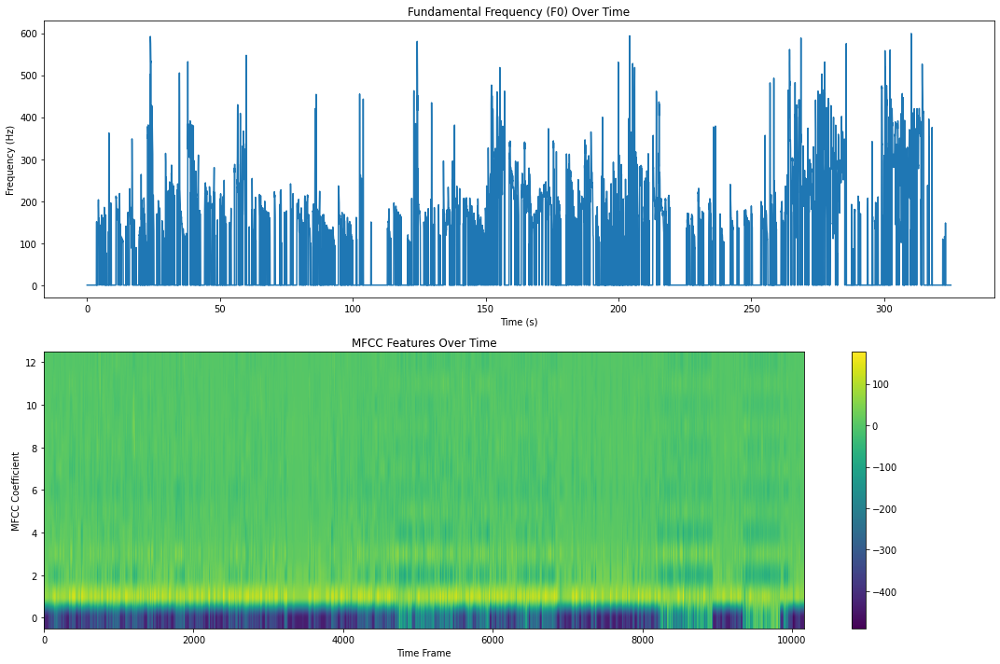

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_impro01_features.csv


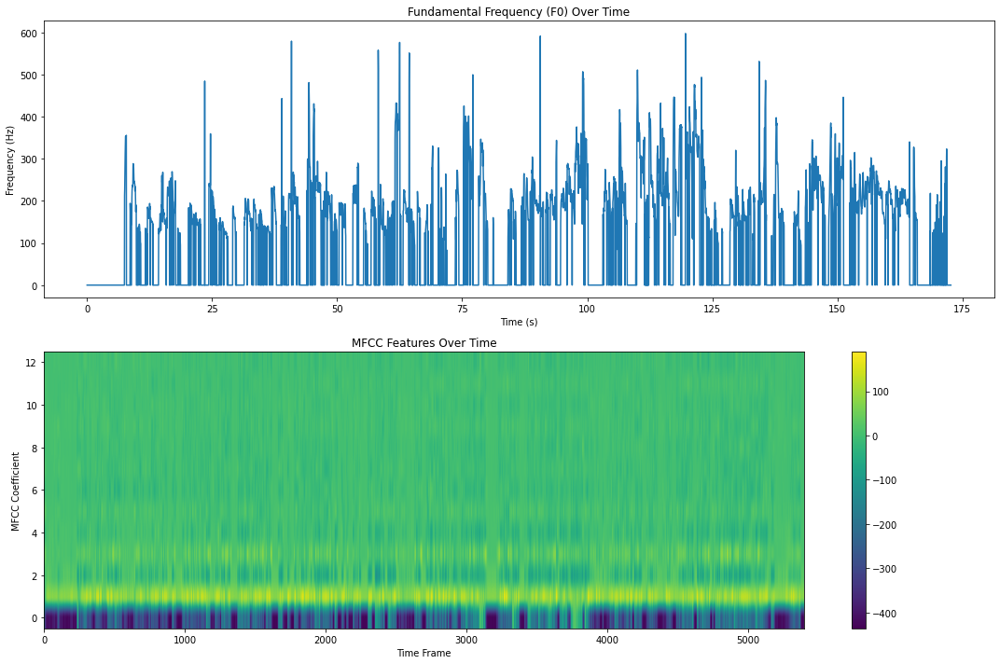

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_impro02_features.csv


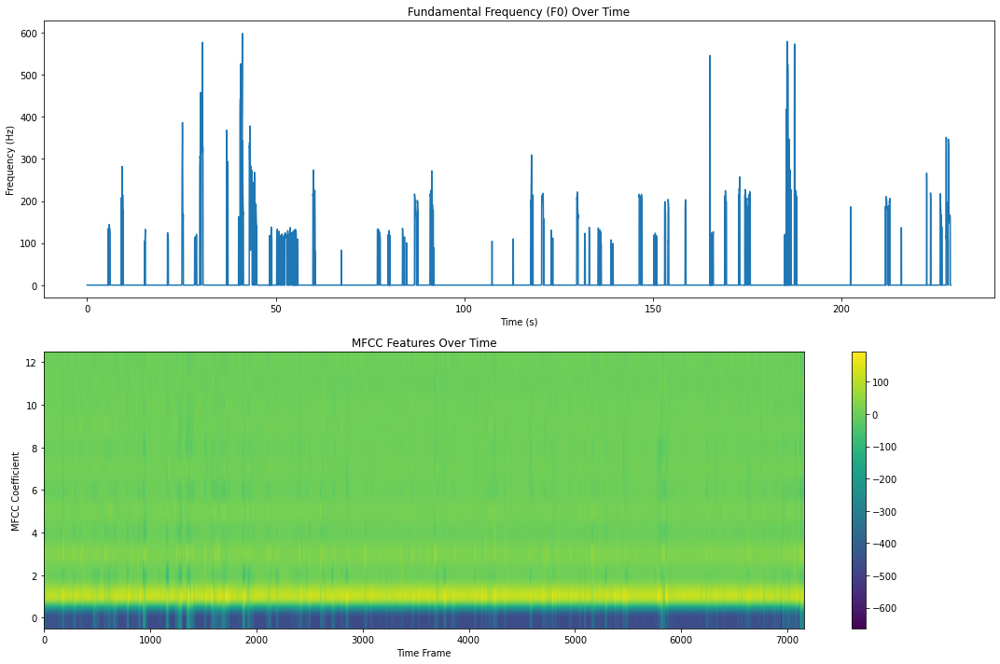

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_impro03_features.csv


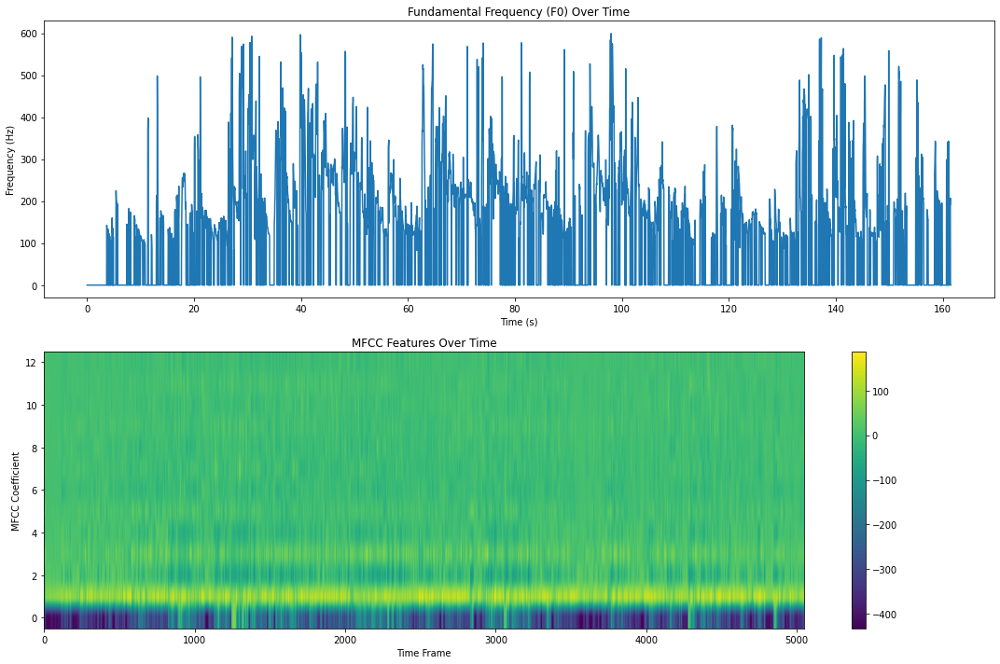

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_impro04_features.csv


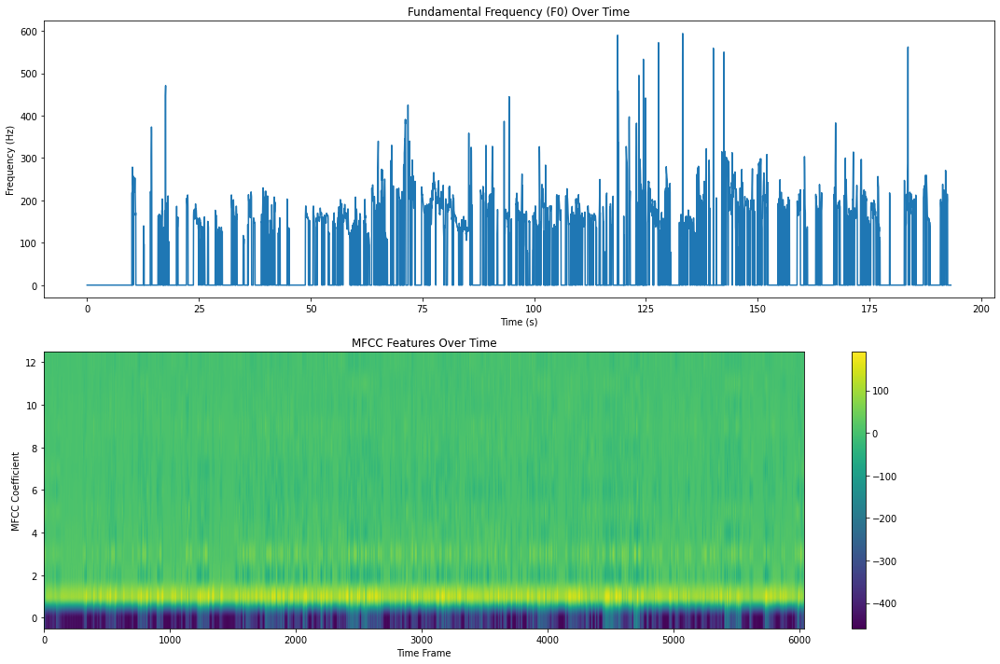

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_impro05_features.csv


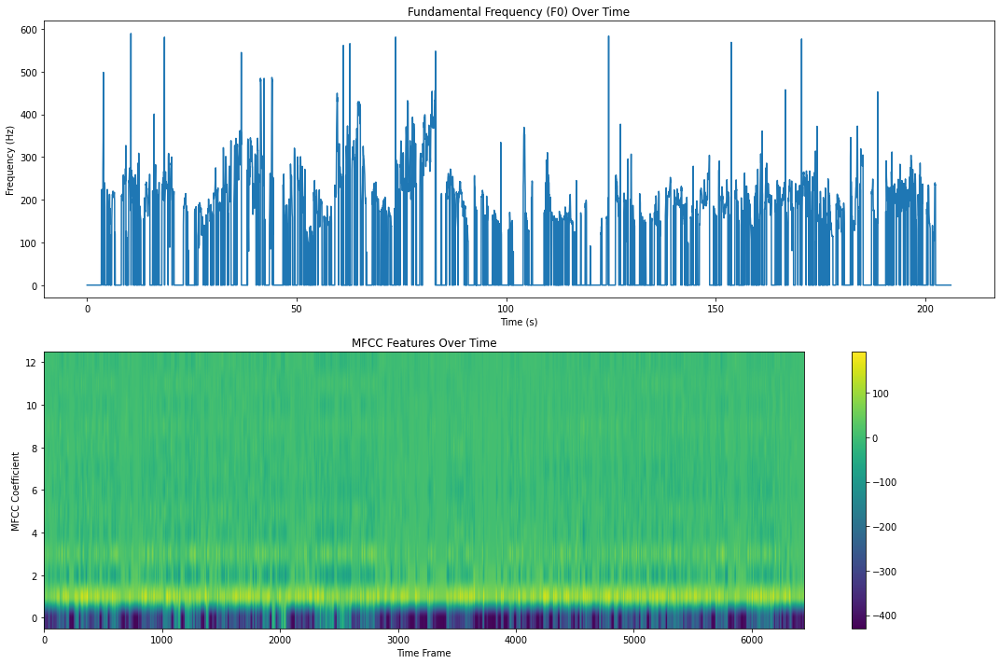

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_impro06_features.csv


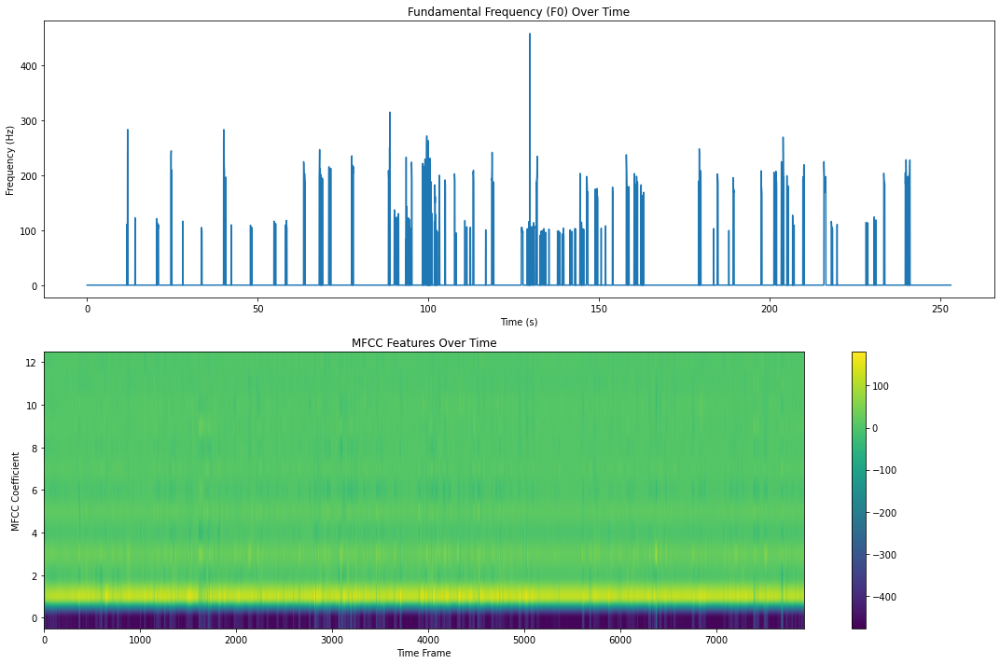

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_impro07_features.csv


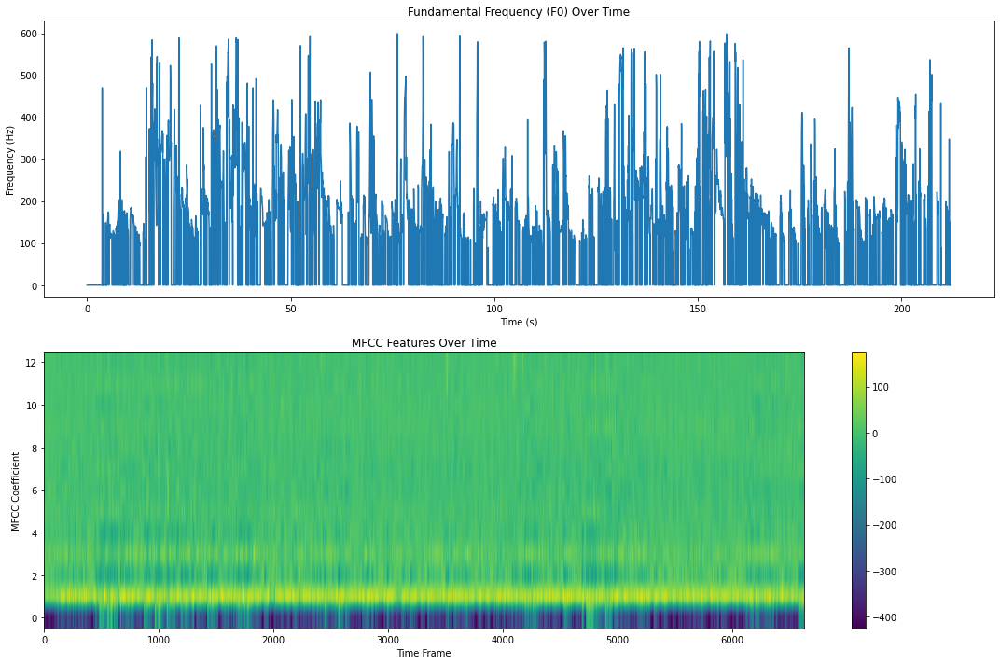

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_script01_1_features.csv


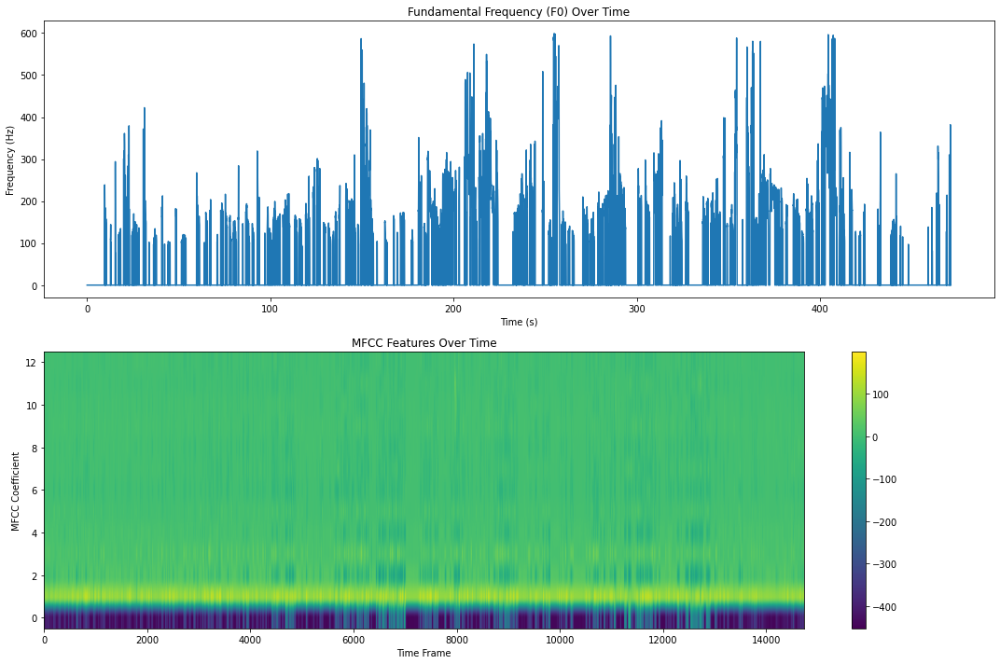

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_script01_2_features.csv


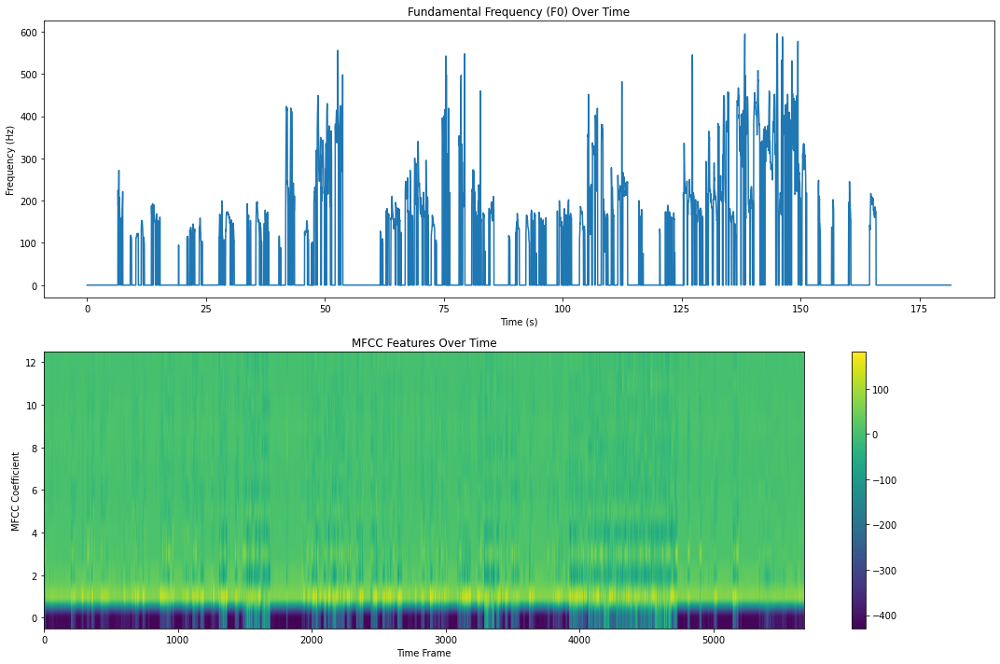

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_script01_3_features.csv


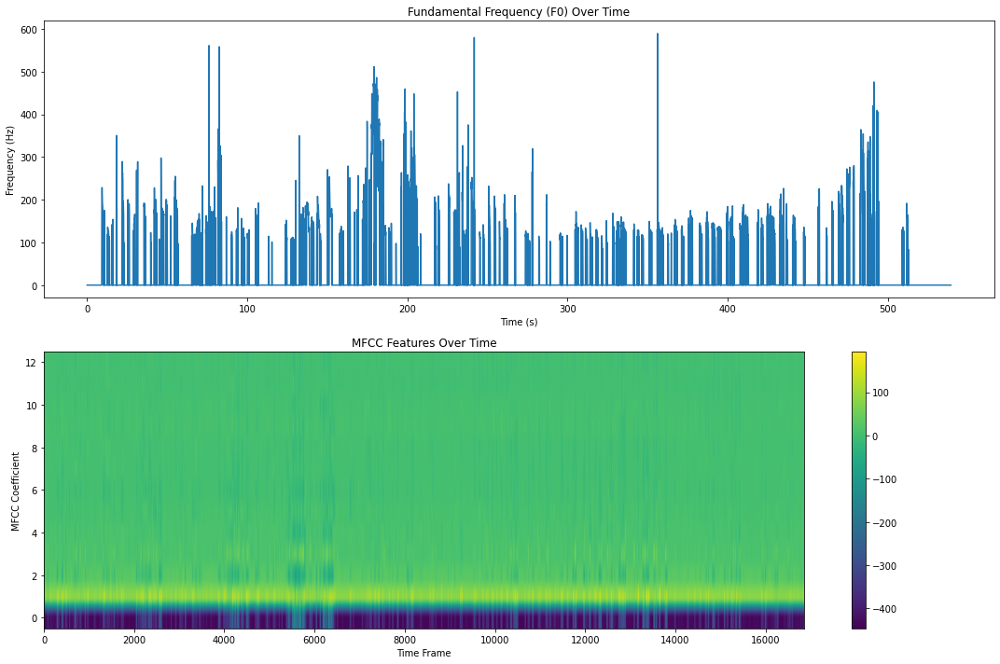

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_script02_1_features.csv


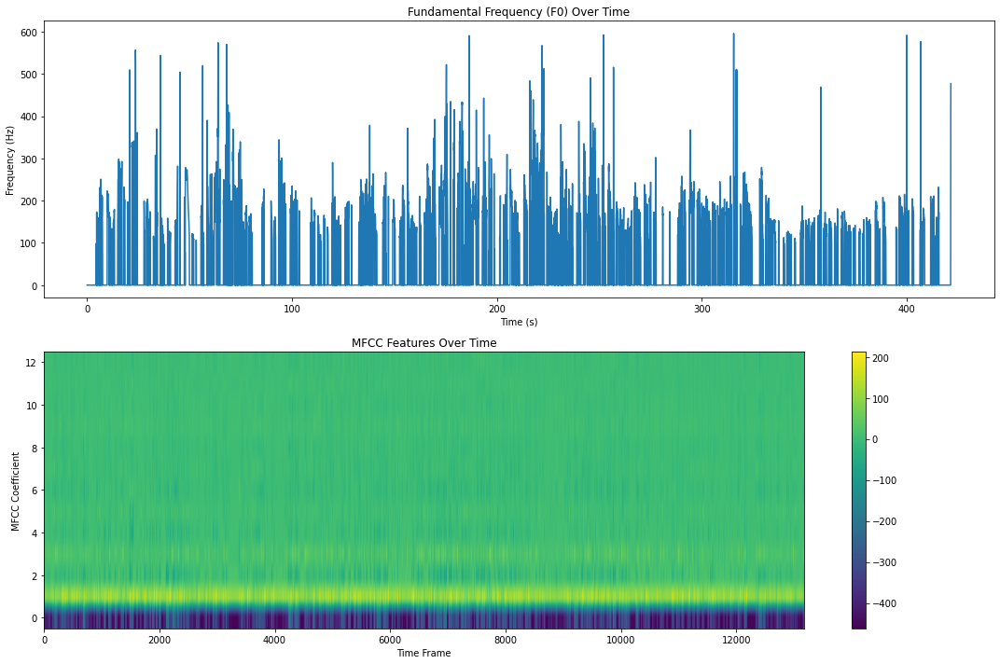

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_script02_2_features.csv


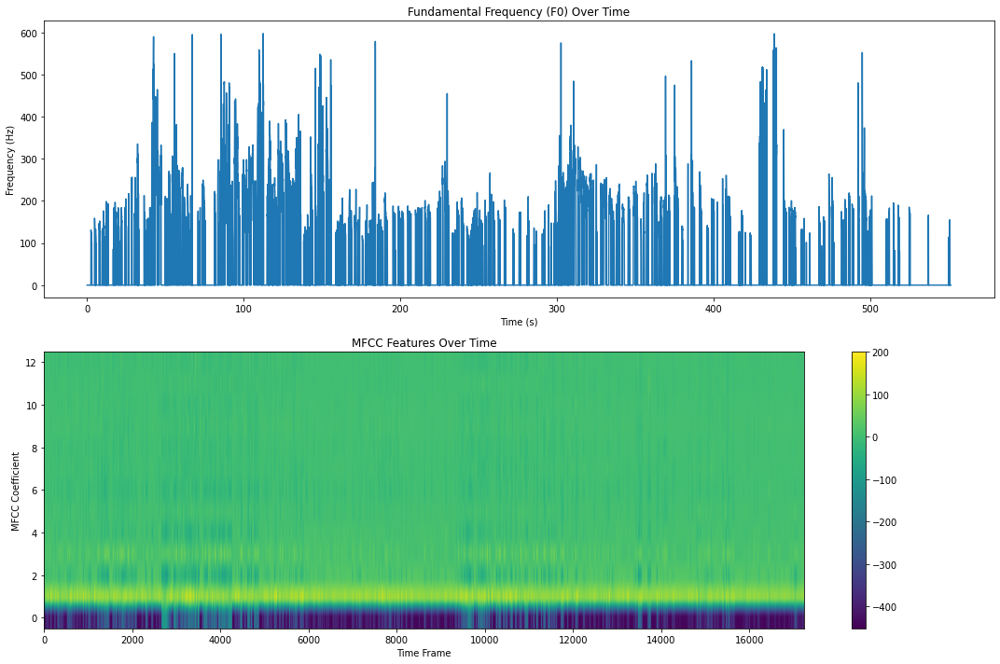

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_script03_1_features.csv


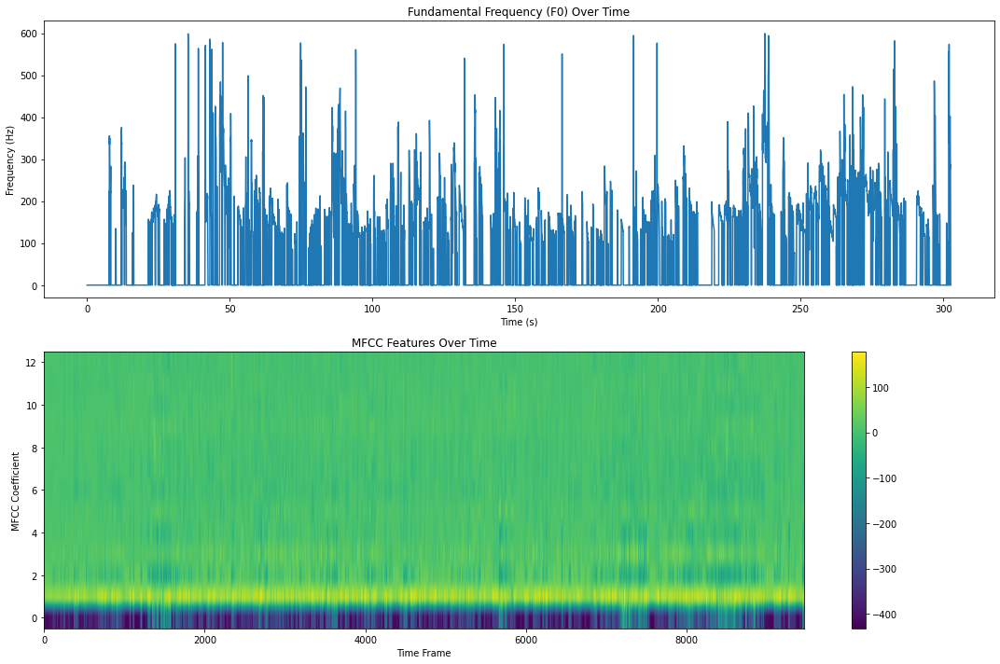

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses01M_script03_2_features.csv


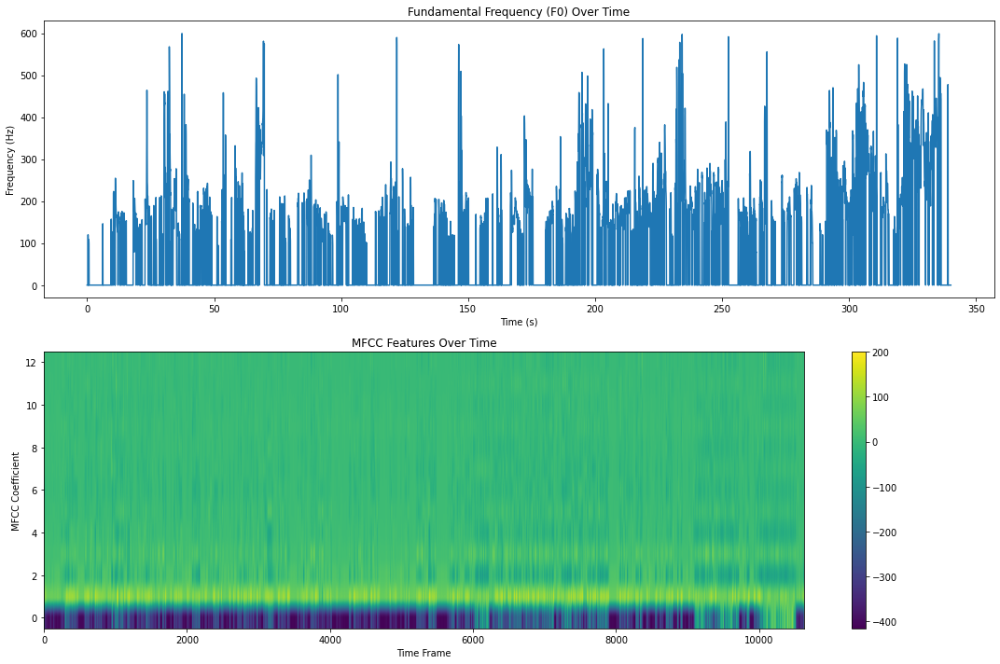

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro01_features.csv


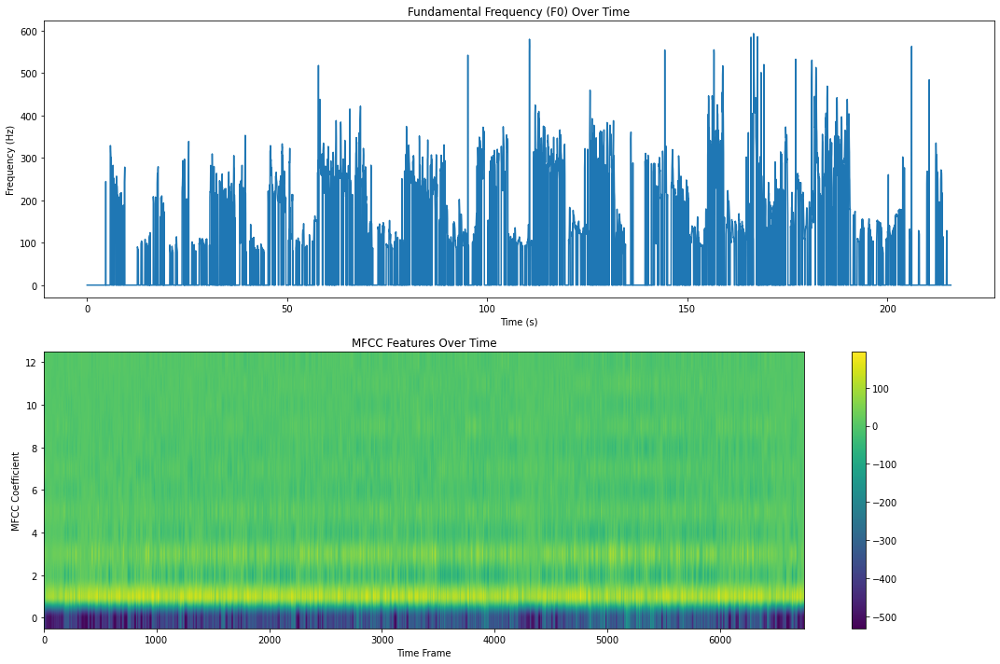

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro02_features.csv


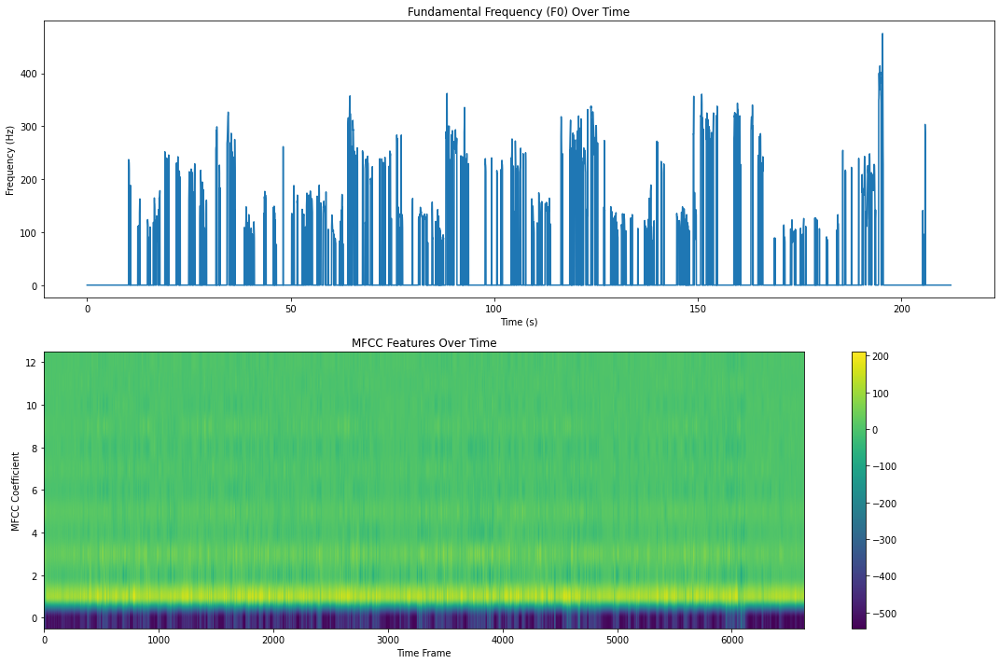

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro03_features.csv


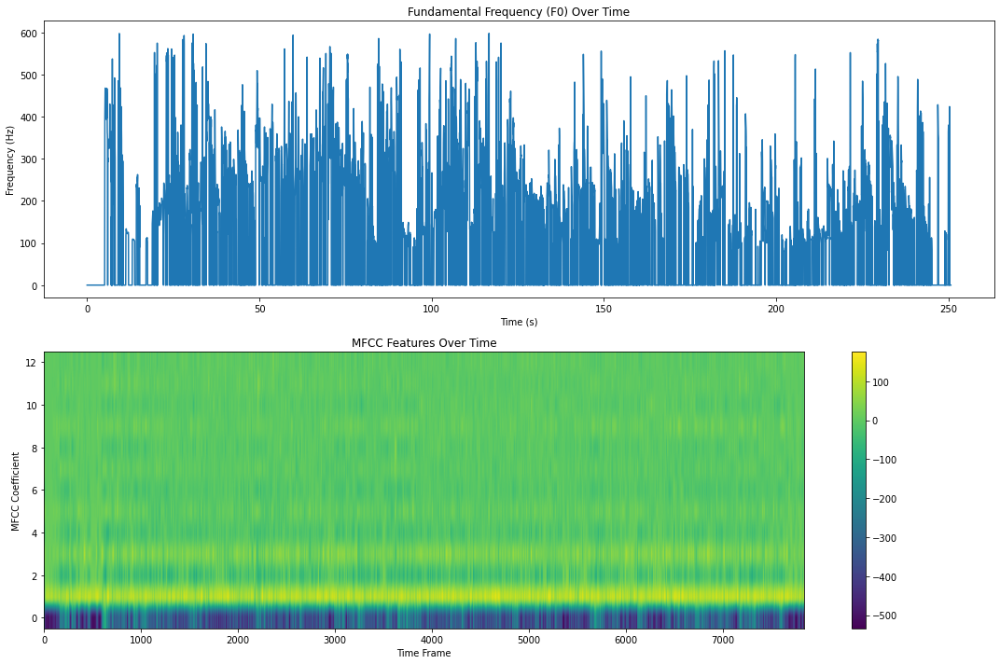

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro04_features.csv


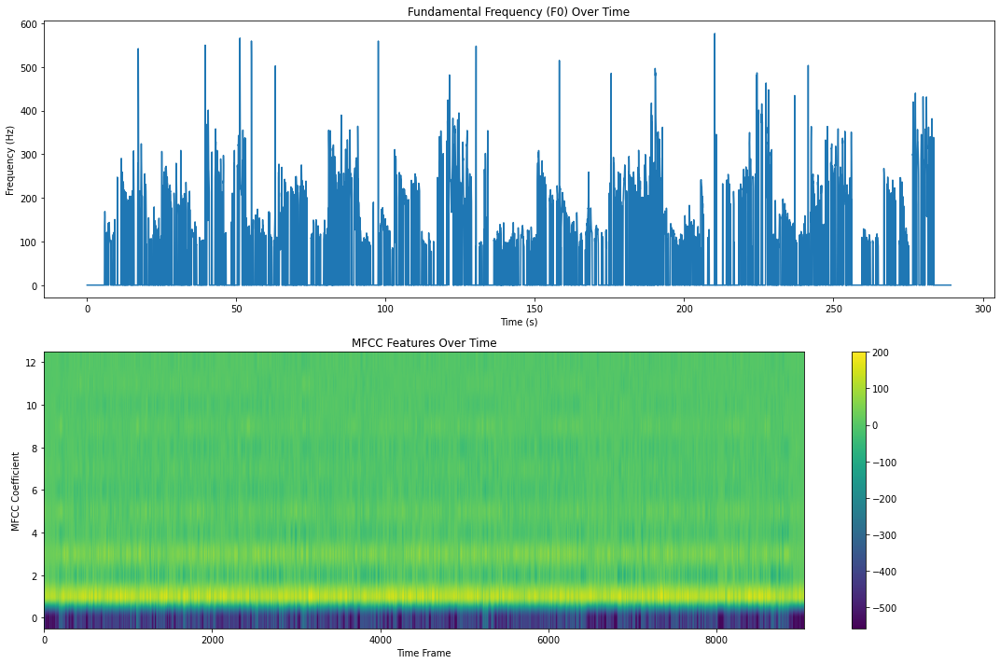

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro05_features.csv


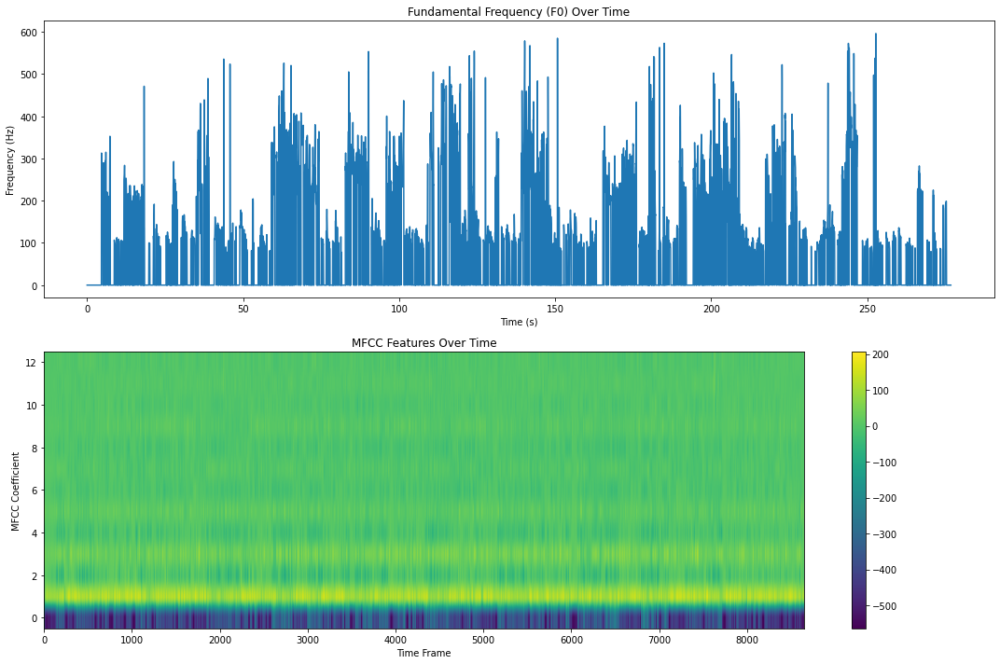

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro06_features.csv


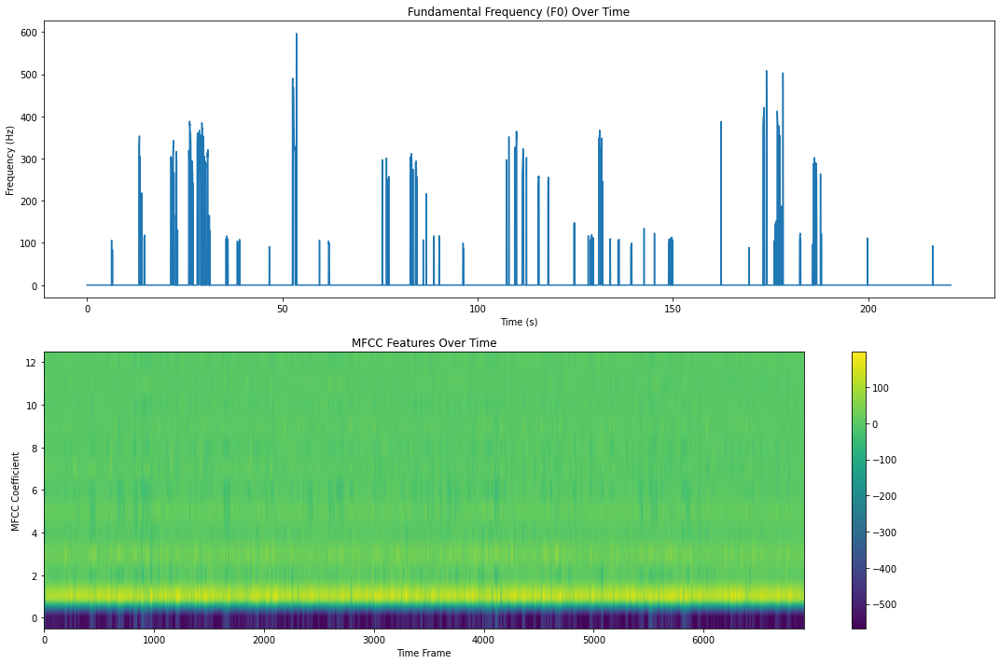

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro07_features.csv


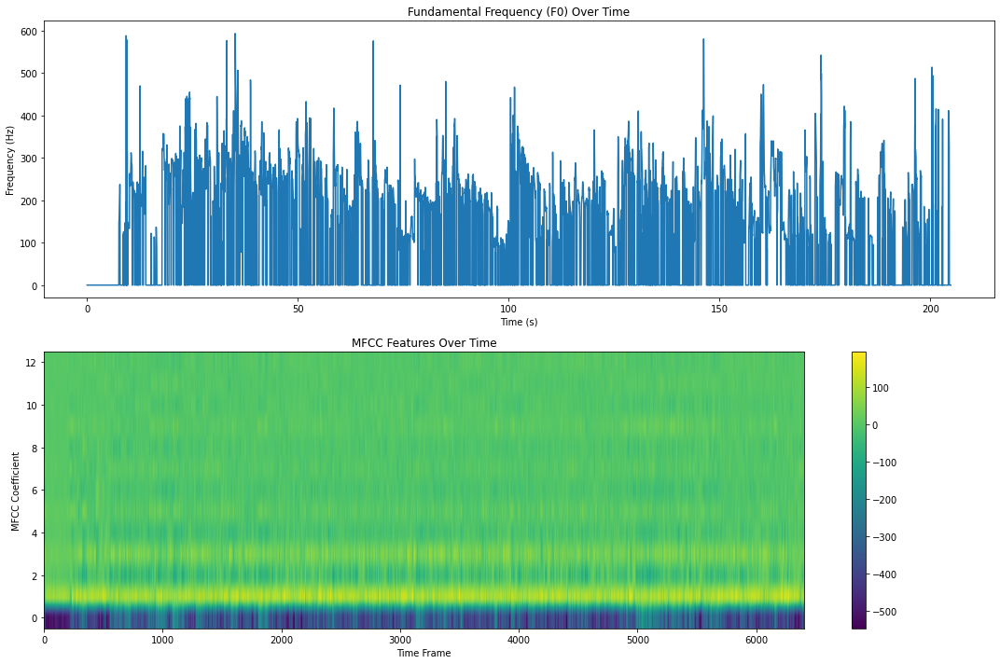

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_impro08_features.csv


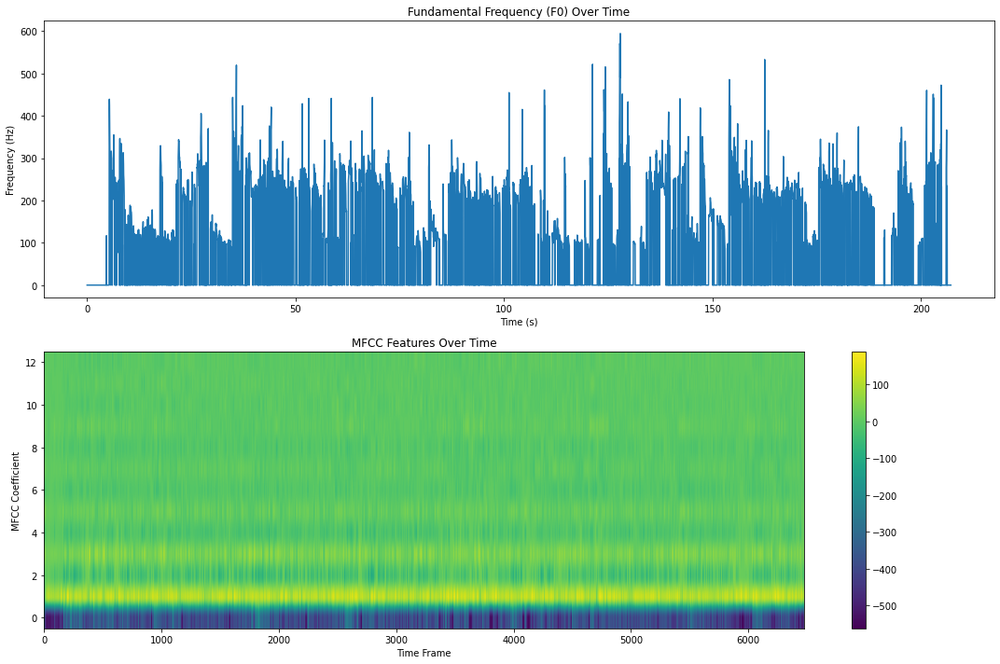

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_script01_1_features.csv


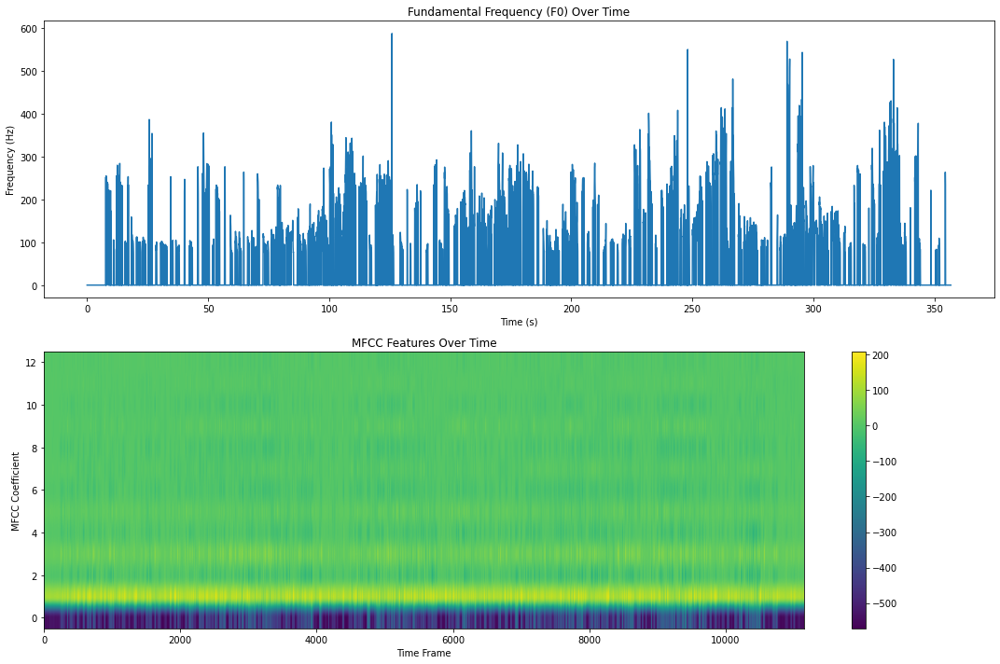

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_script01_2_features.csv


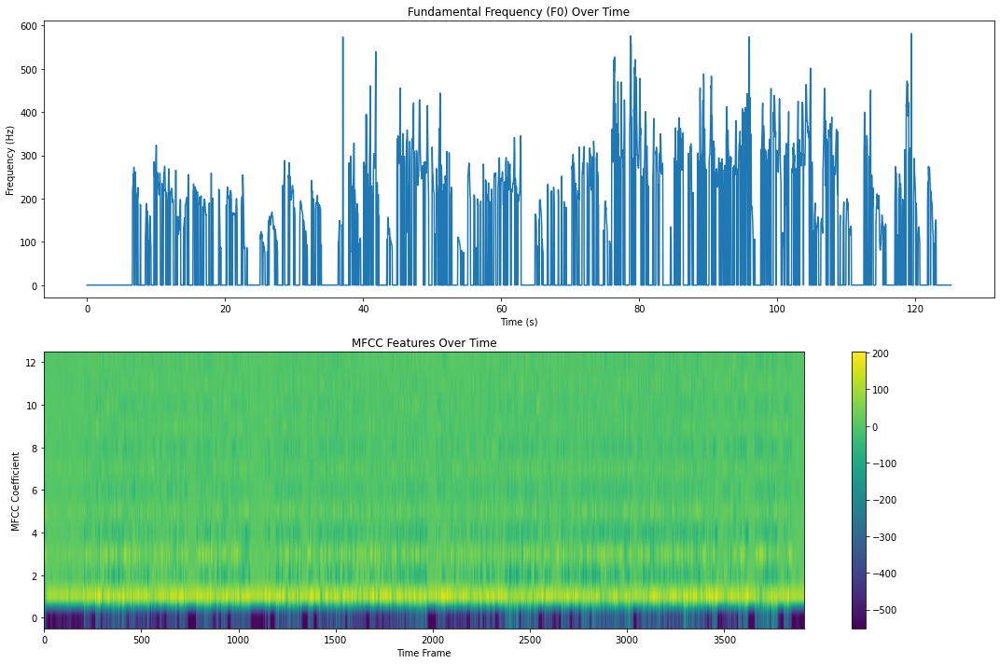

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_script01_3_features.csv


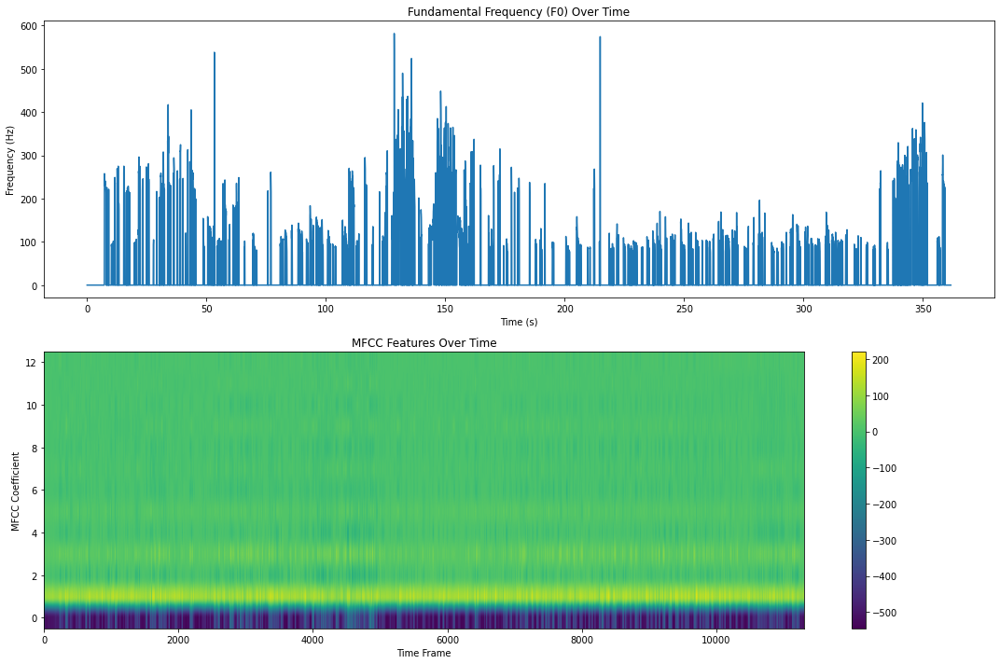

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_script02_1_features.csv


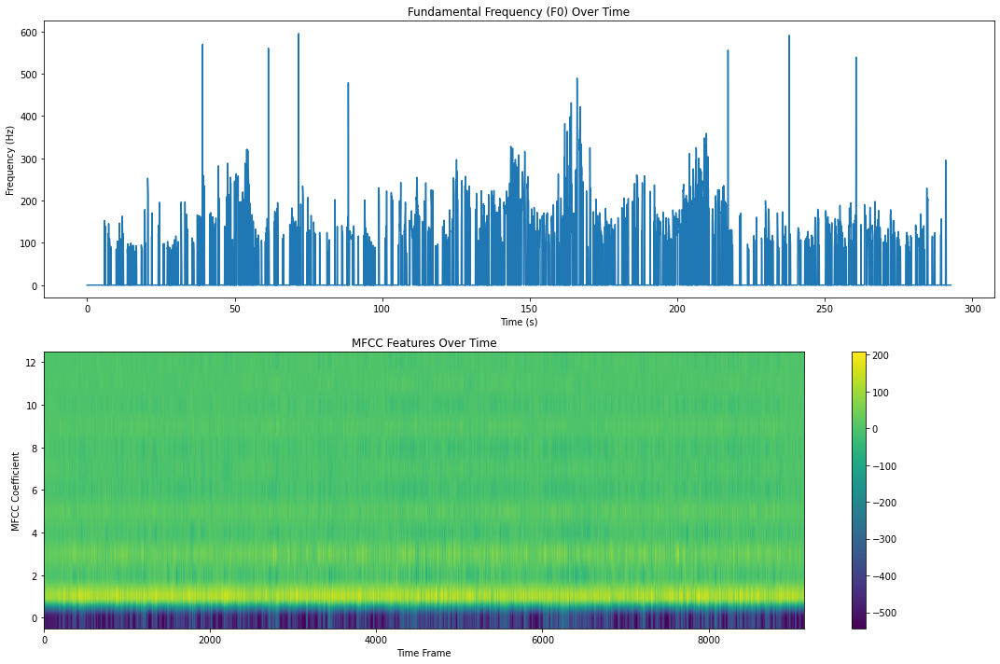

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_script02_2_features.csv


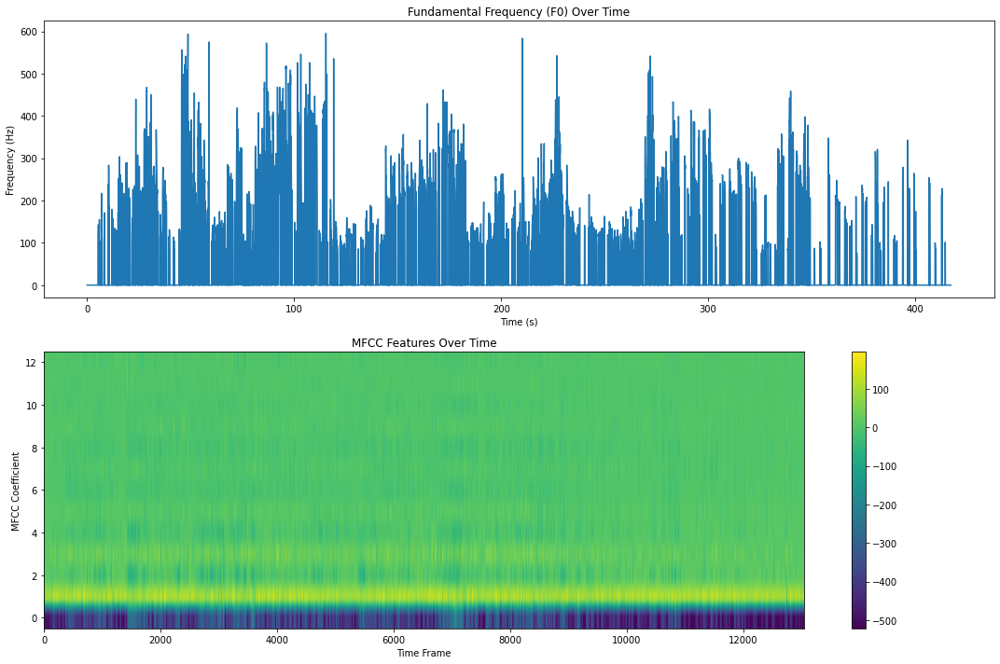

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_script03_1_features.csv


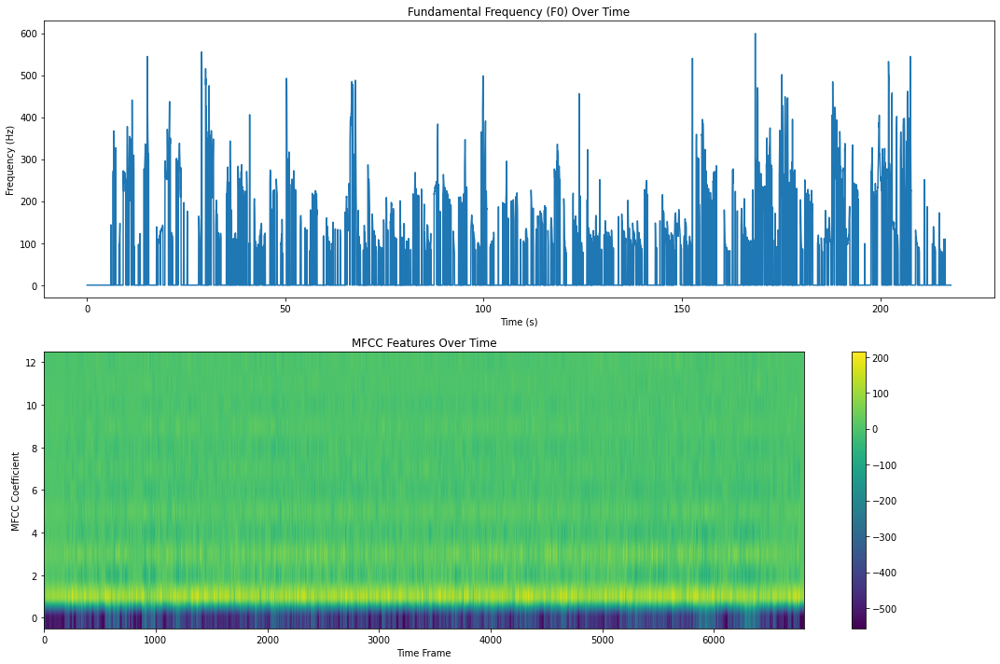

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02F_script03_2_features.csv


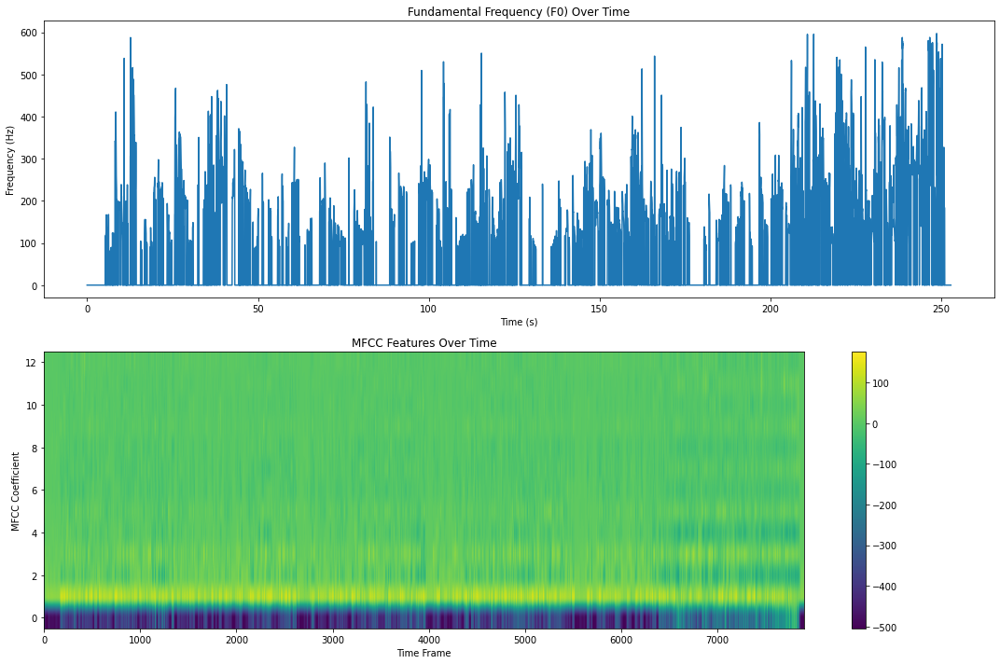

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro01_features.csv


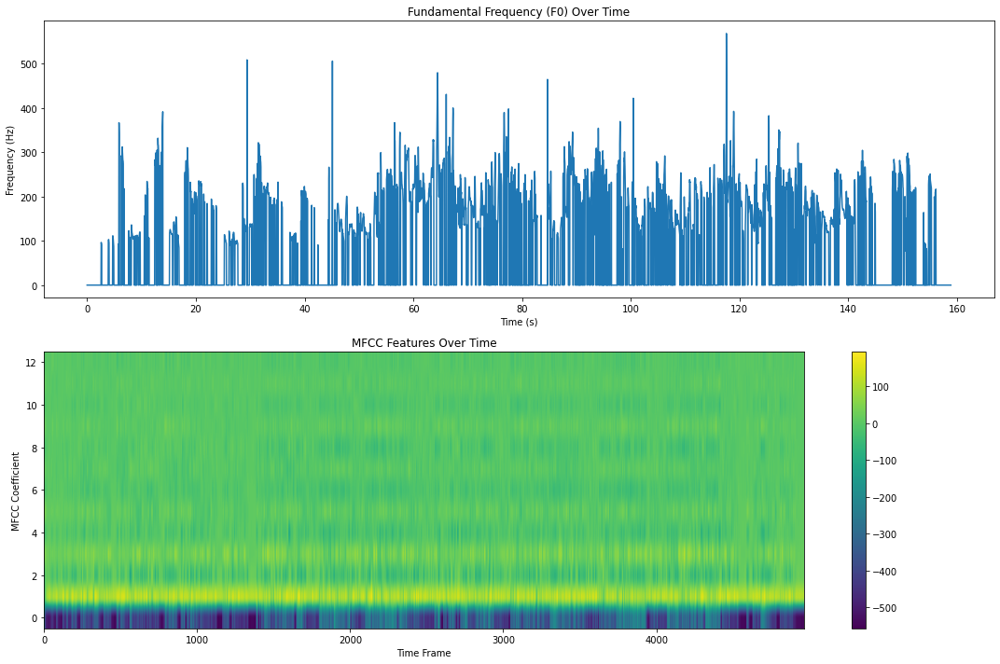

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro02_features.csv


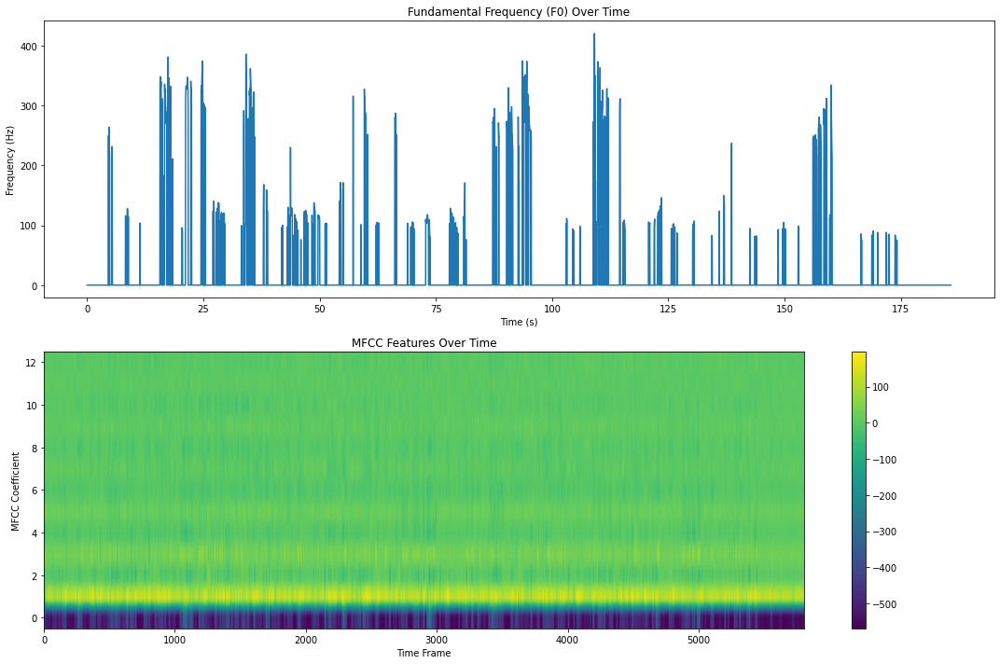

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro03_features.csv


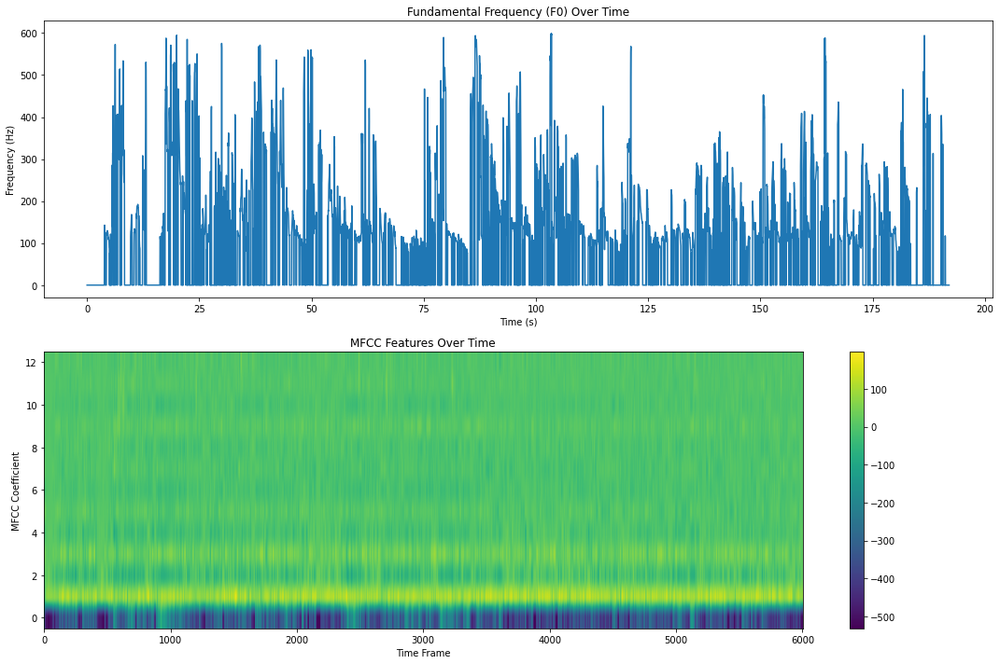

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro04_features.csv


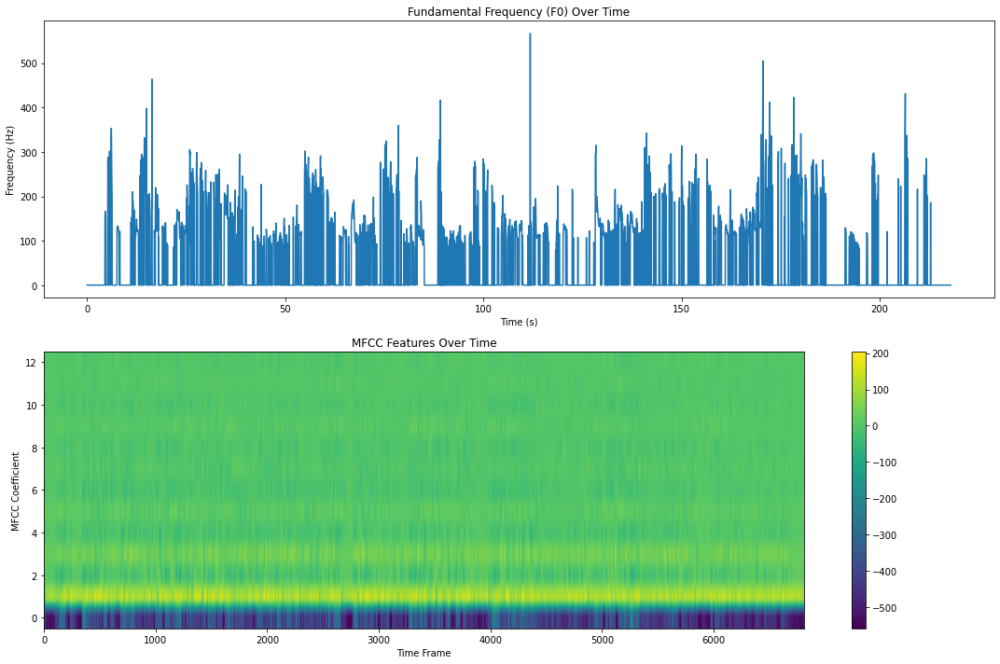

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro05_features.csv


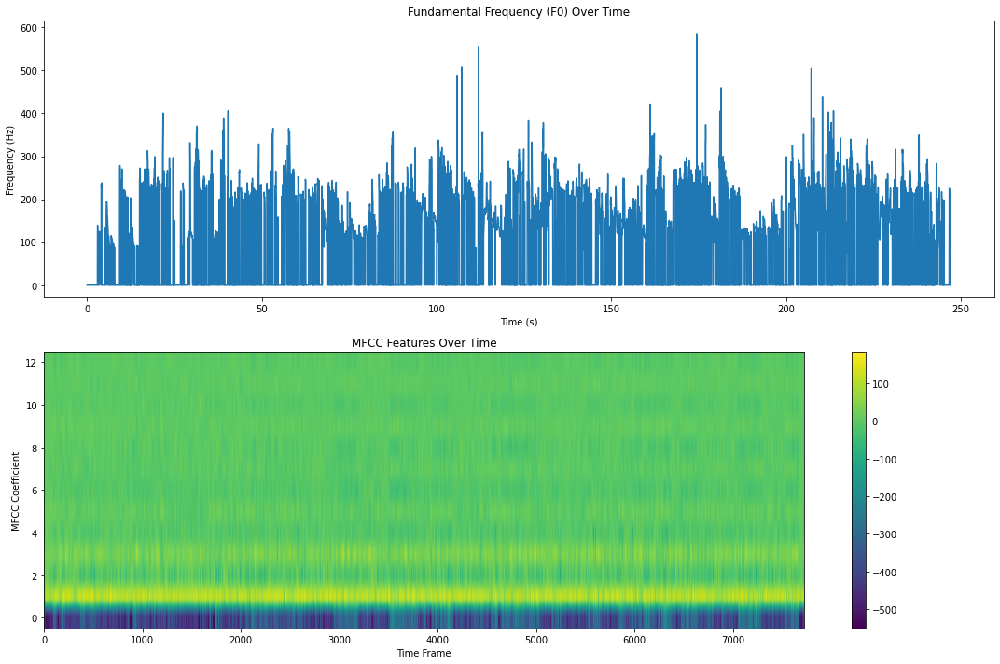

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro06_features.csv


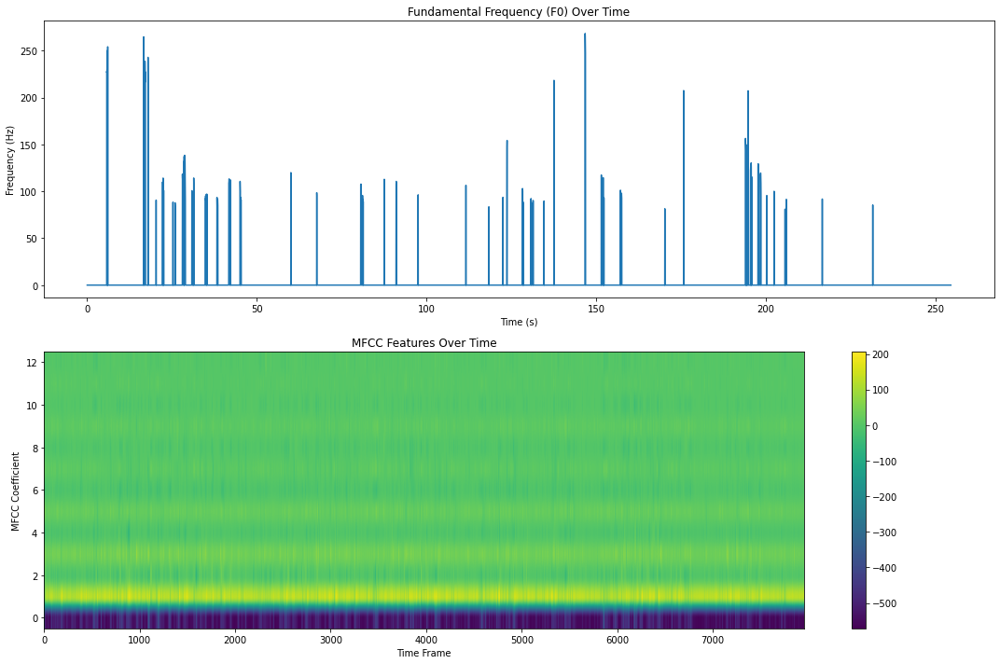

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro07_features.csv


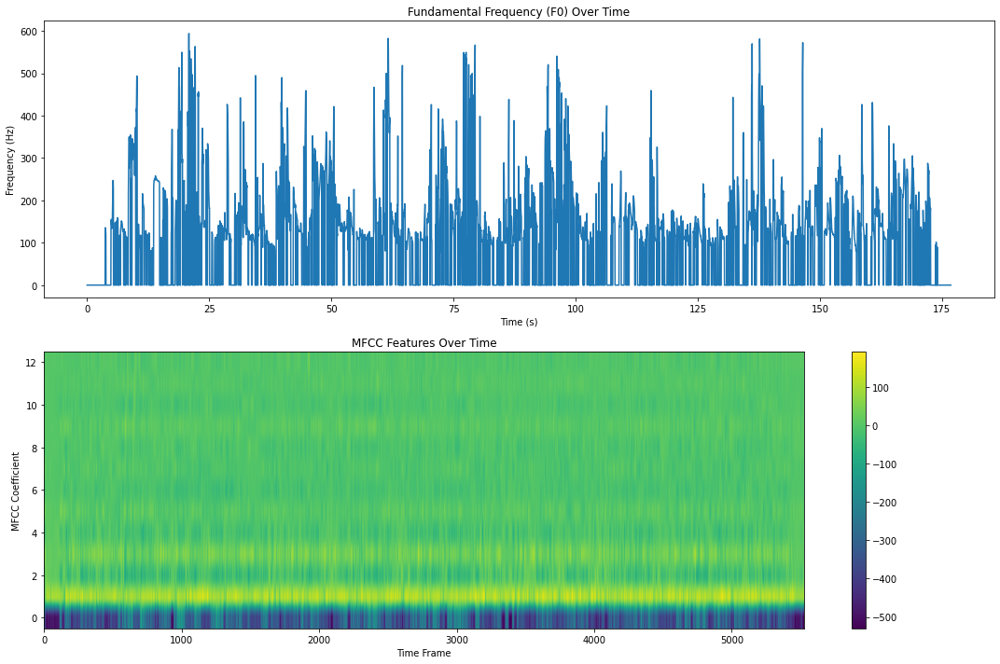

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_impro08_features.csv


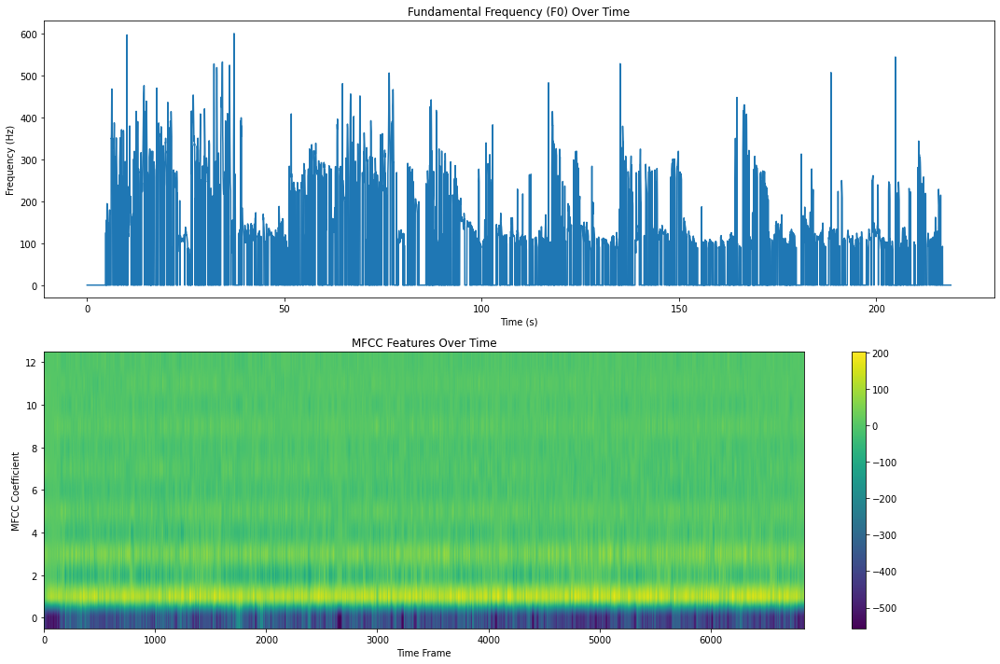

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_script01_1_features.csv


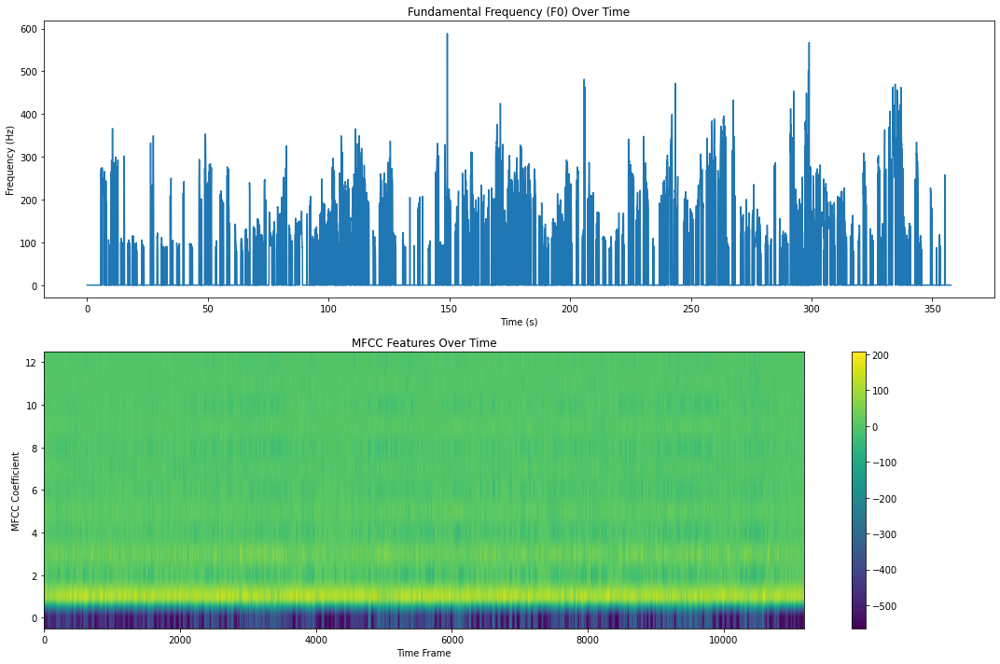

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_script01_2_features.csv


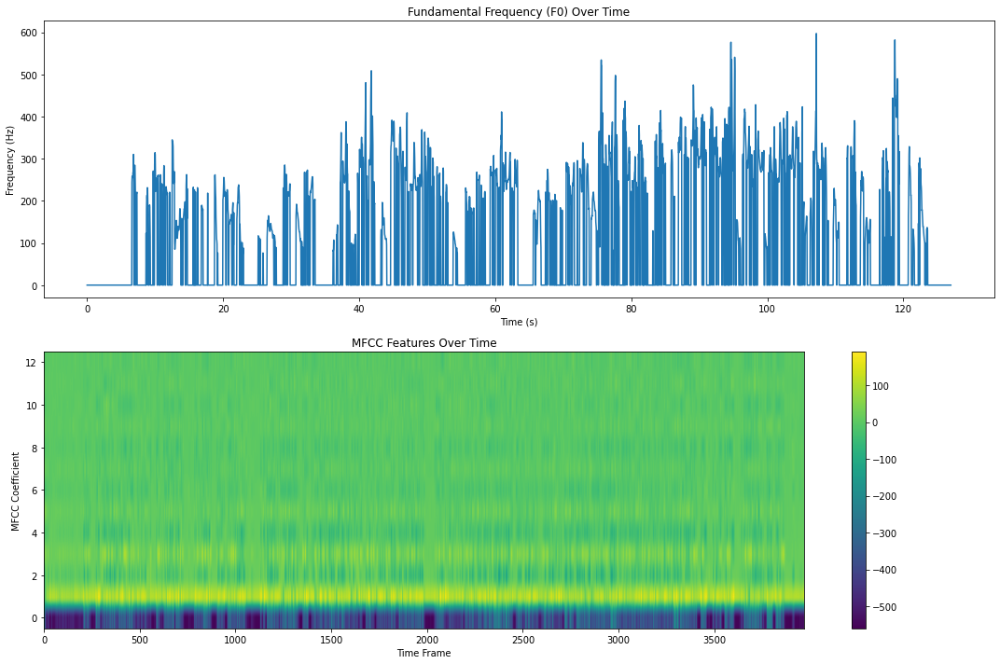

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_script01_3_features.csv


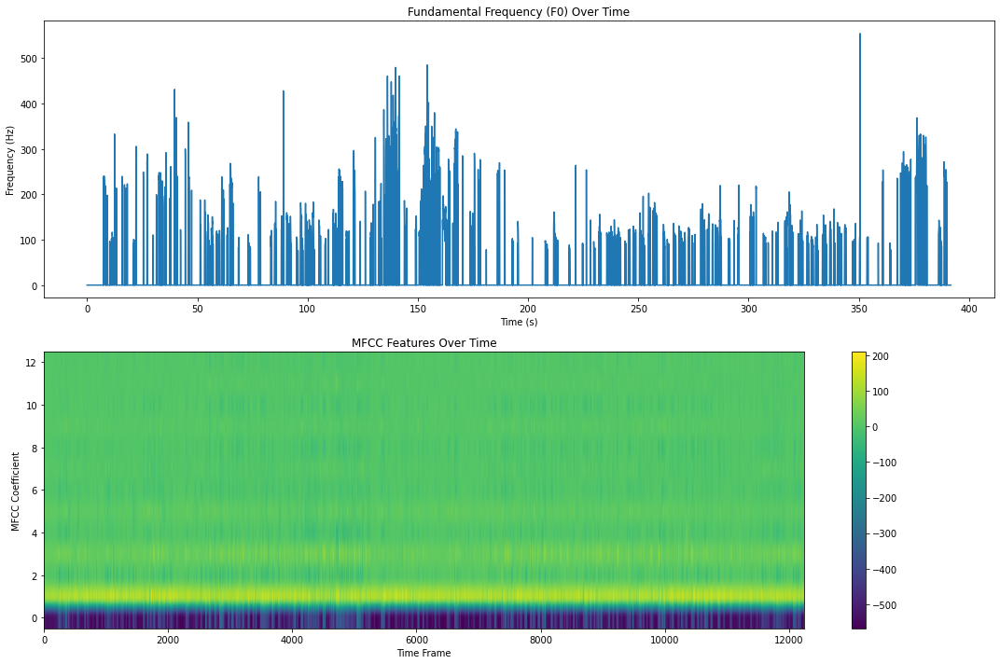

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_script02_1_features.csv


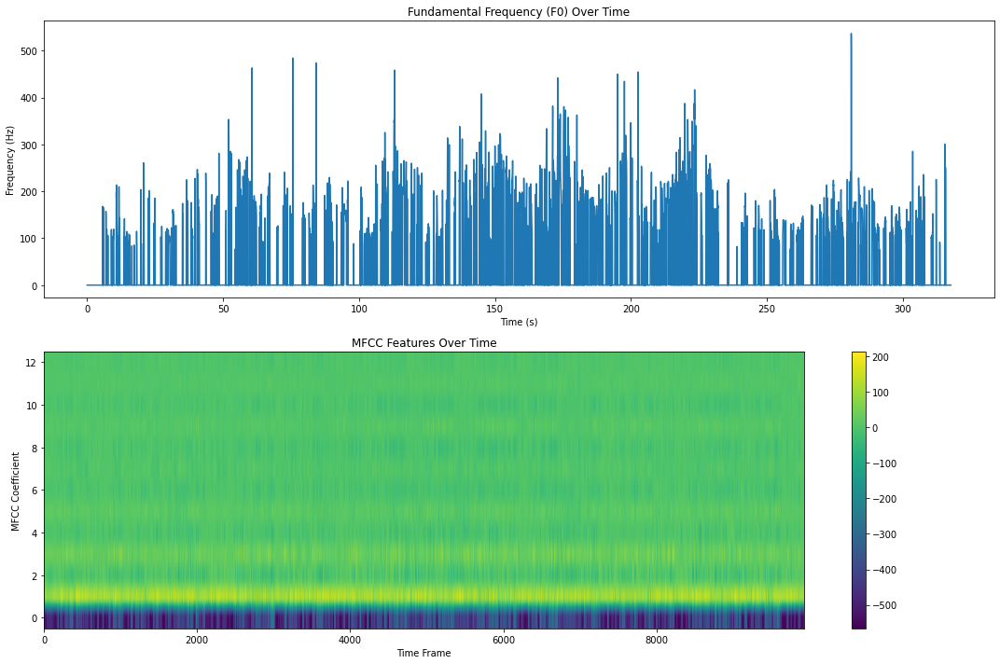

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_script02_2_features.csv


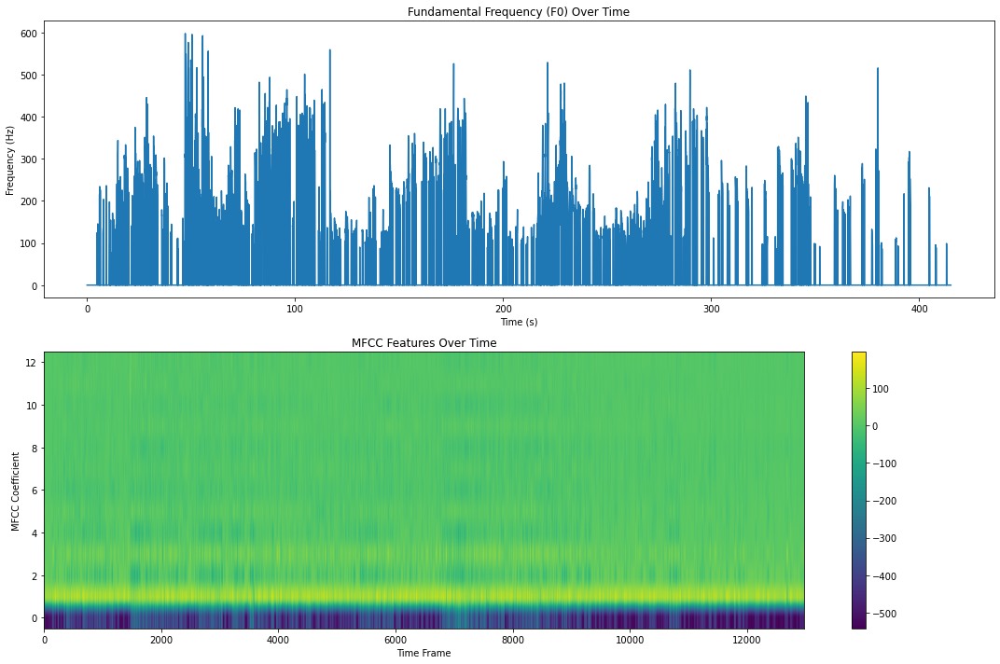

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_script03_1_features.csv


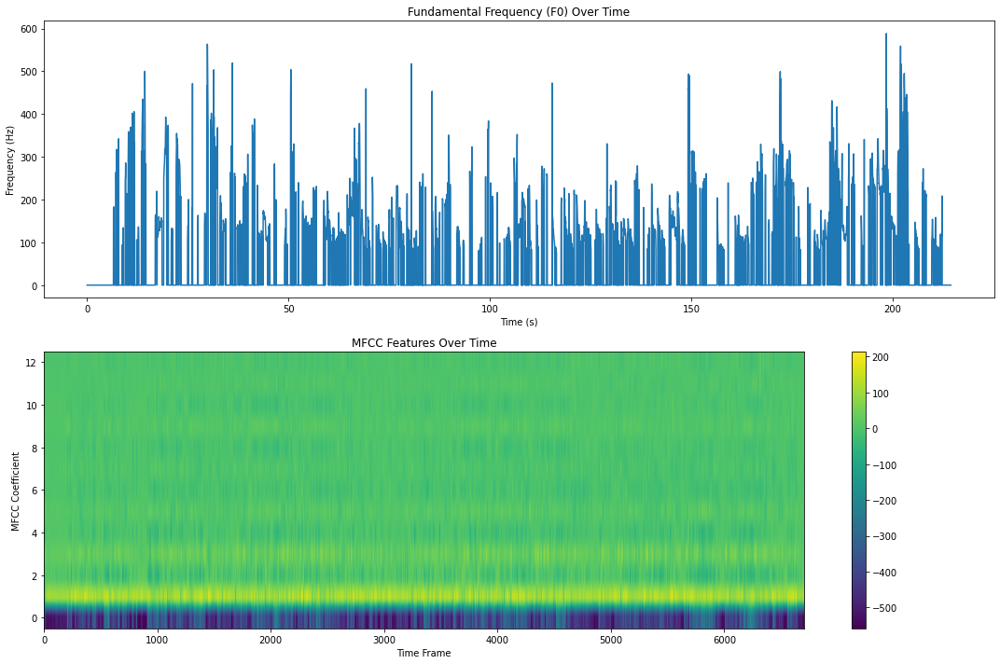

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses02M_script03_2_features.csv


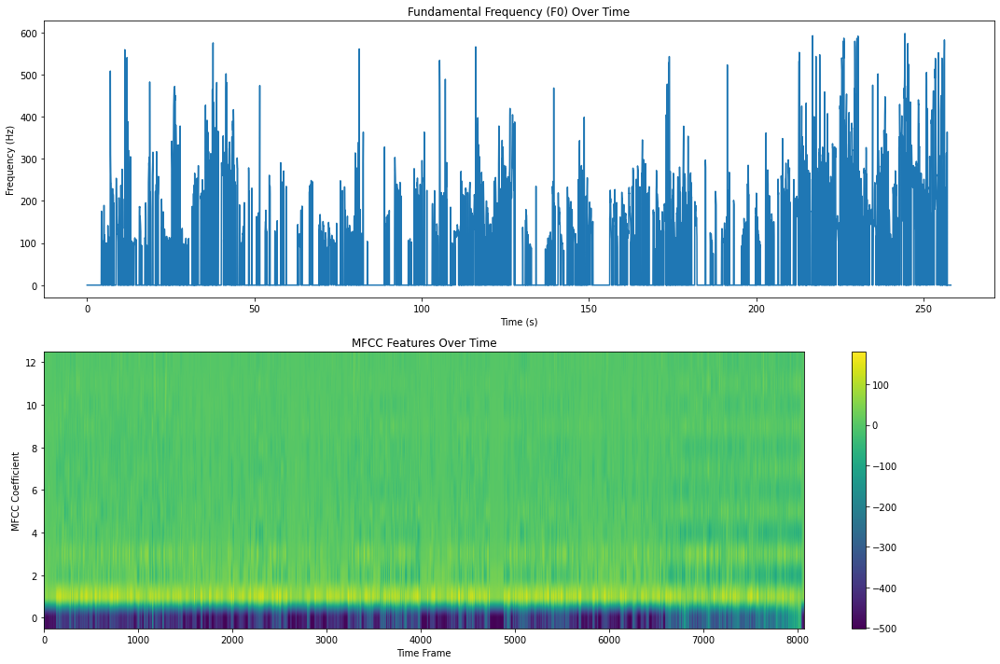

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro01_features.csv


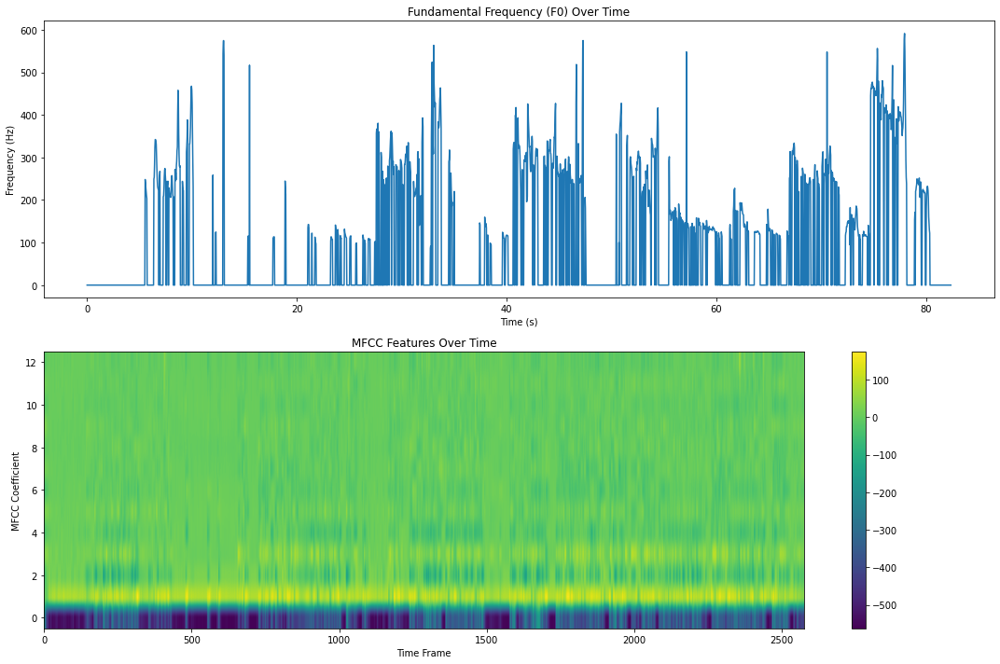

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro02_features.csv


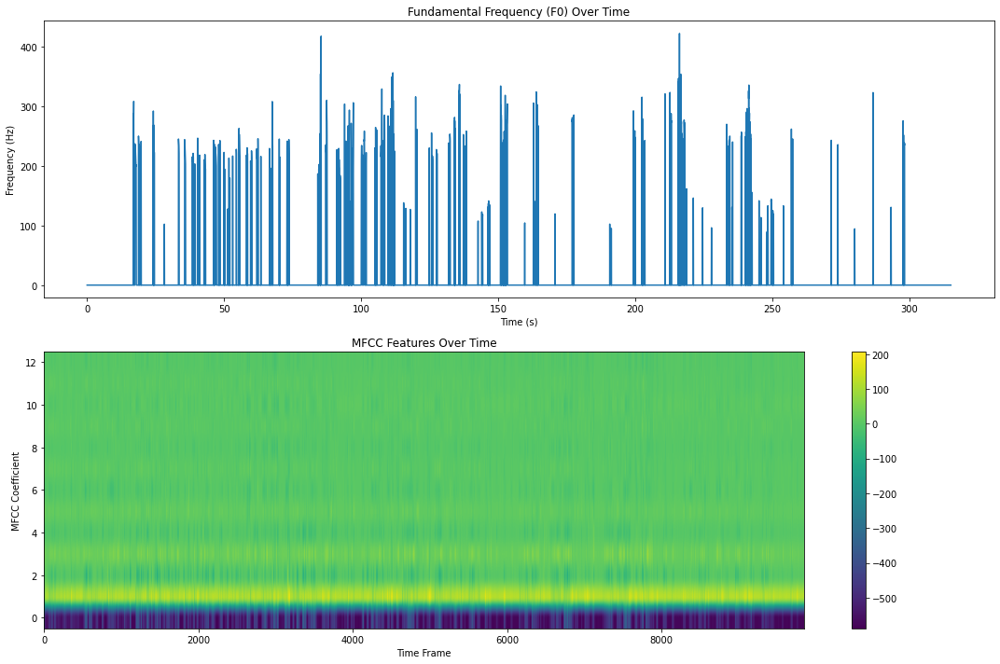

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro03_features.csv


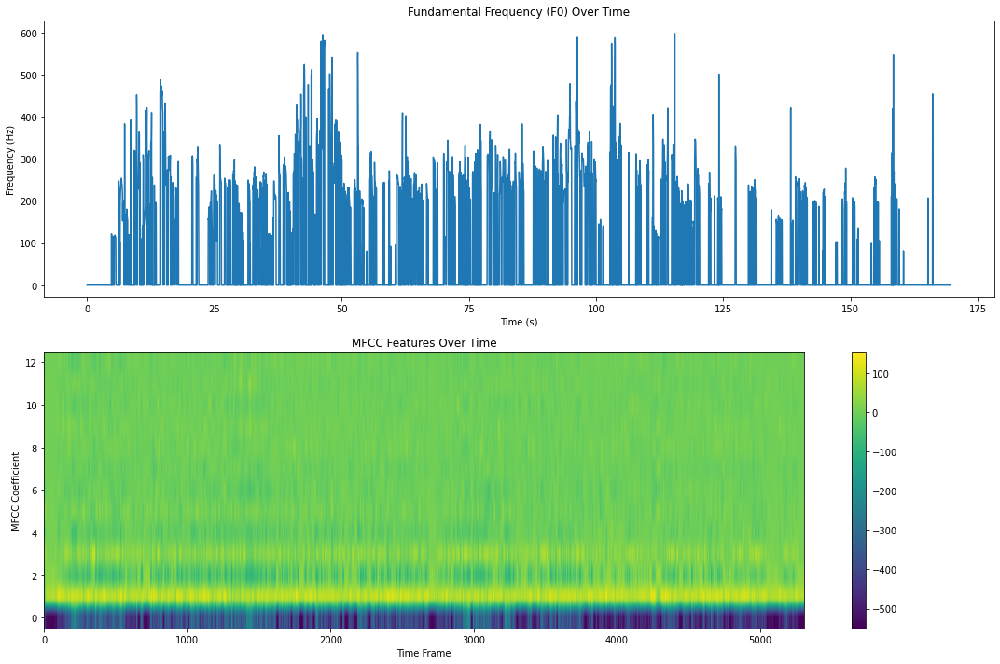

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro04_features.csv


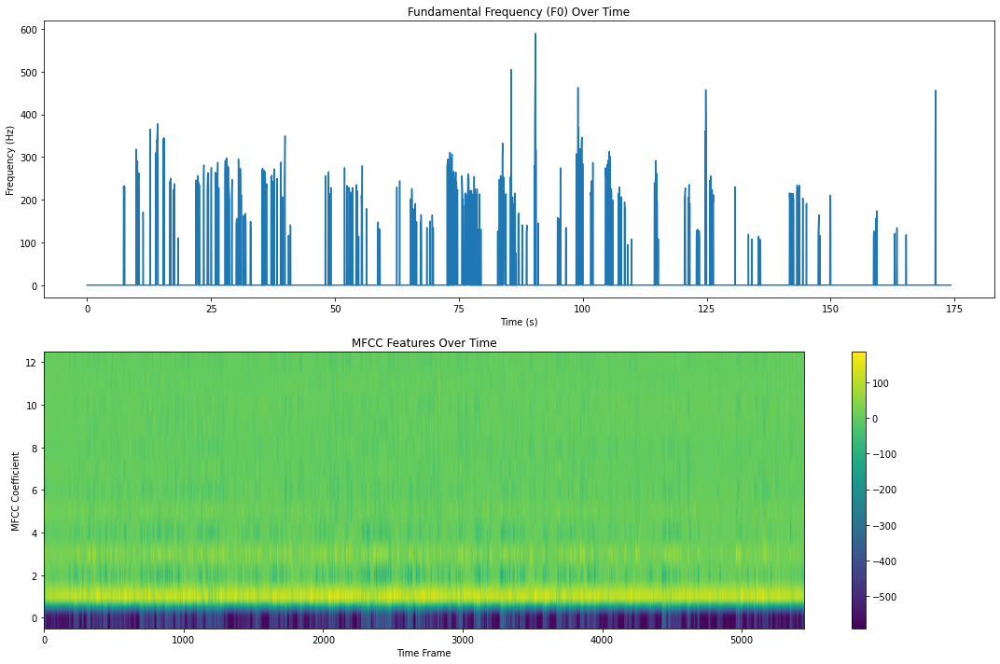

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro05_features.csv


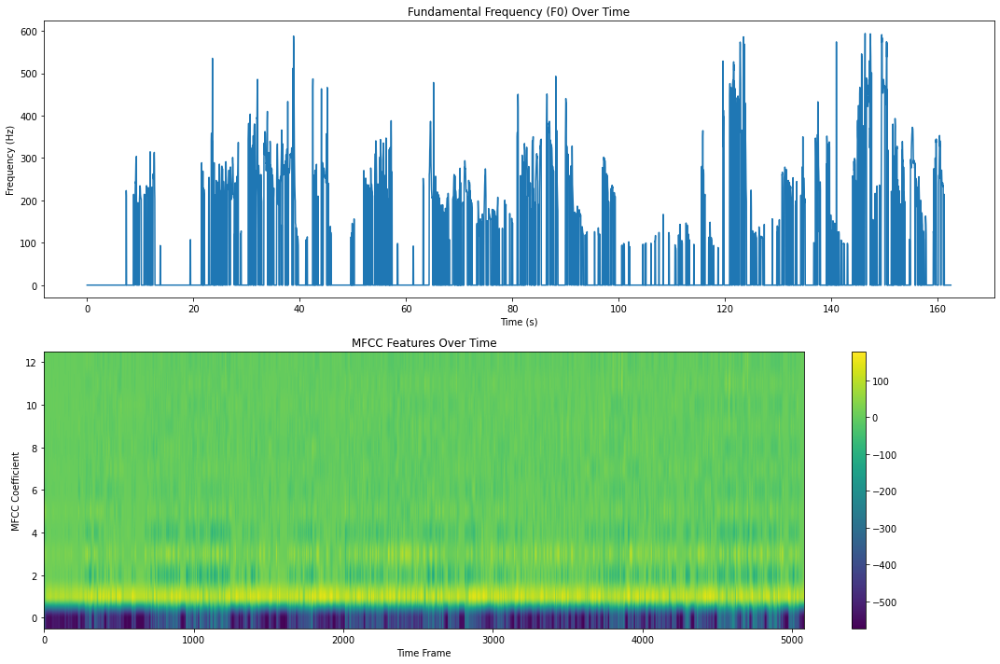

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro06_features.csv


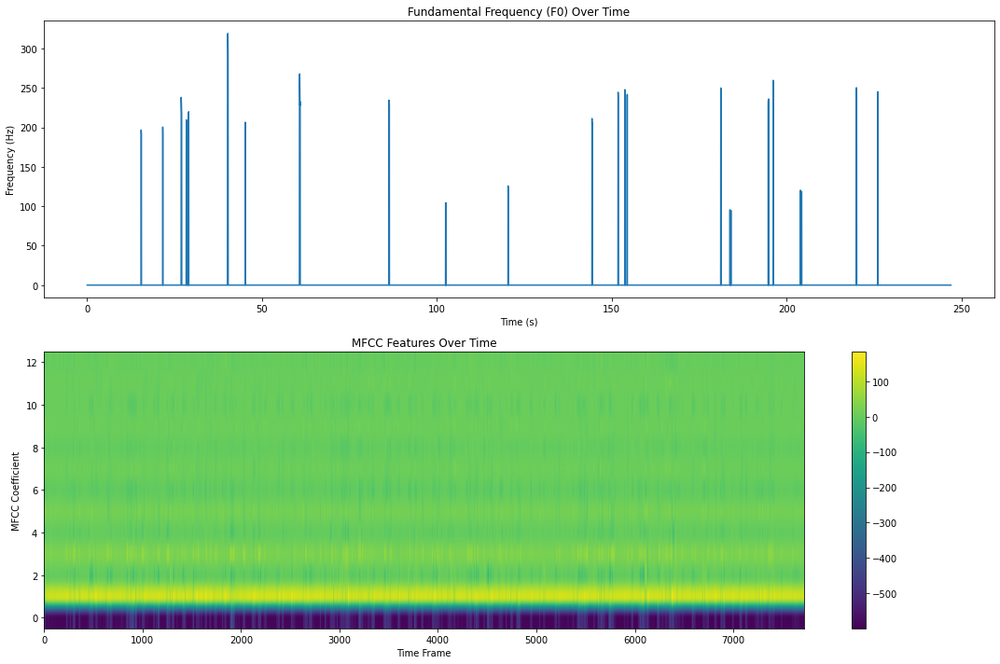

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro07_features.csv


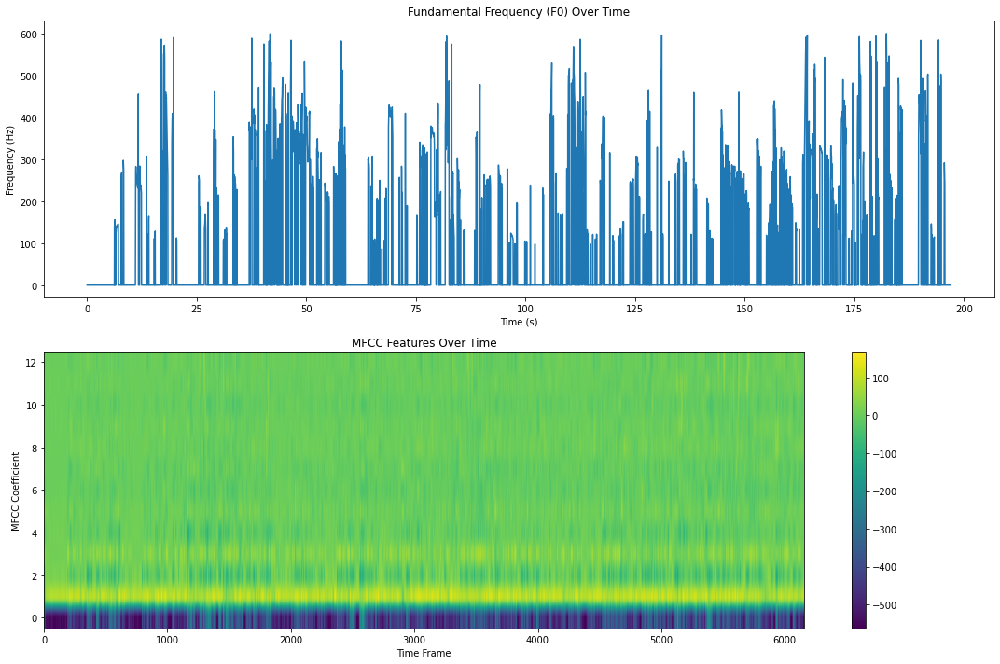

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_impro08_features.csv


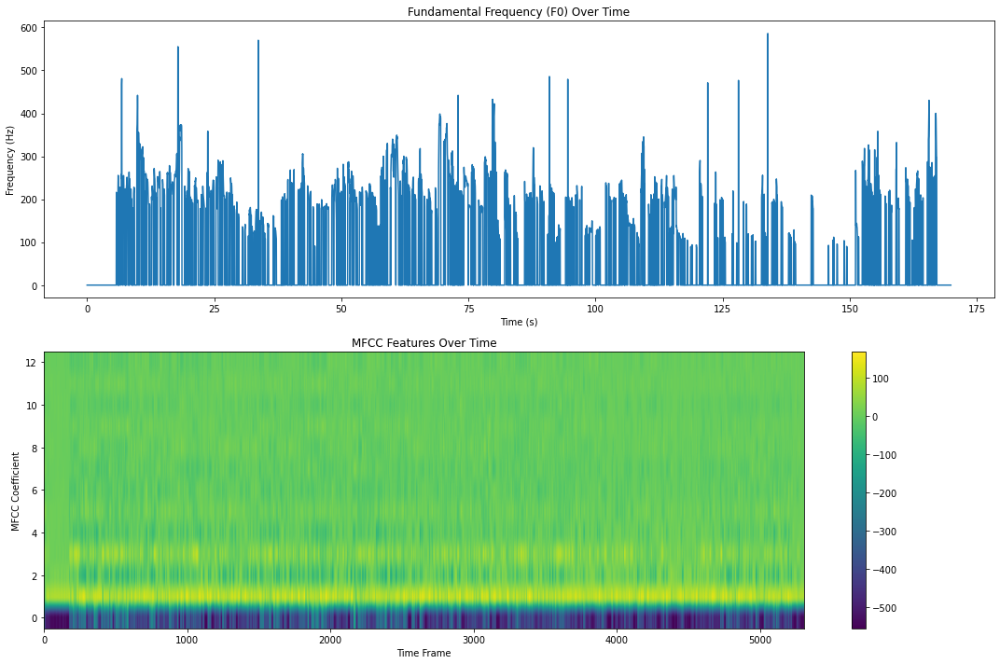

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_script01_1_features.csv


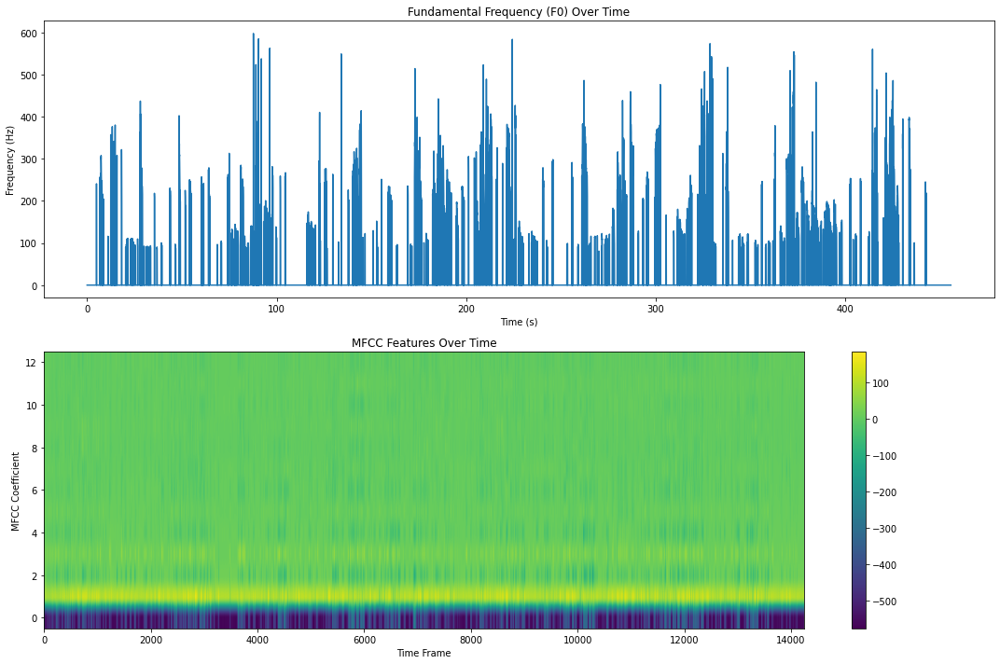

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_script01_2_features.csv


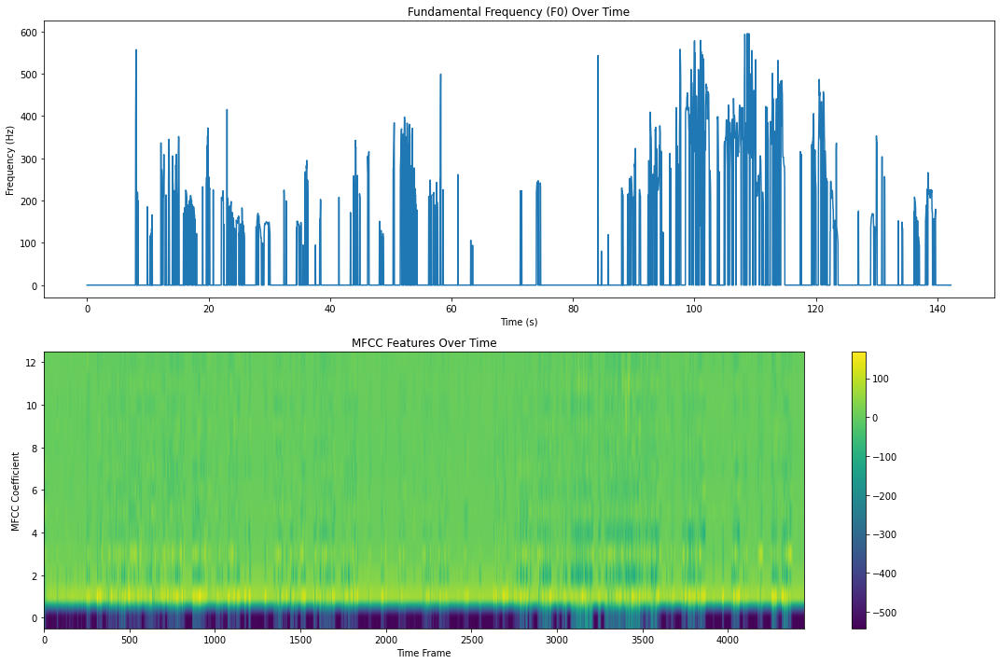

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_script01_3_features.csv


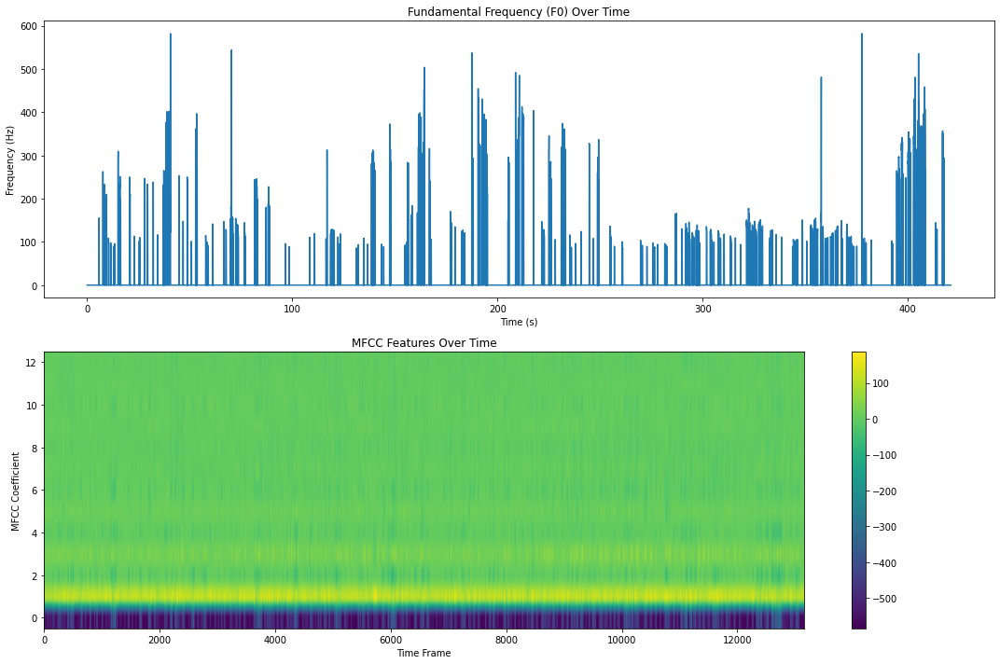

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_script02_1_features.csv


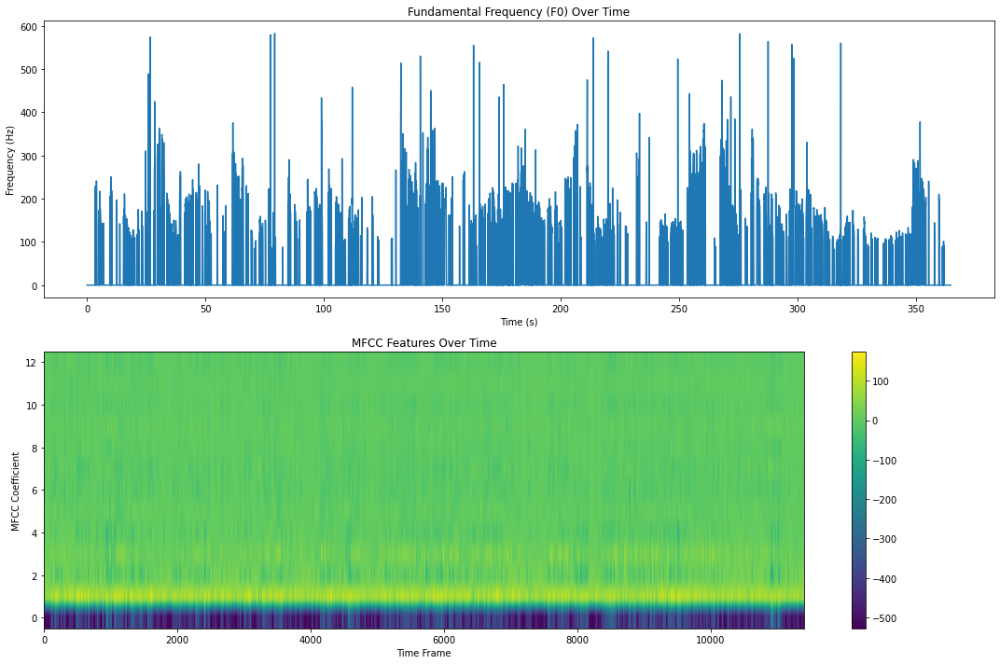

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_script02_2_features.csv


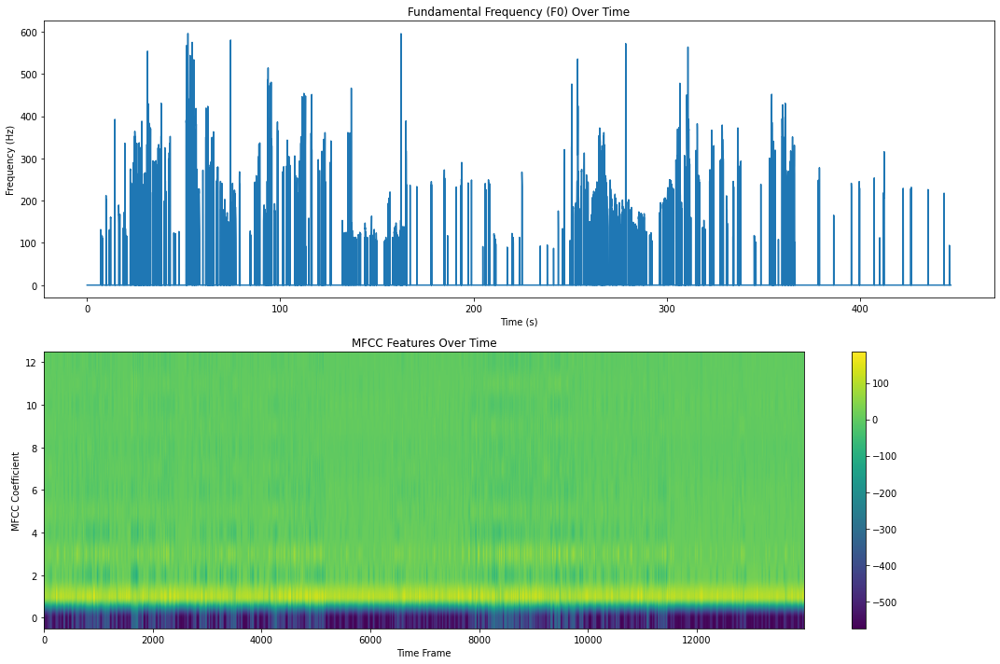

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_script03_1_features.csv


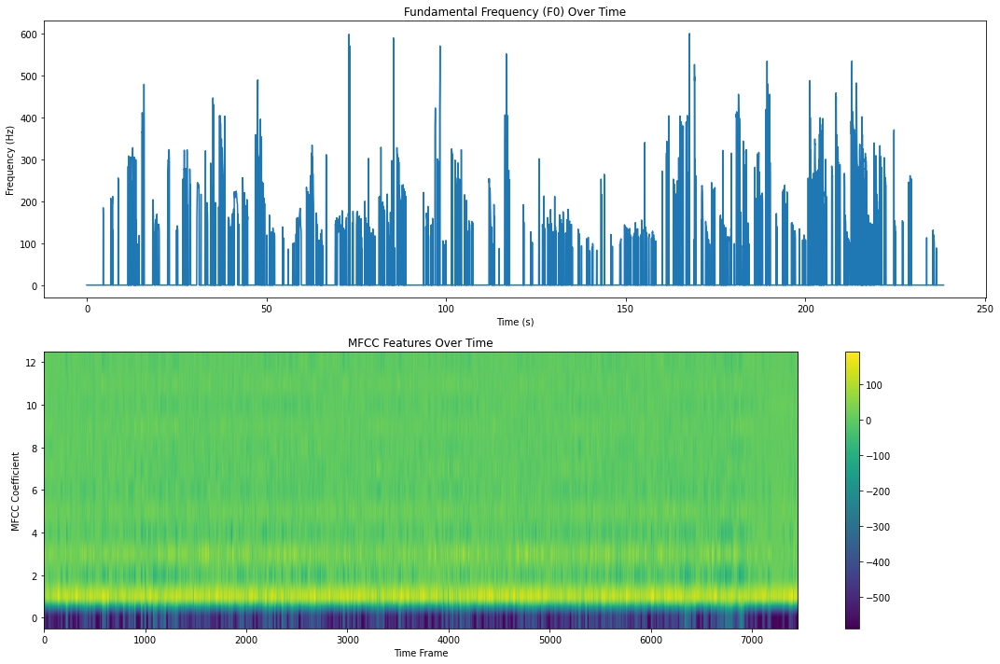

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03F_script03_2_features.csv


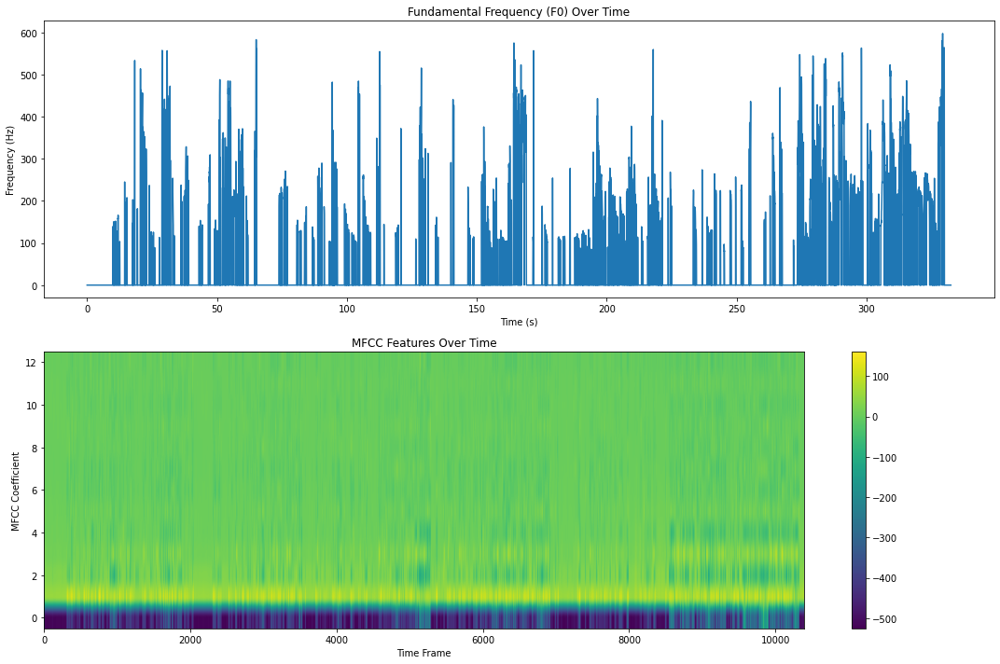

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro01_features.csv


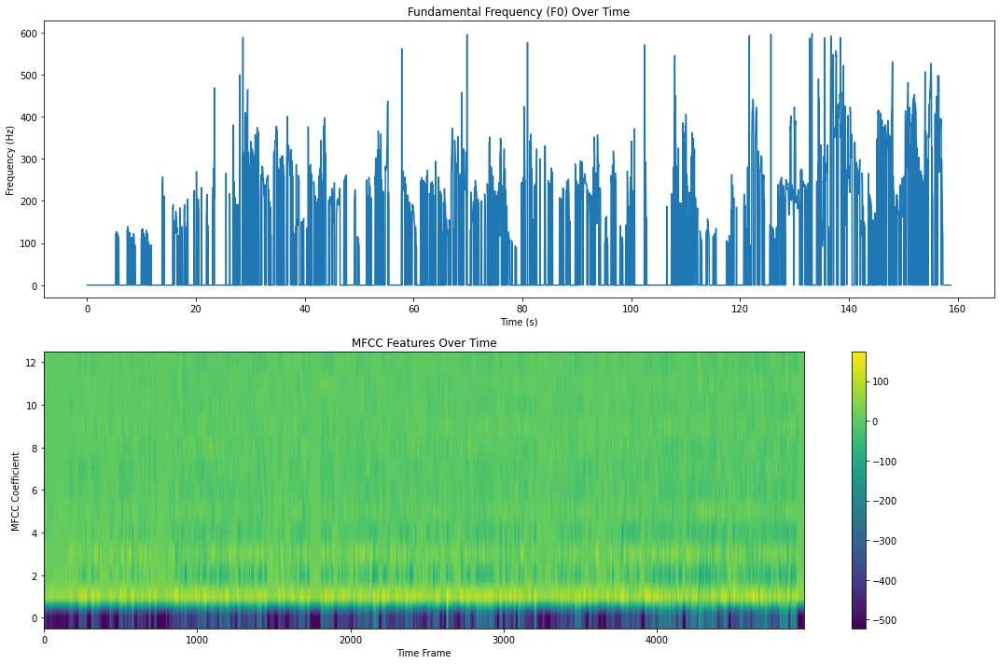

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro02_features.csv


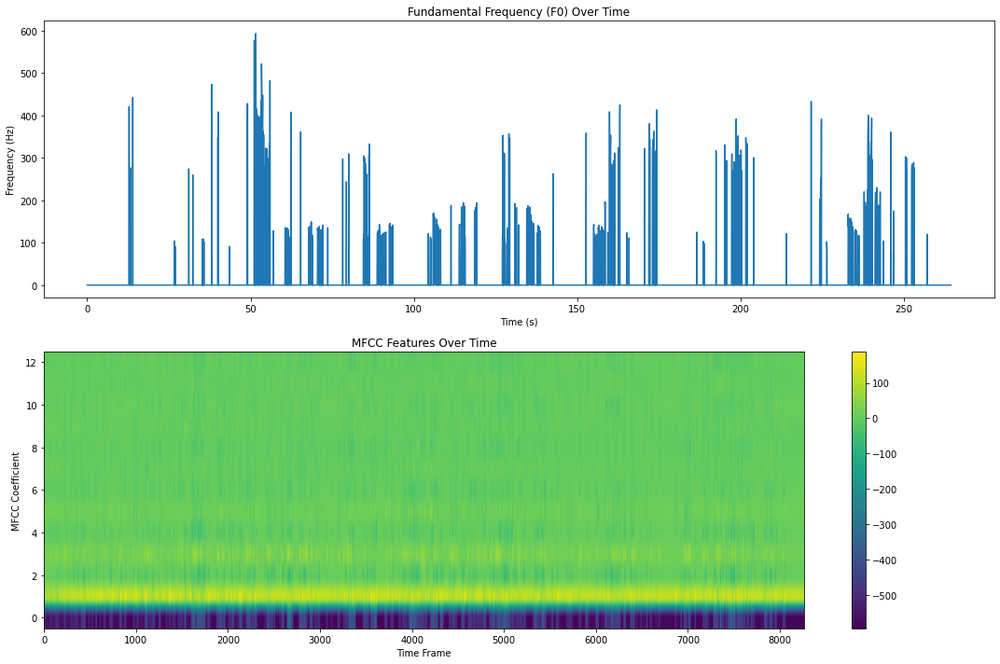

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro03_features.csv


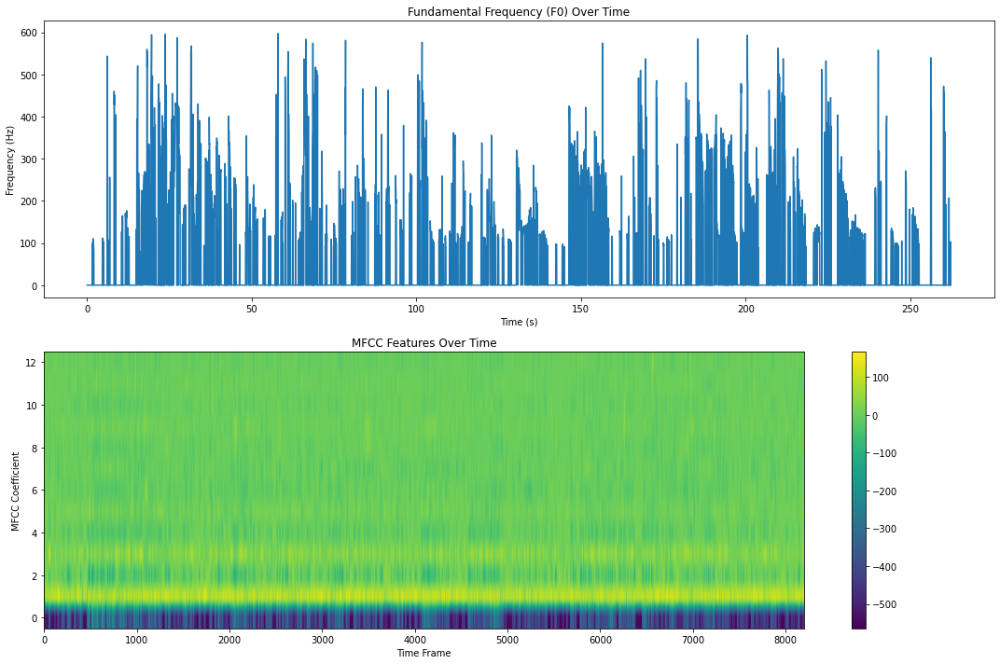

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro04_features.csv


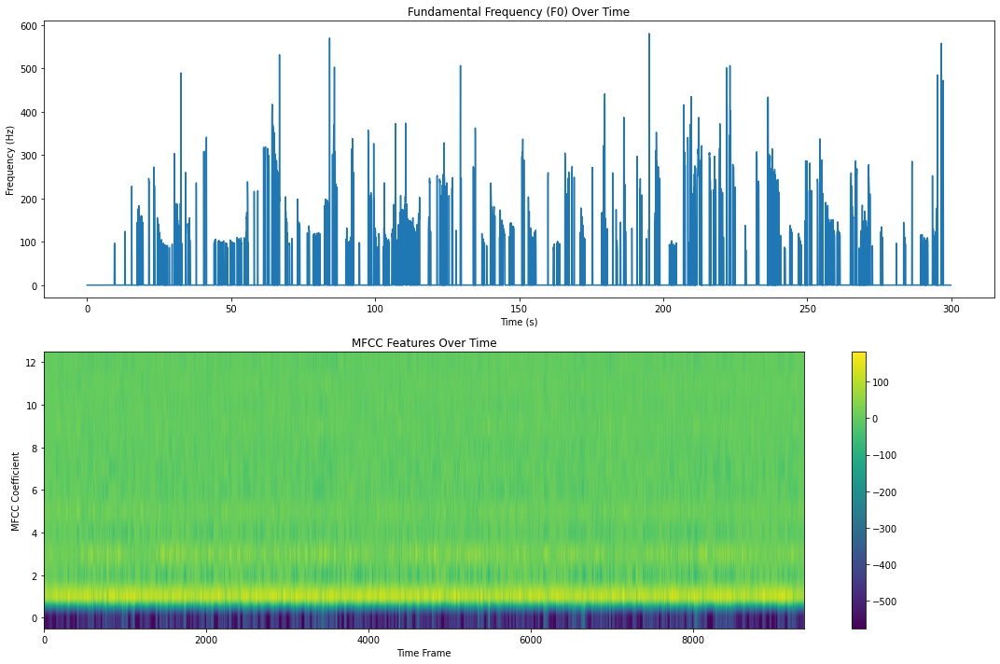

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro05a_features.csv


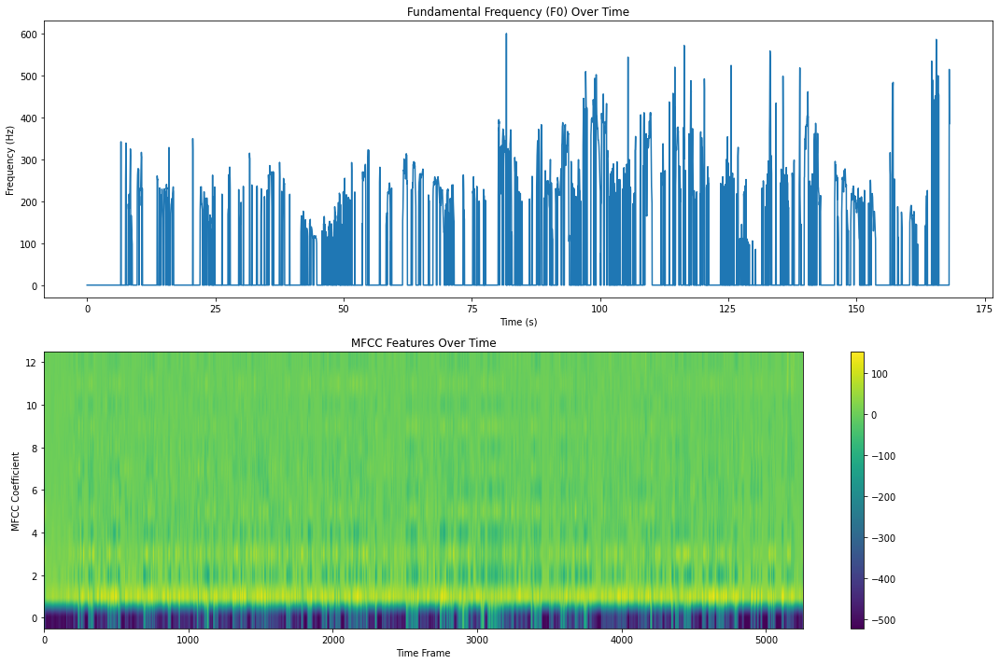

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro05b_features.csv


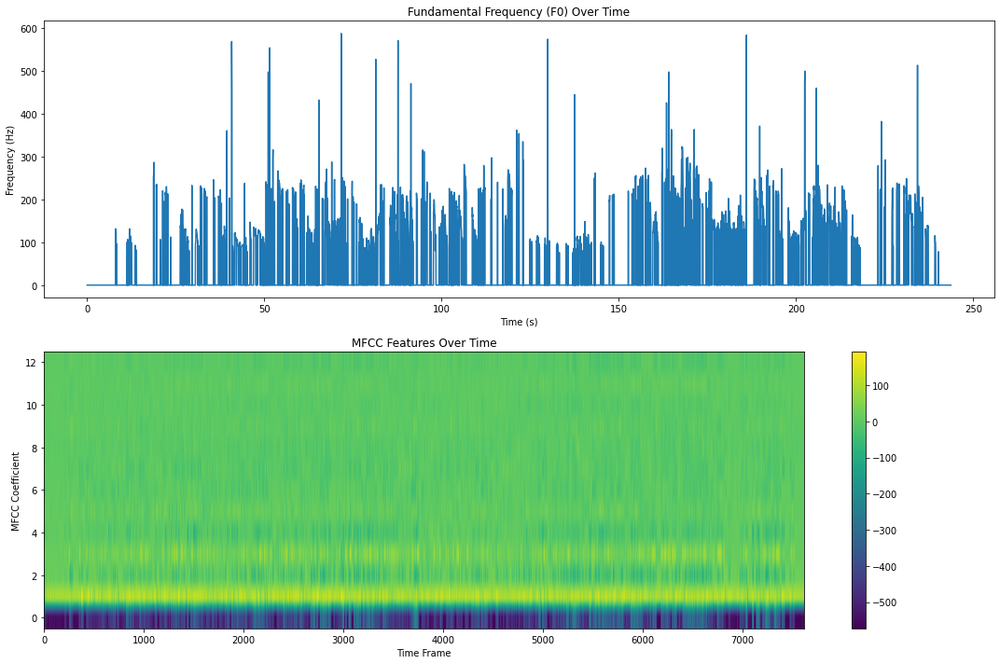

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro06_features.csv


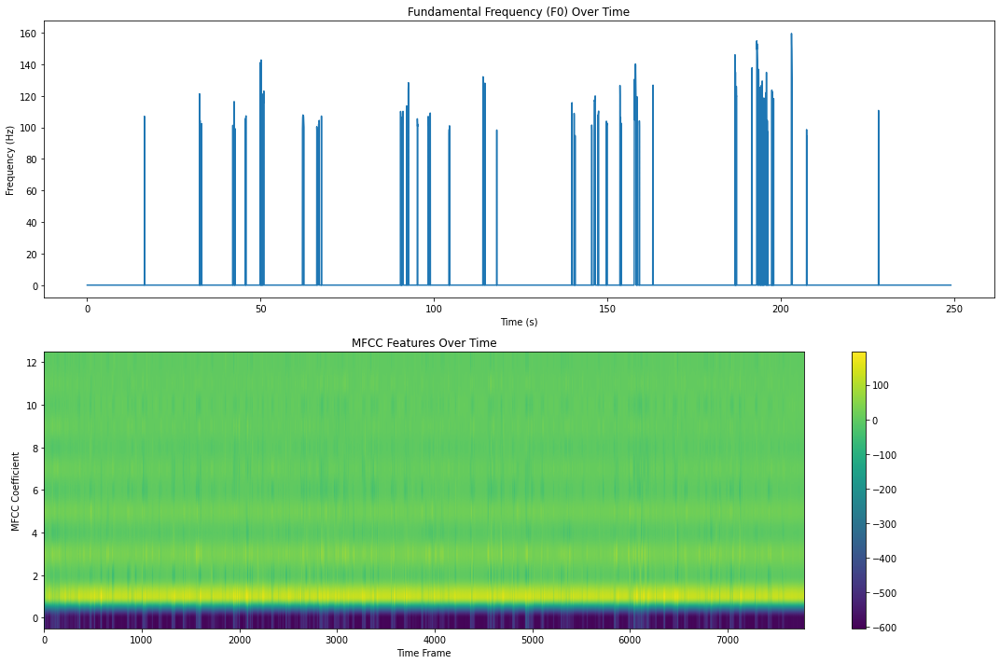

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro07_features.csv


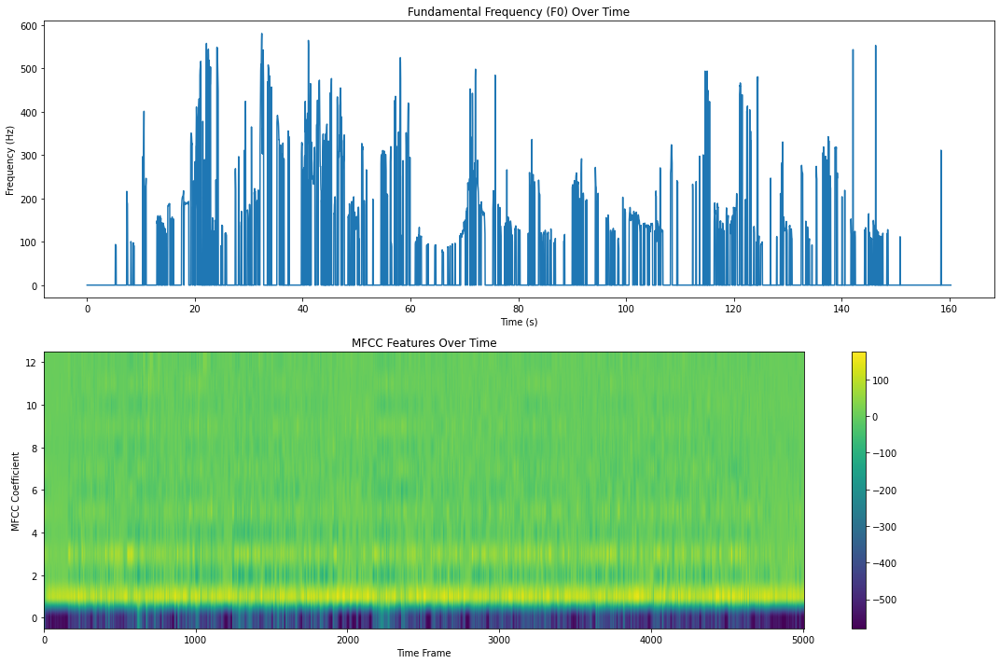

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro08a_features.csv


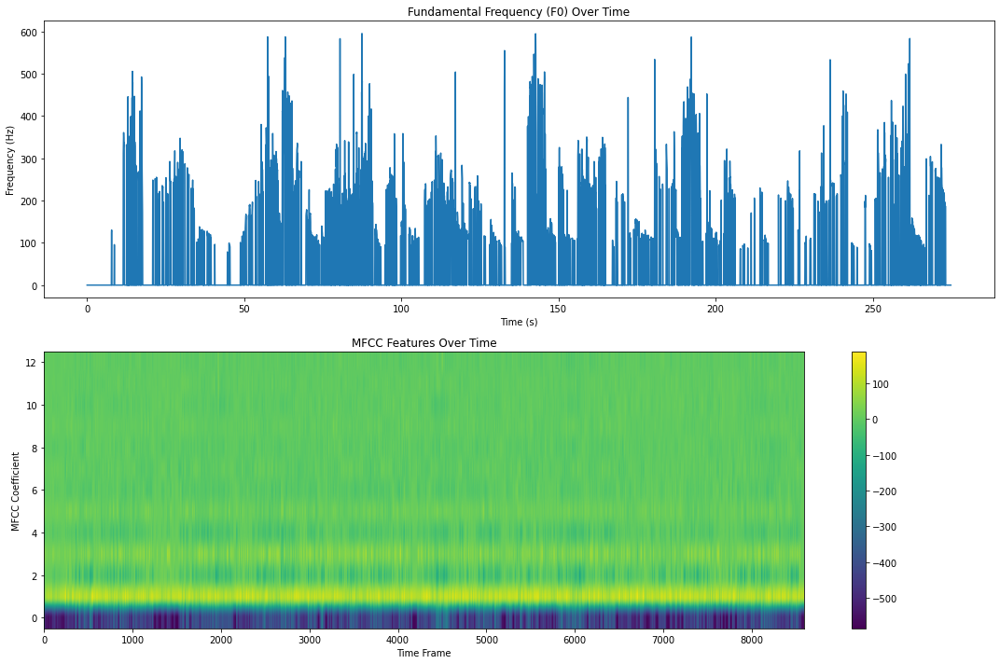

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_impro08b_features.csv


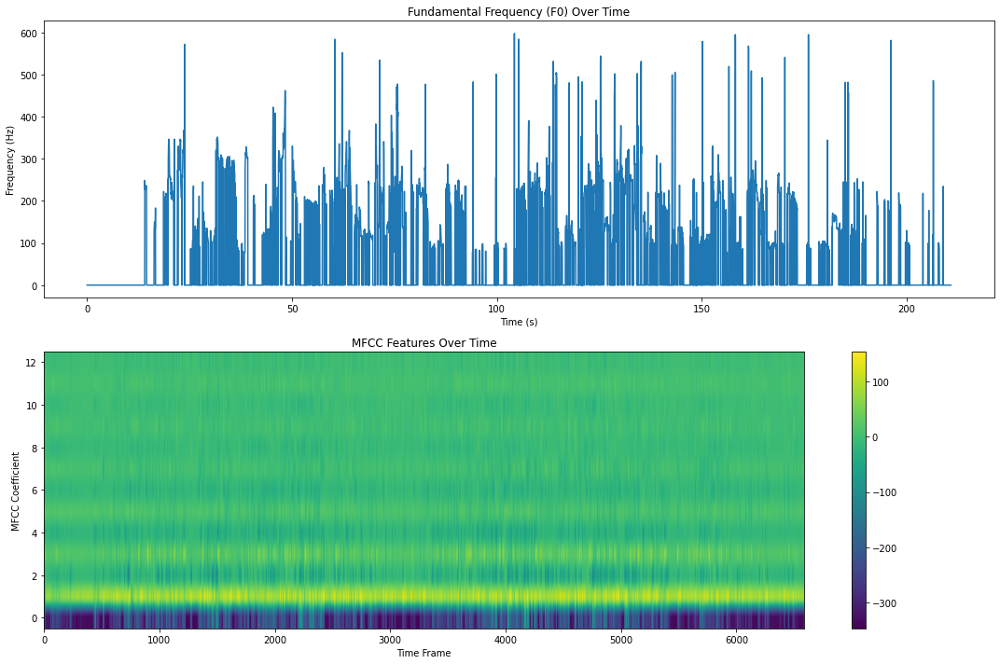

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_script01_1_features.csv


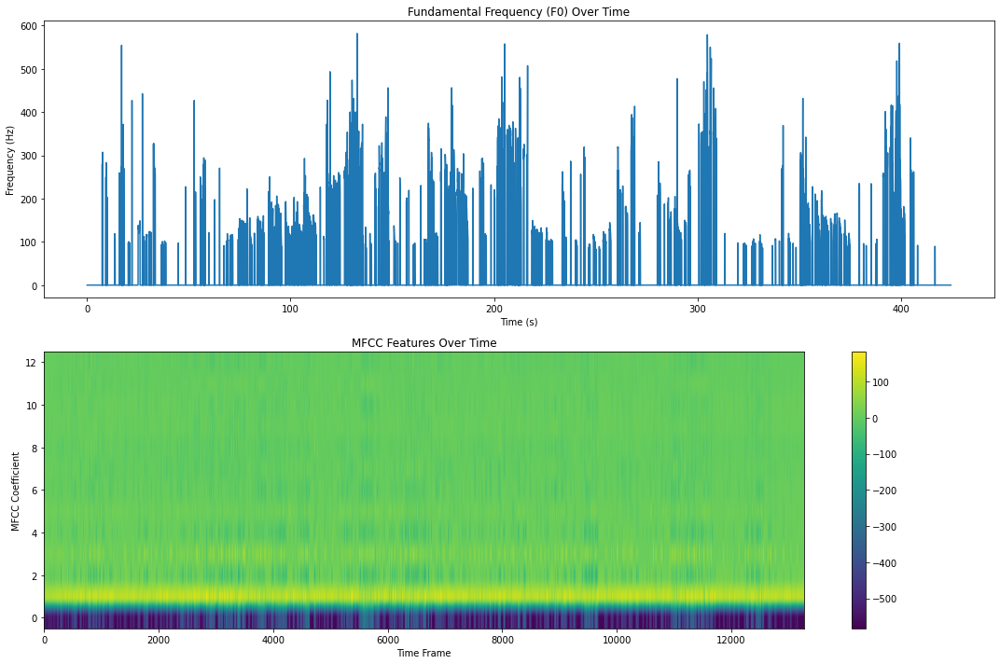

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_script01_2_features.csv


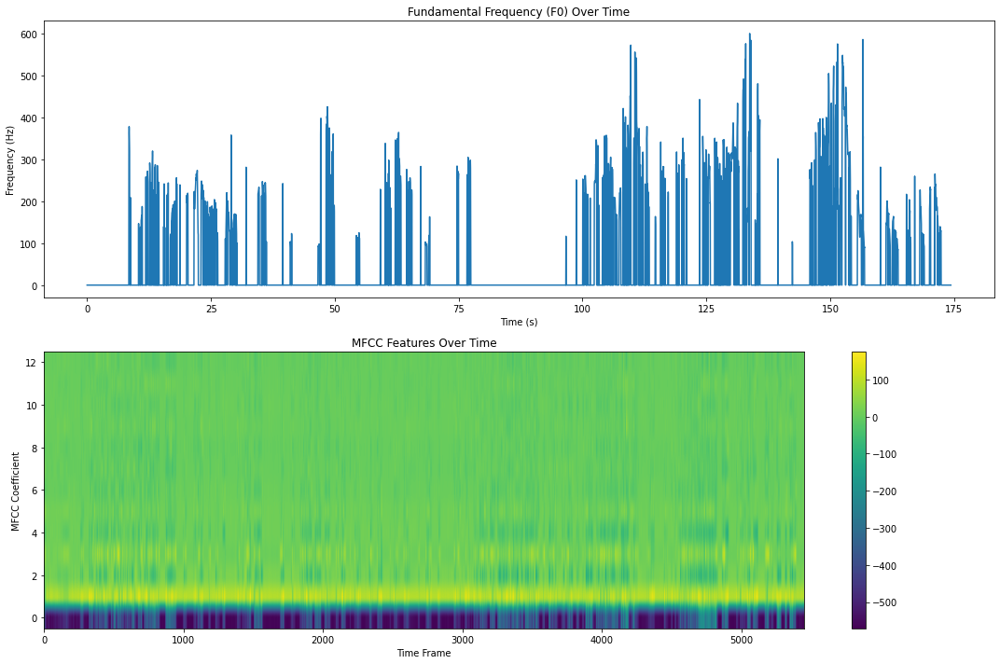

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_script01_3_features.csv


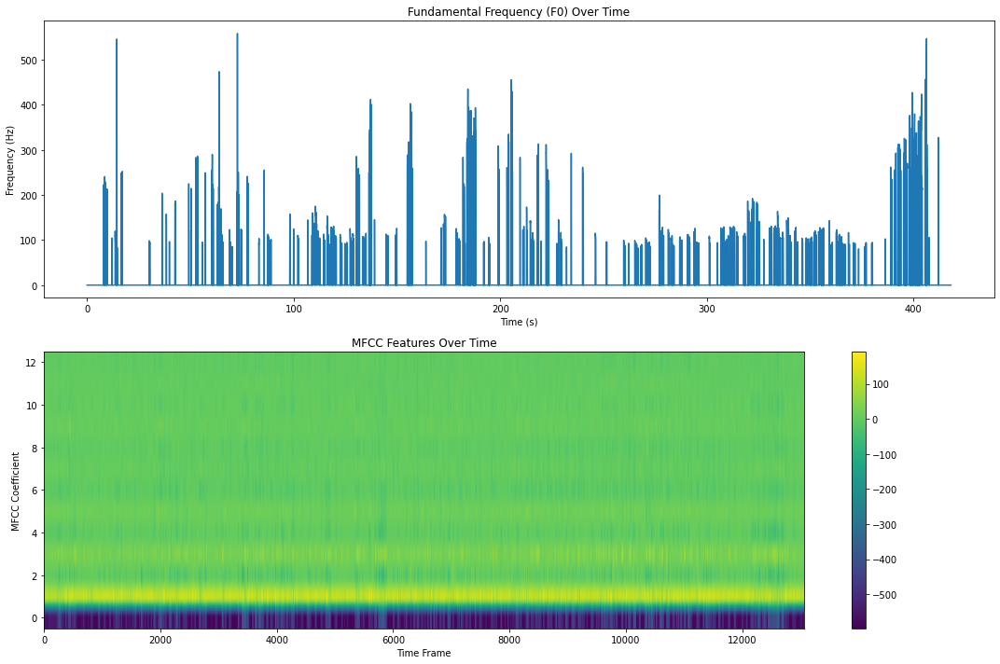

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_script02_1_features.csv


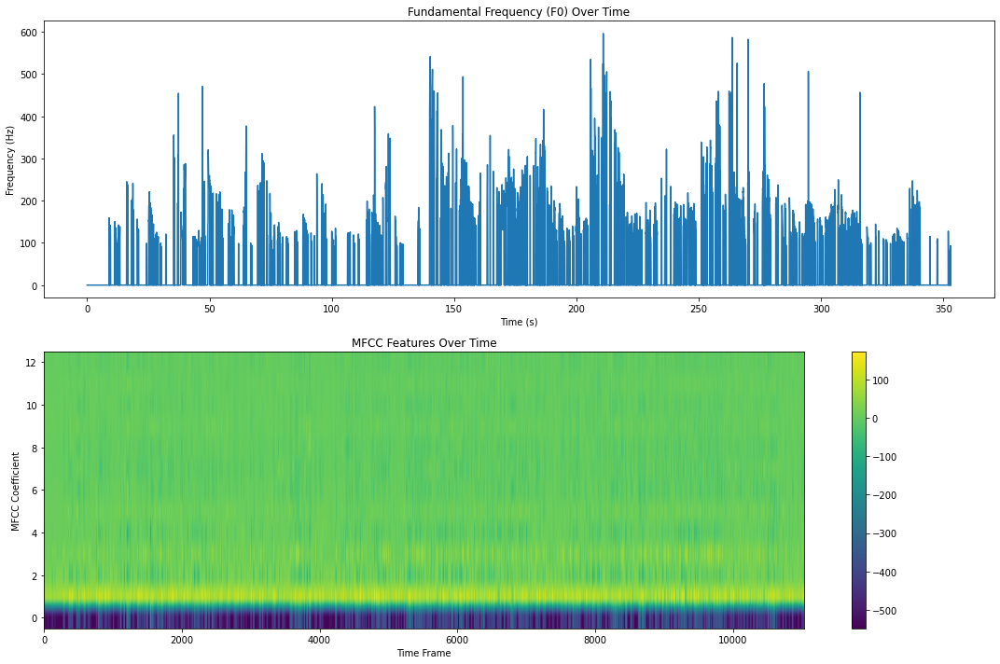

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_script02_2_features.csv


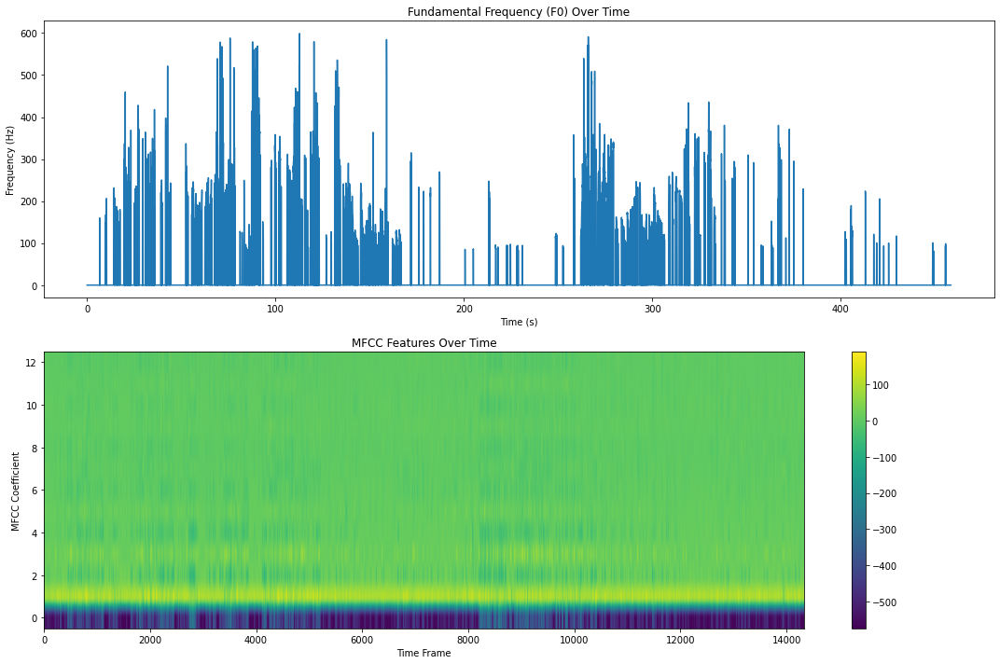

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_script03_1_features.csv


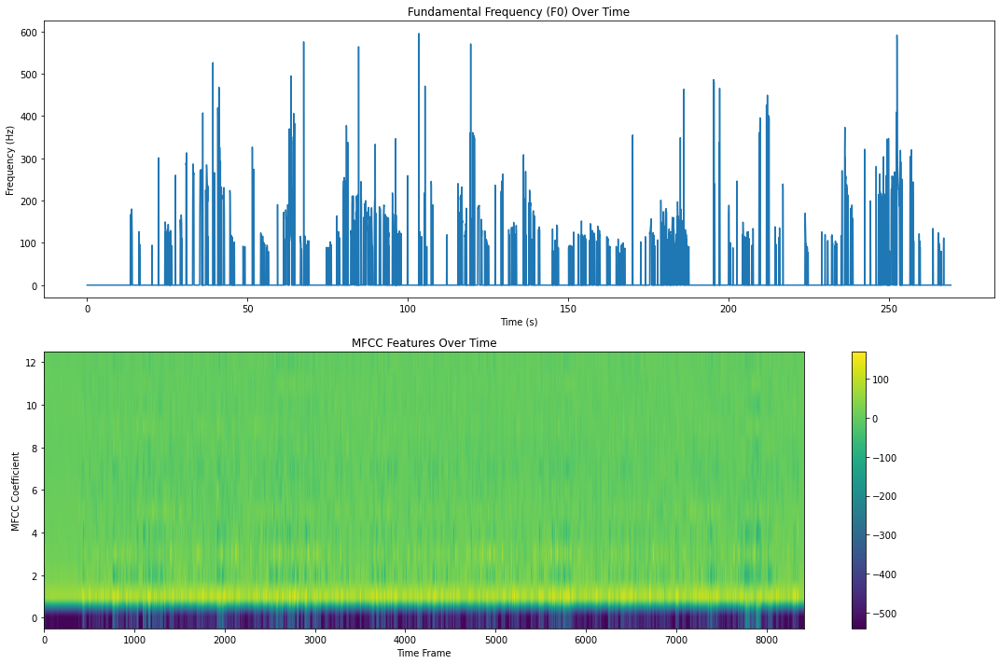

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses03M_script03_2_features.csv


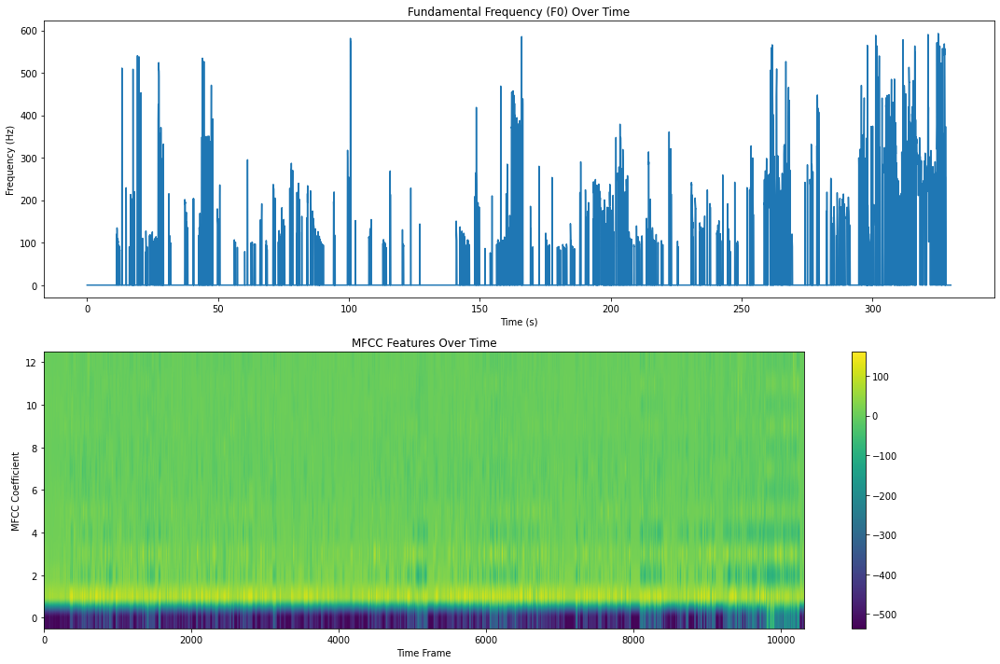

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro01_features.csv


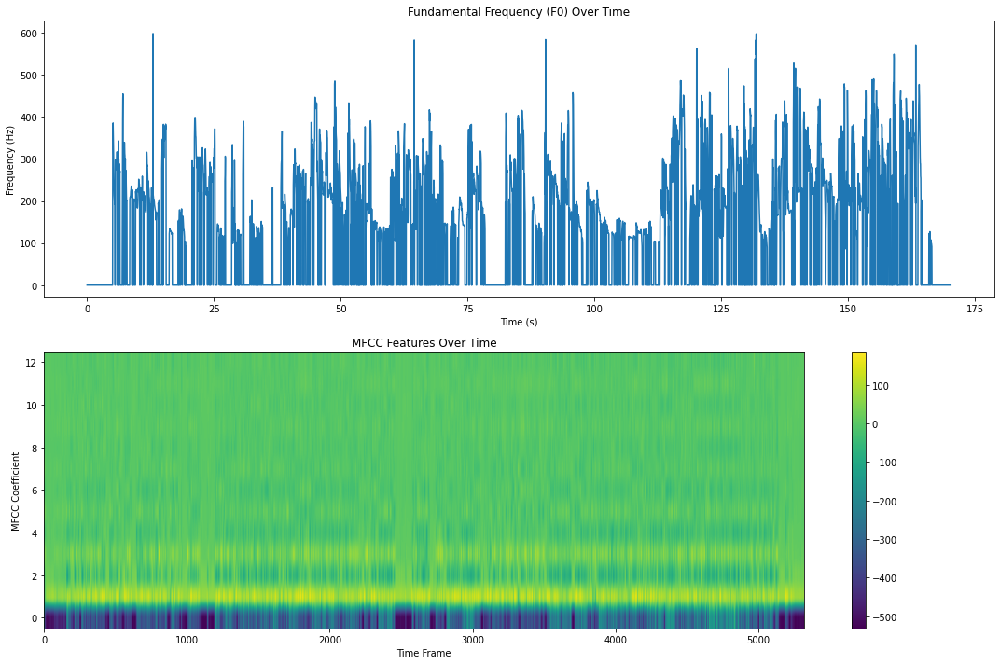

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro02_features.csv


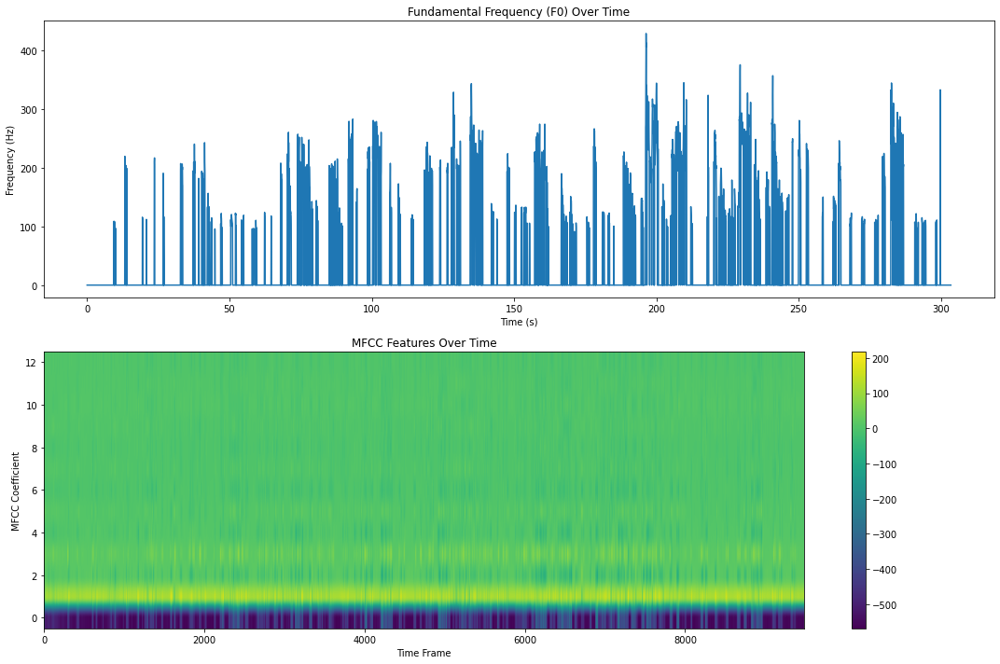

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro03_features.csv


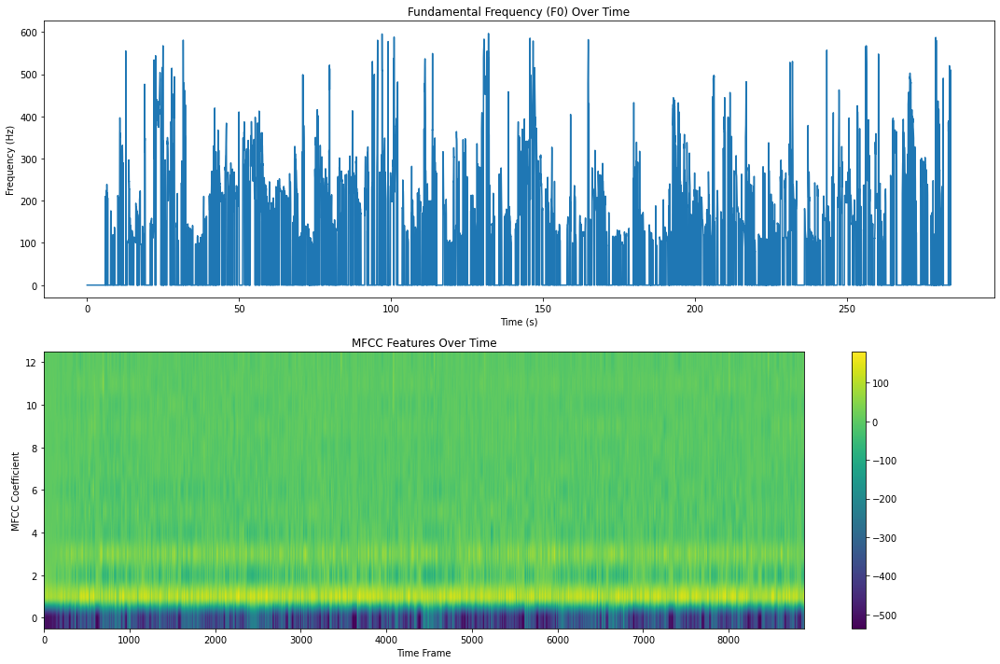

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro04_features.csv


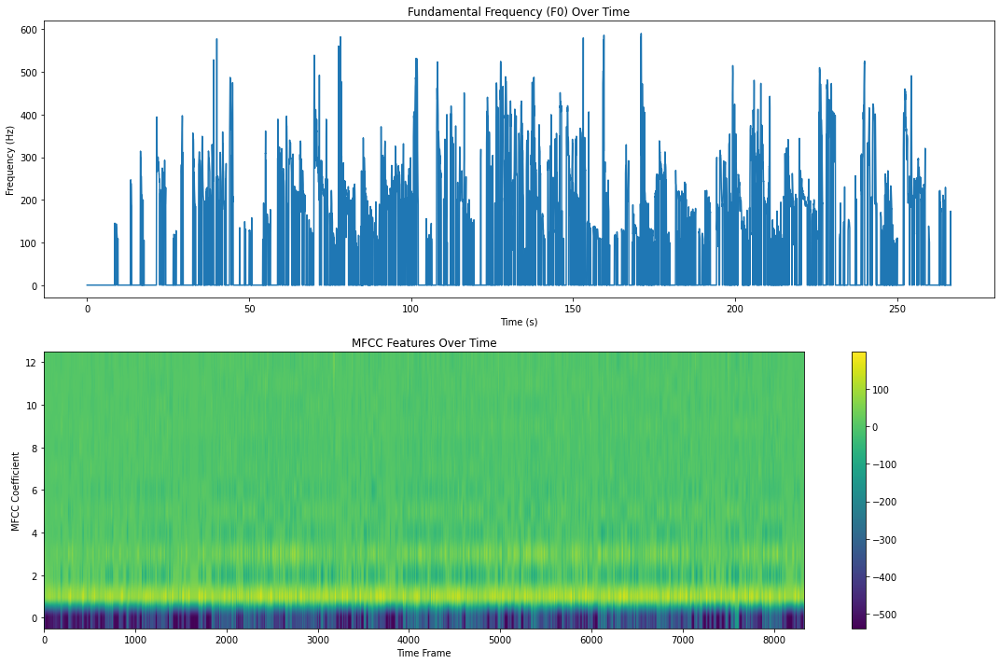

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro05_features.csv


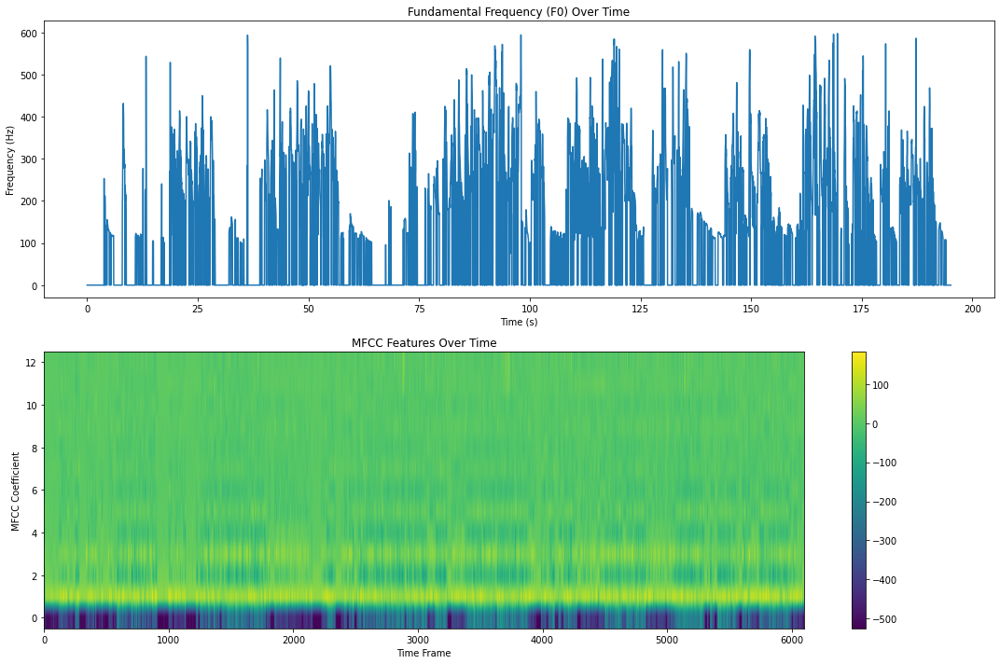

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro06_features.csv


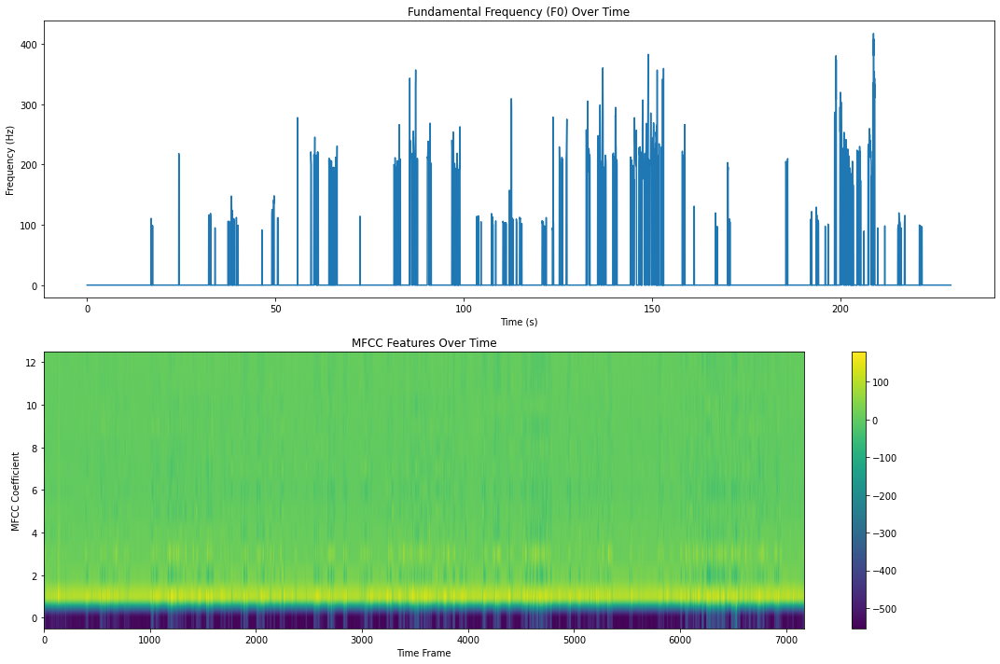

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro07_features.csv


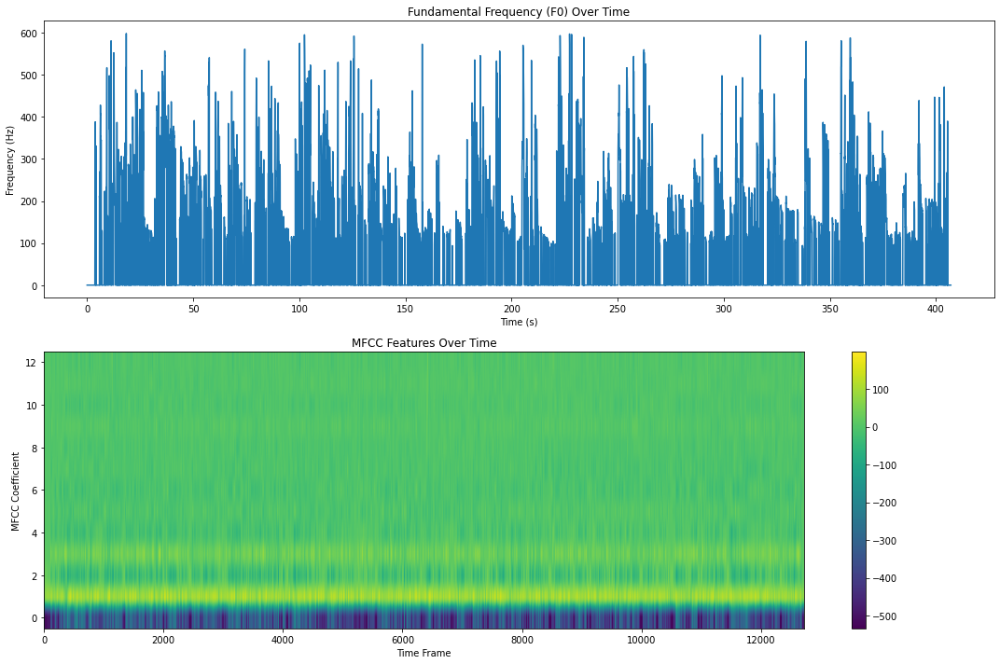

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_impro08_features.csv


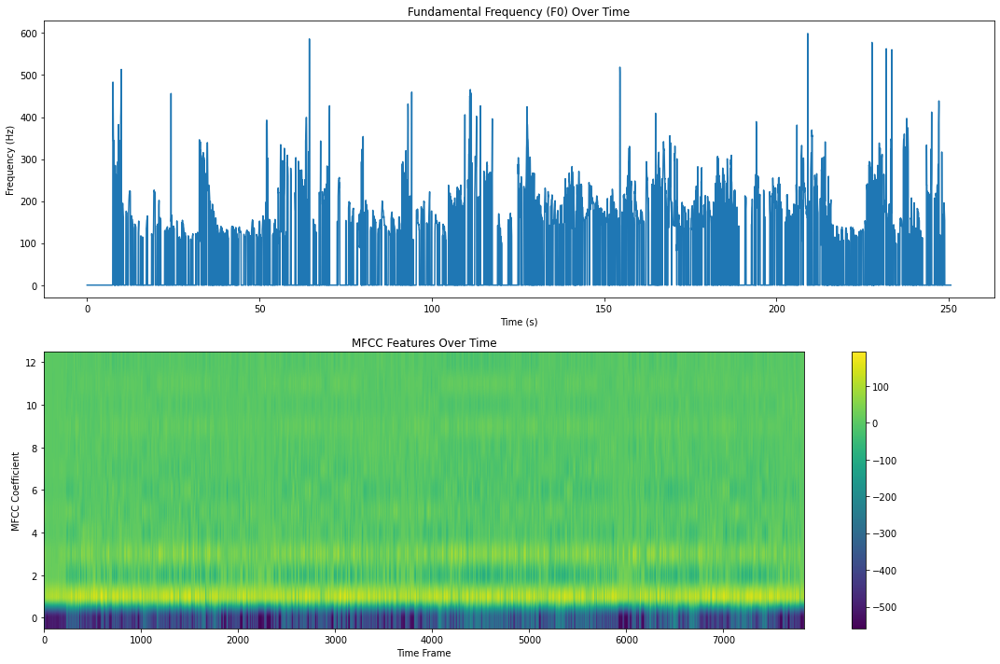

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_script01_1_features.csv


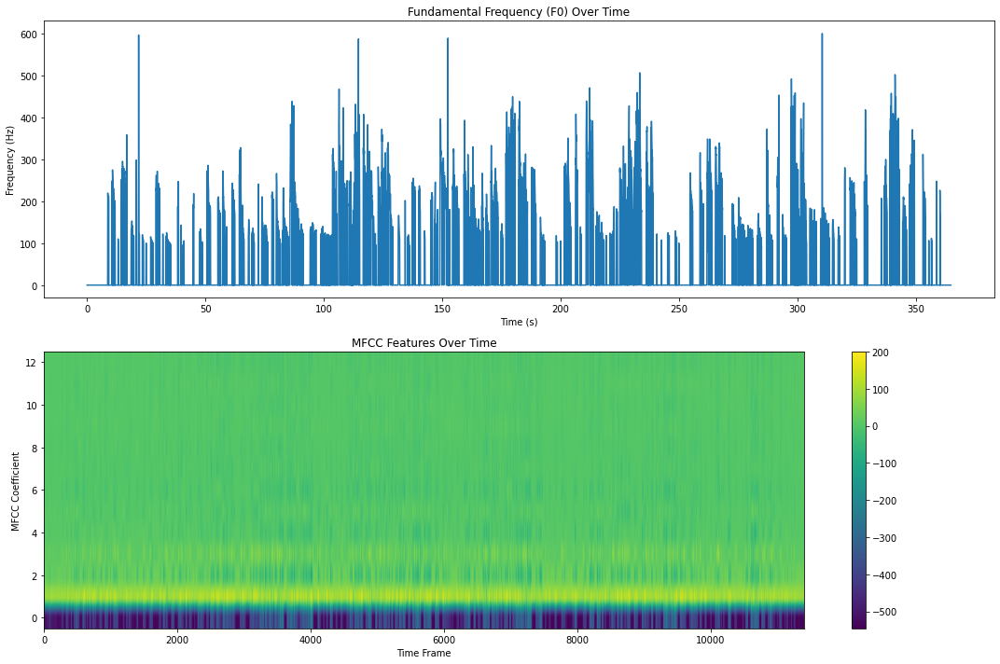

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_script01_2_features.csv


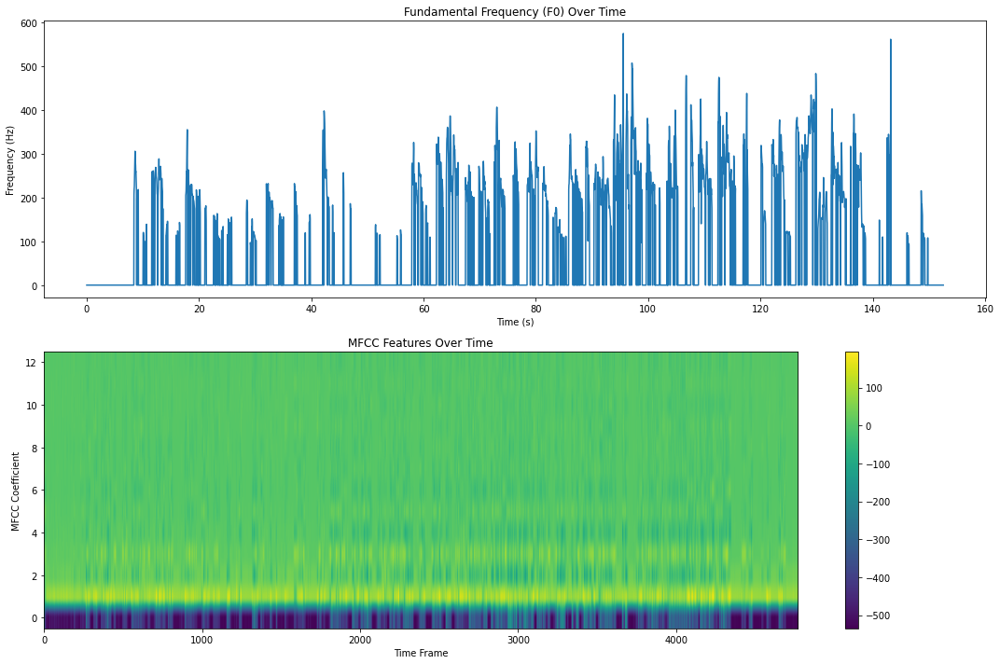

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_script01_3_features.csv


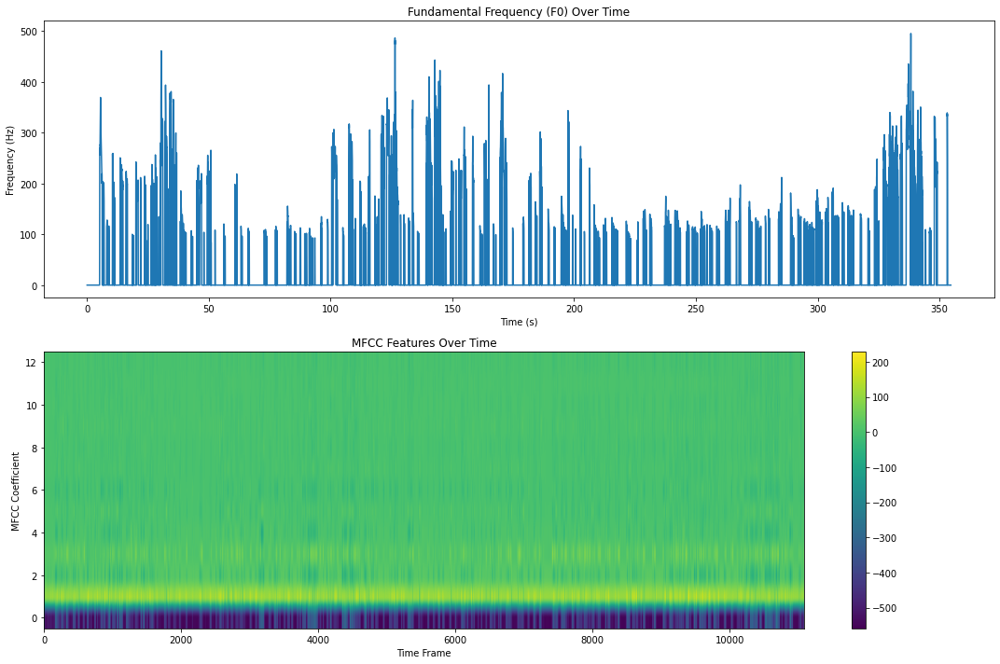

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_script02_1_features.csv


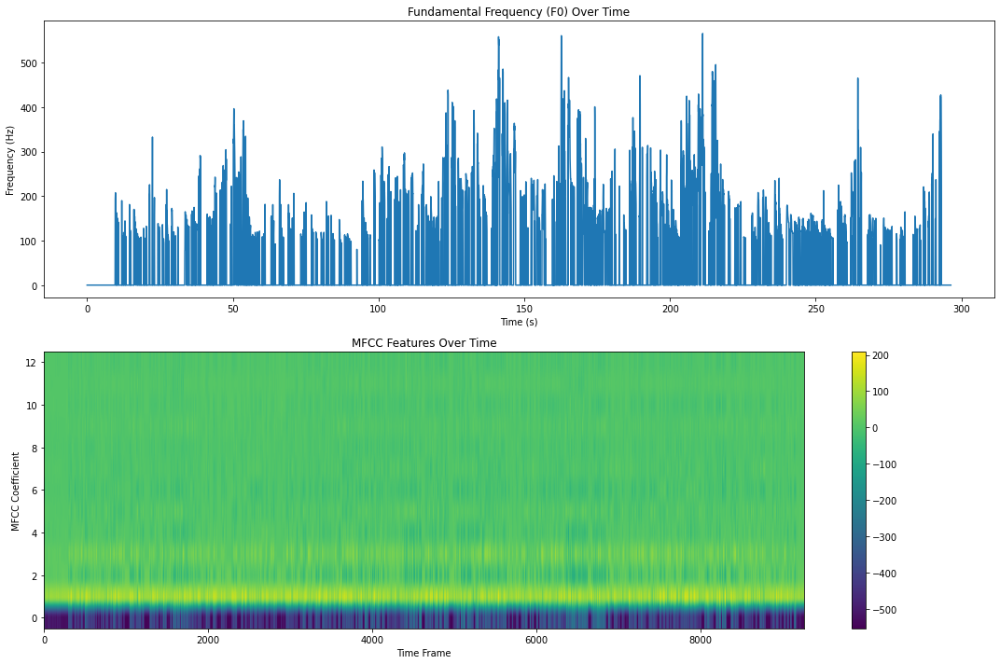

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_script02_2_features.csv


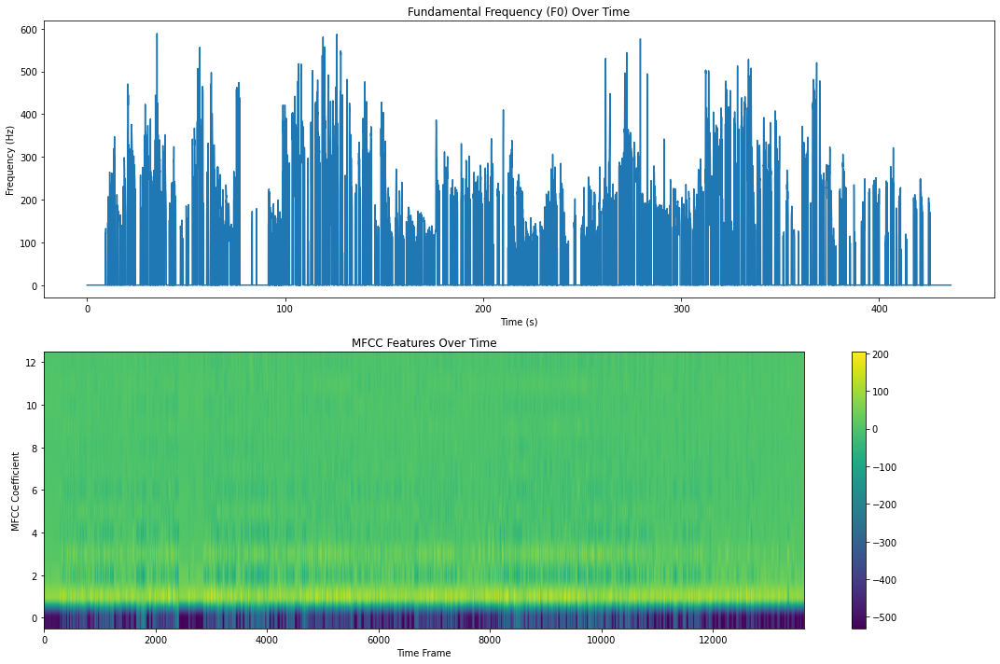

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_script03_1_features.csv


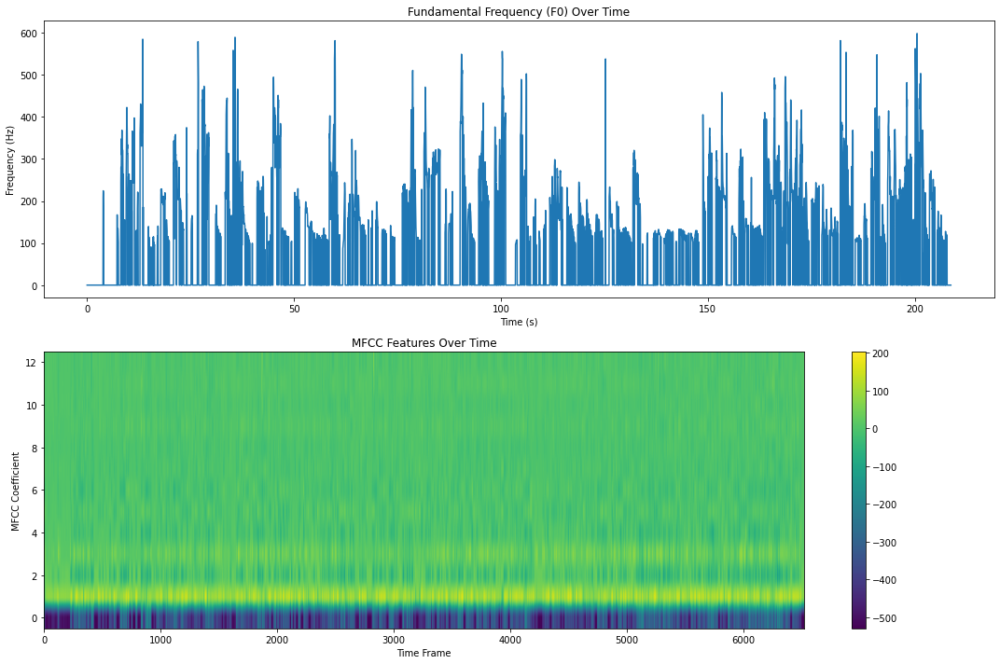

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04F_script03_2_features.csv


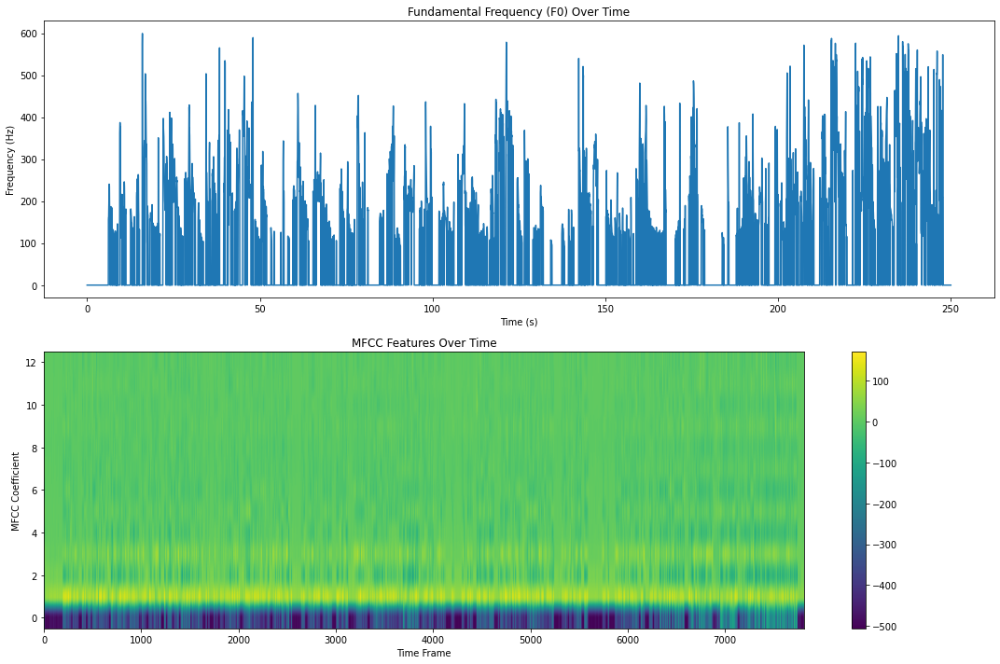

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro01_features.csv


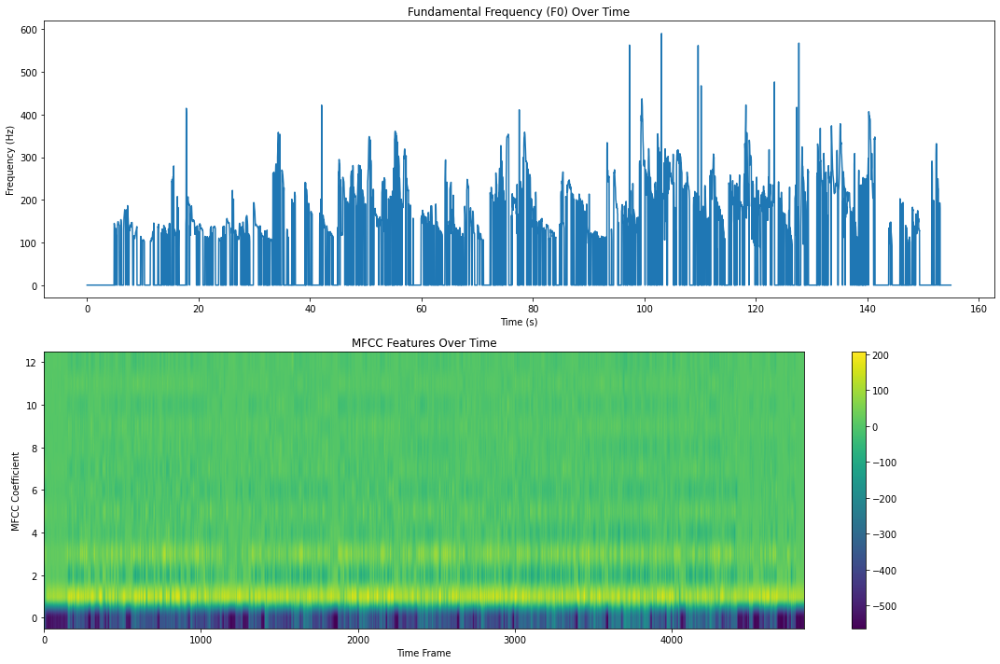

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro02_features.csv


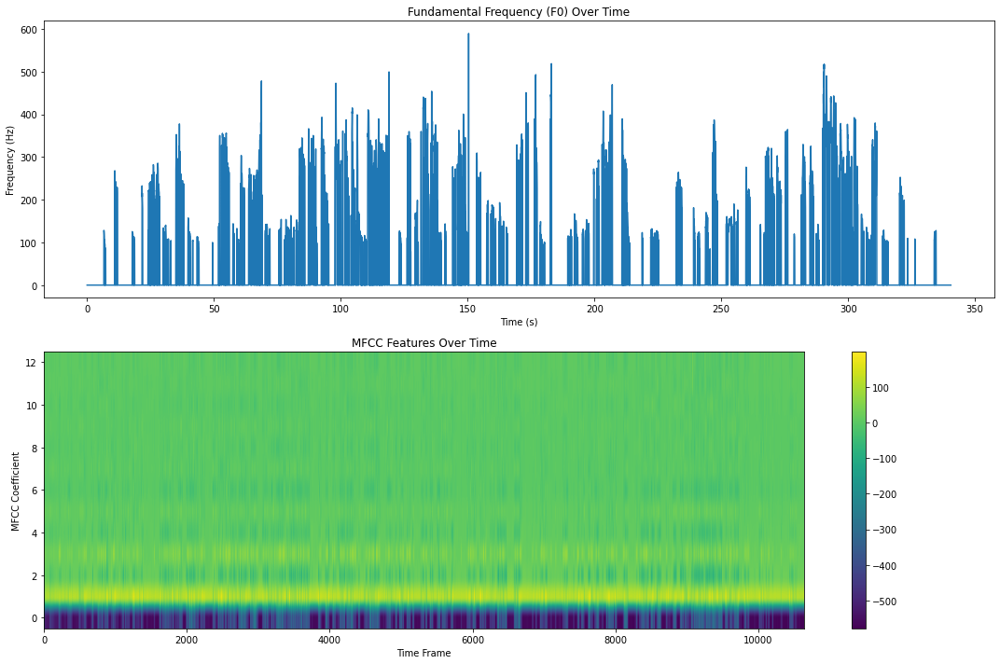

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro03_features.csv


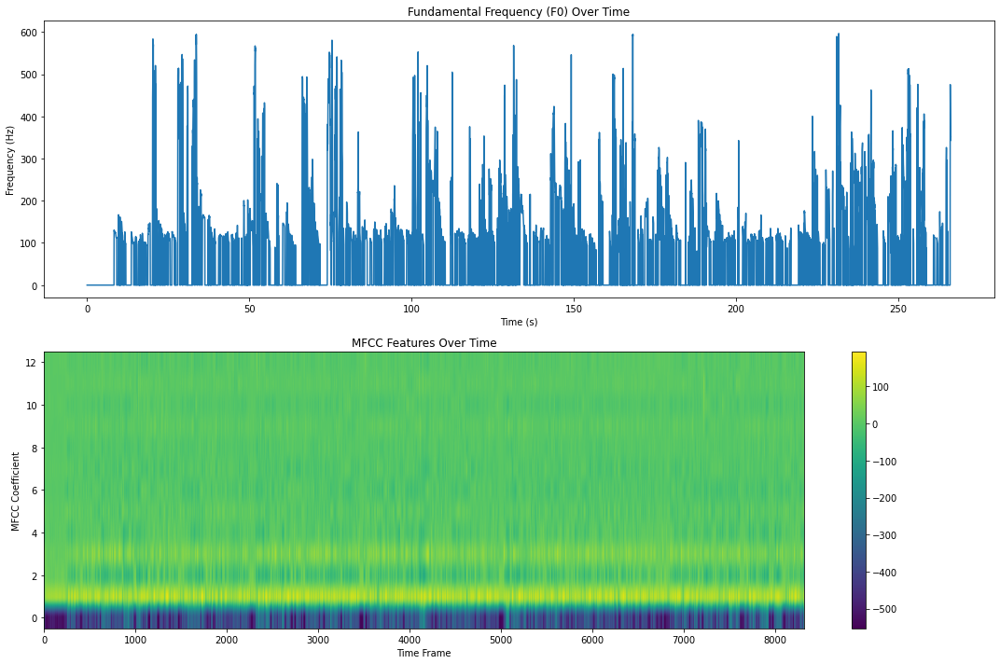

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro04_features.csv


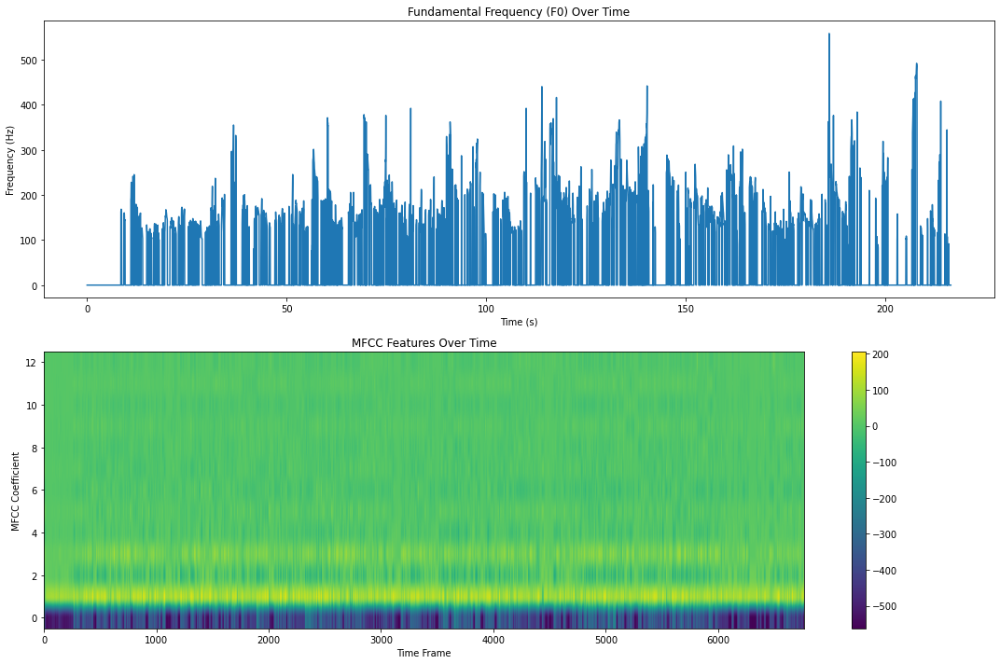

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro05_features.csv


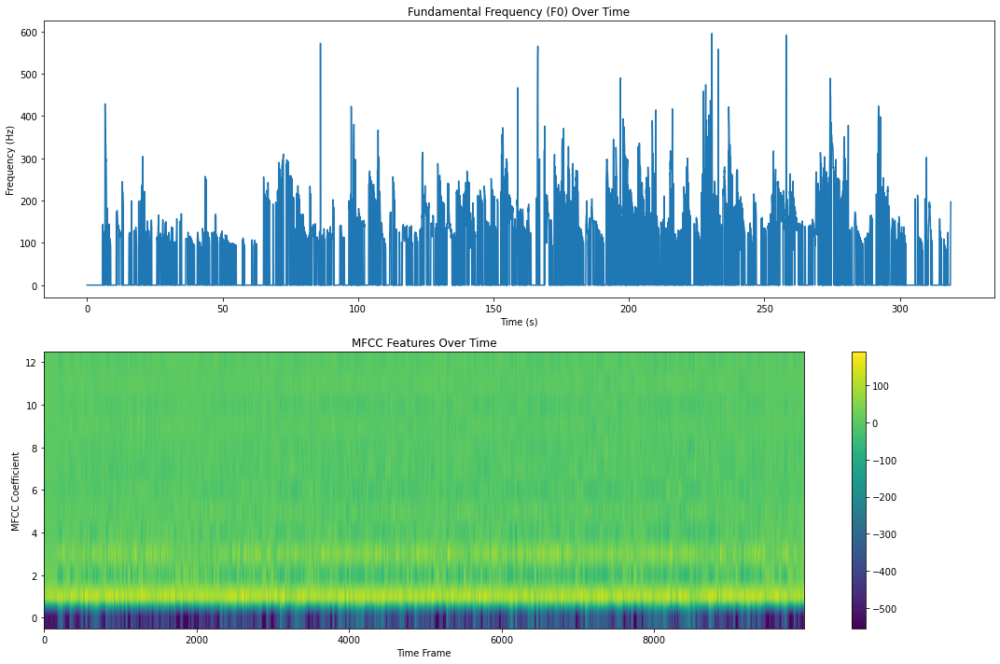

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro06_features.csv


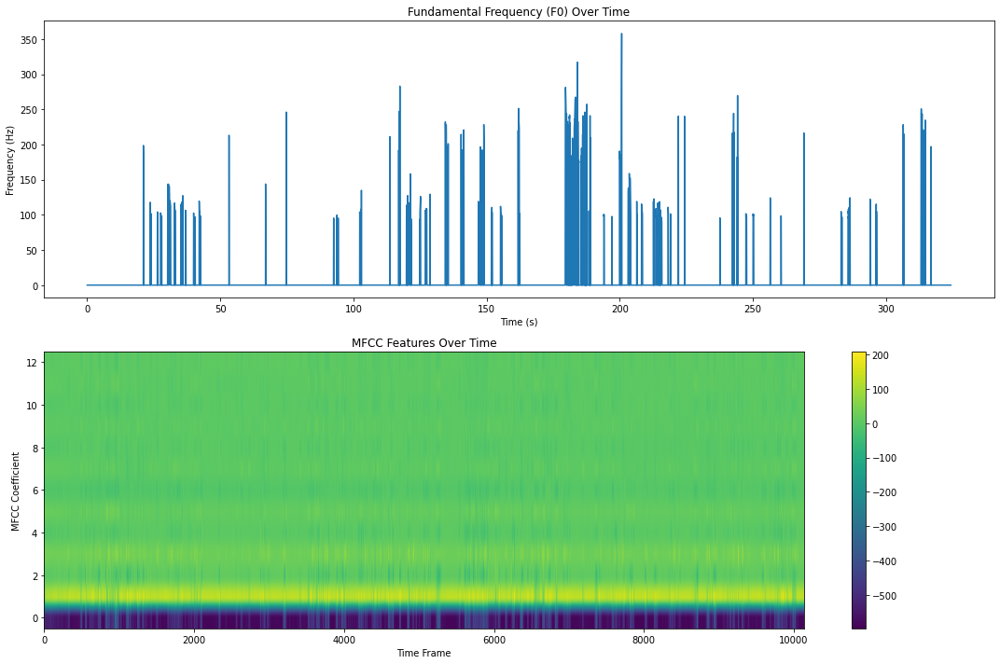

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro07_features.csv


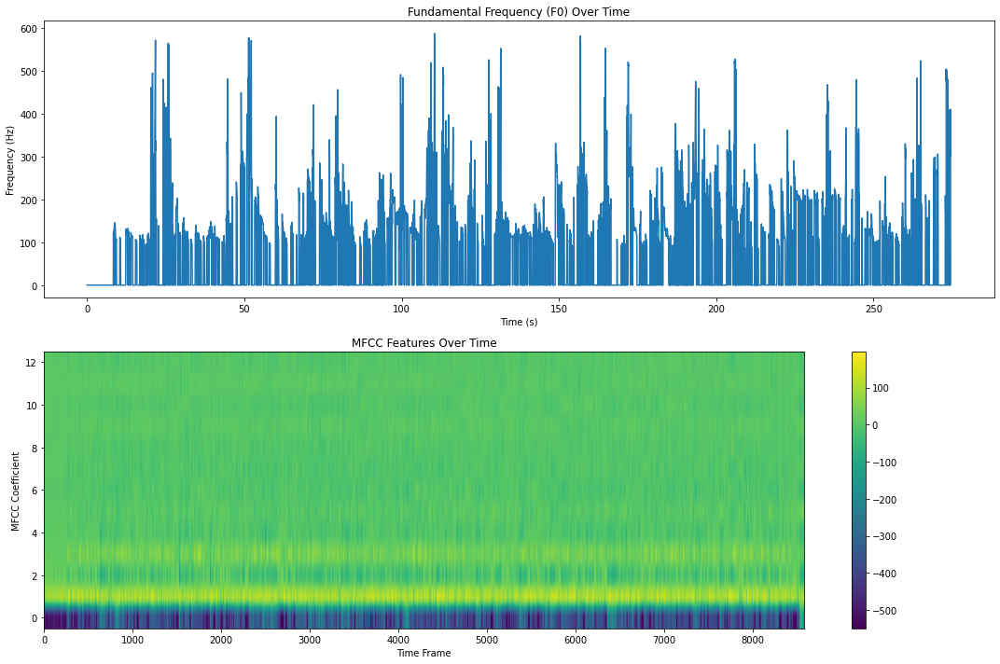

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_impro08_features.csv


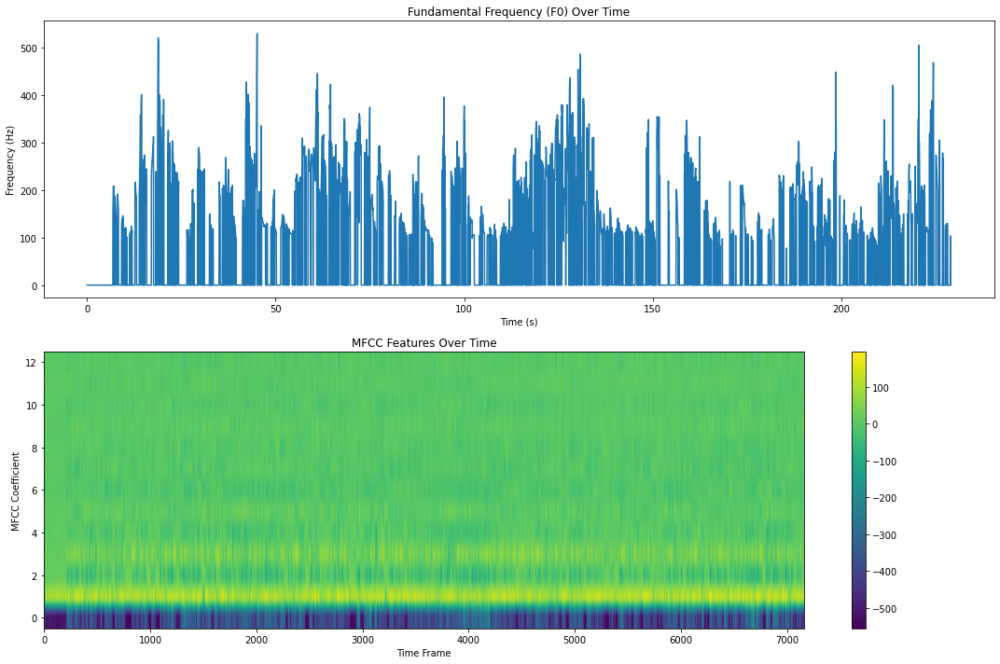

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_script01_1_features.csv


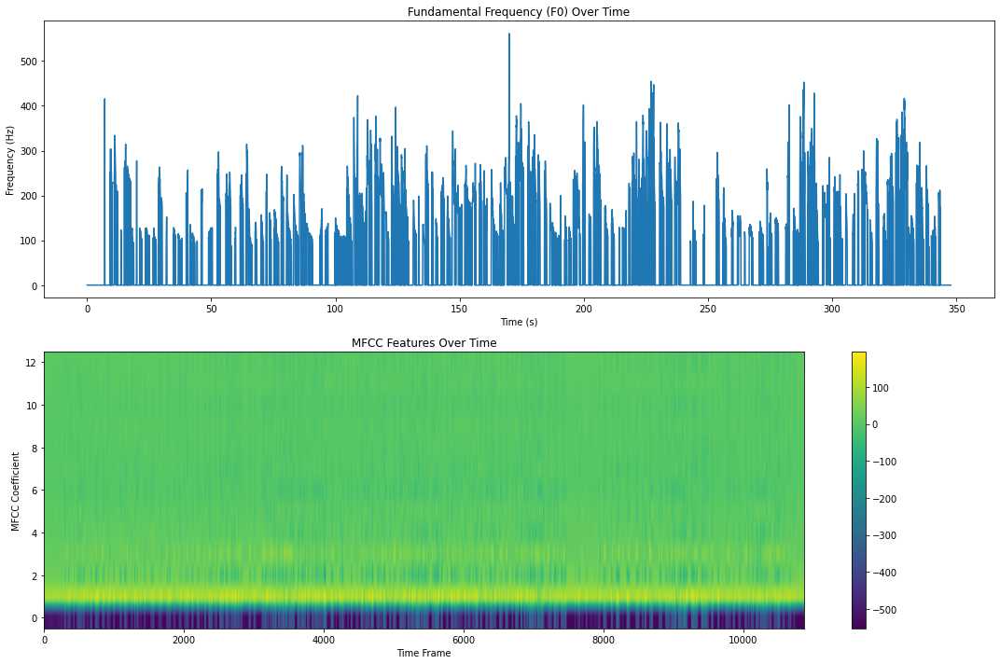

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_script01_2_features.csv


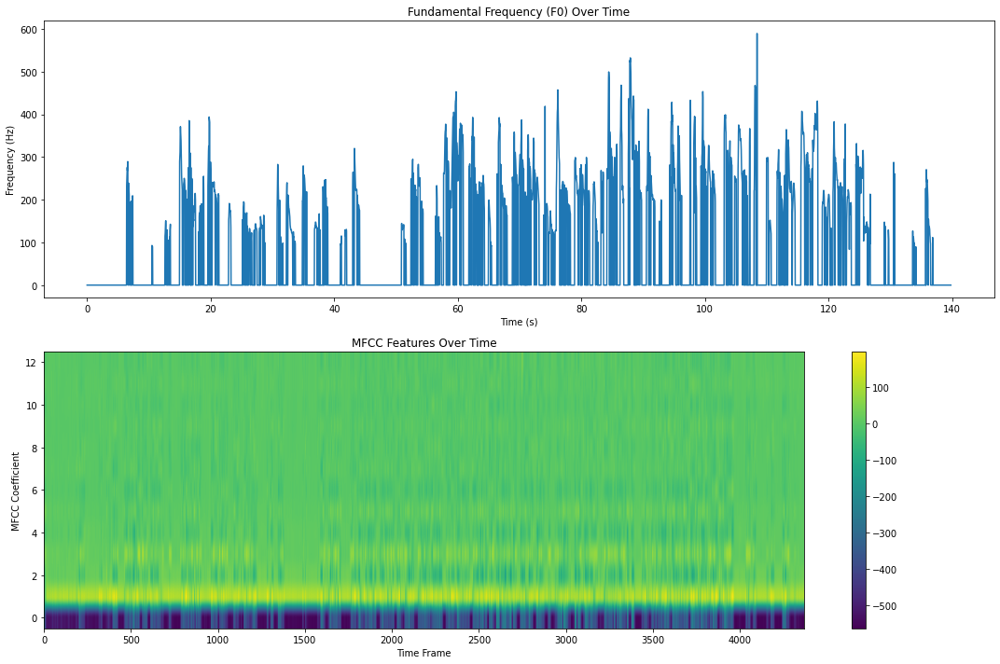

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_script01_3_features.csv


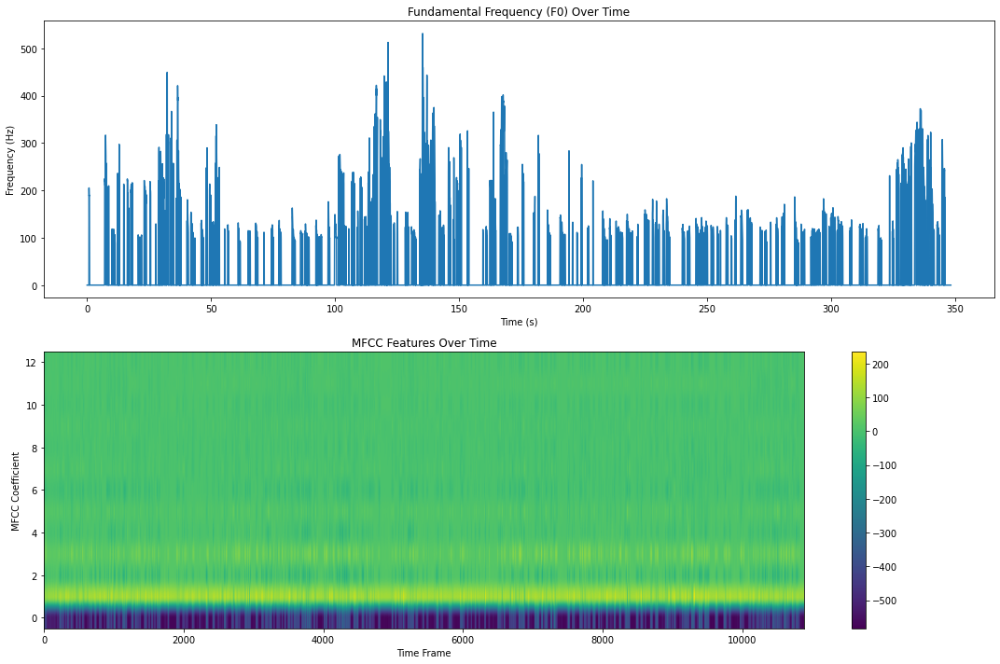

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_script02_1_features.csv


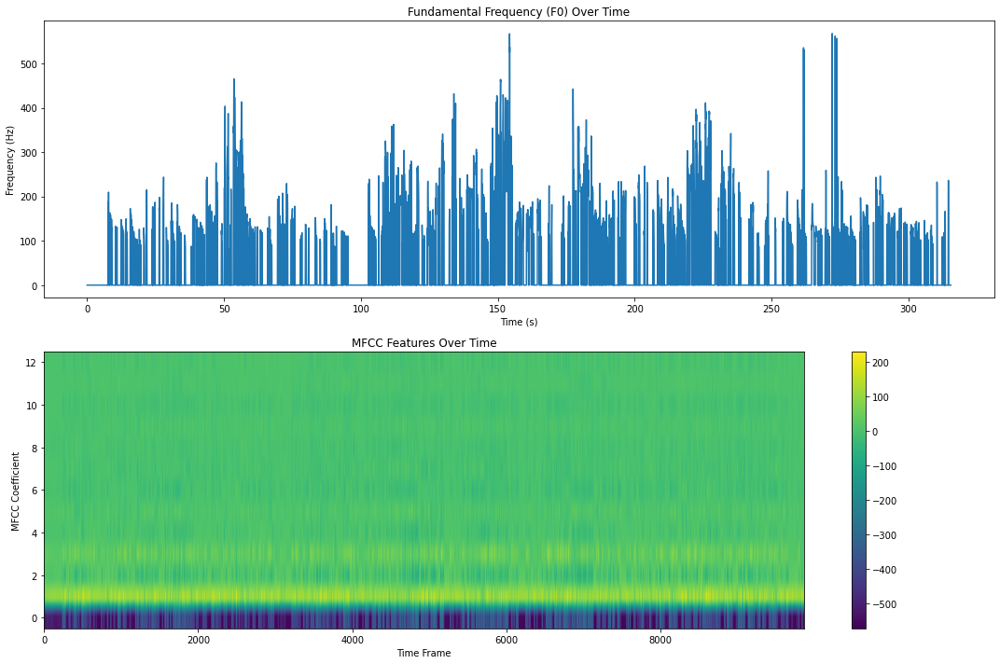

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_script02_2_features.csv


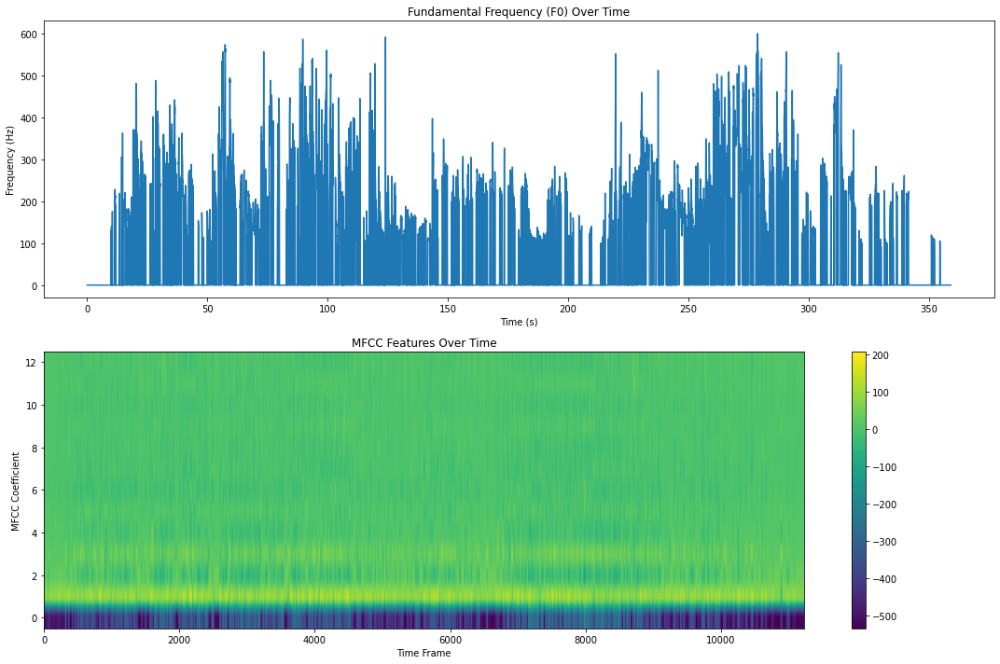

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_script03_1_features.csv


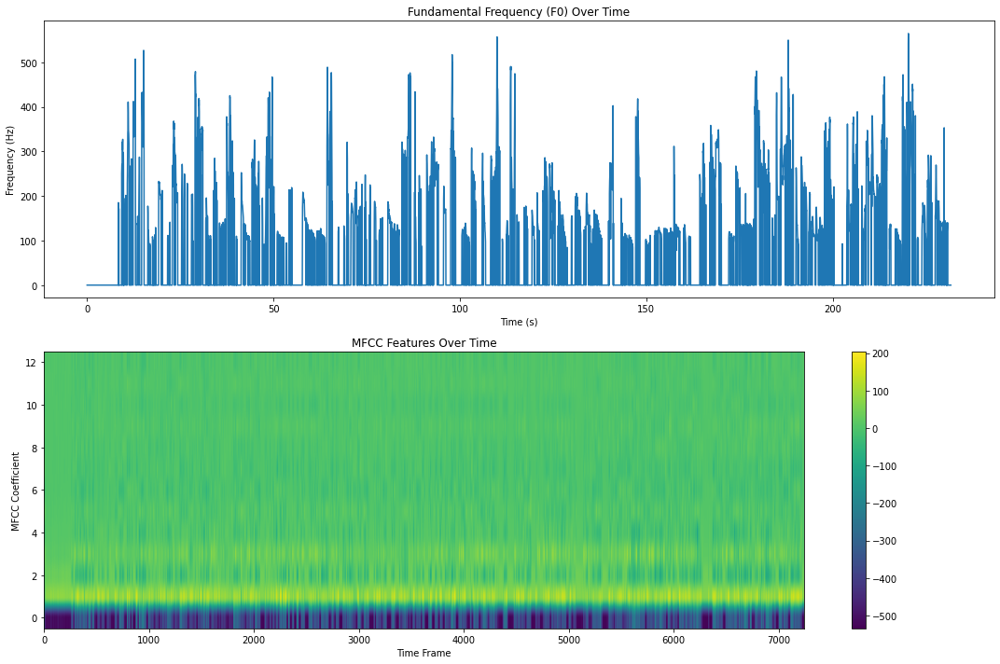

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses04M_script03_2_features.csv


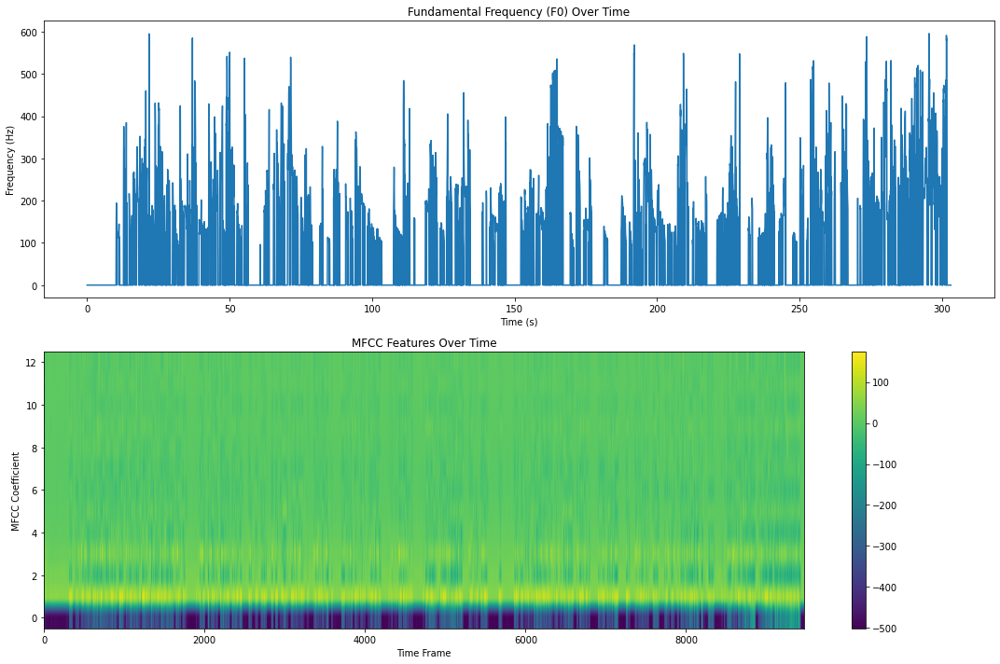

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro01_features.csv


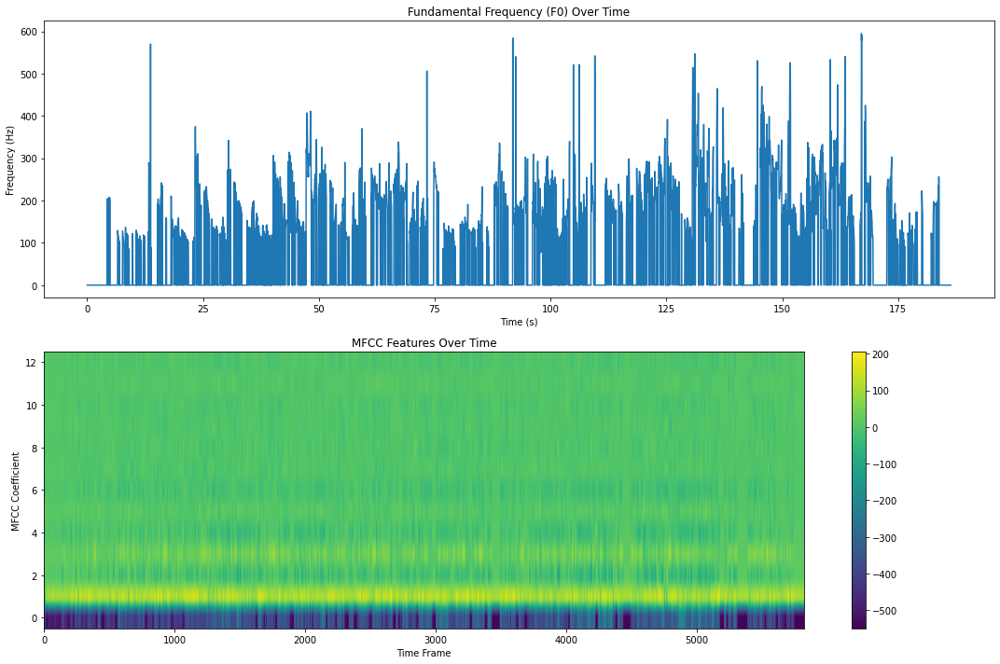

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro02_features.csv


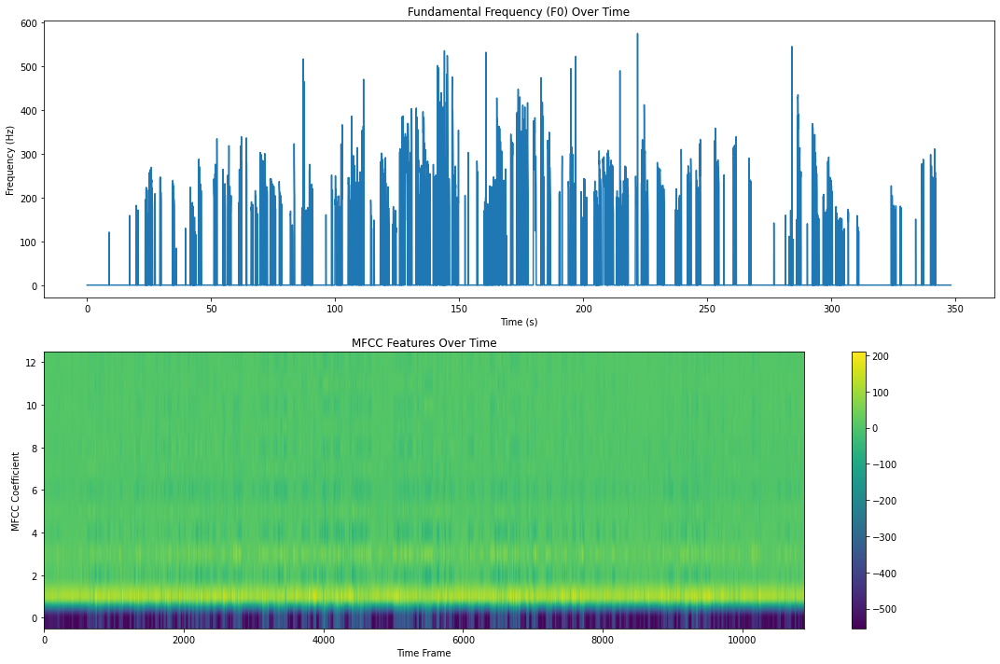

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro03_features.csv


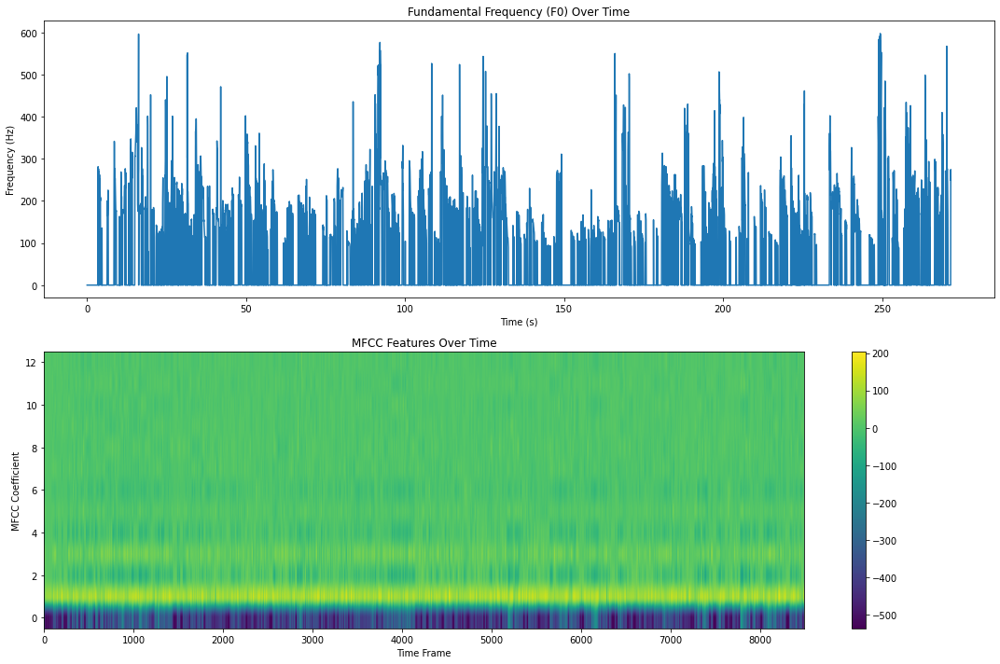

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro04_features.csv


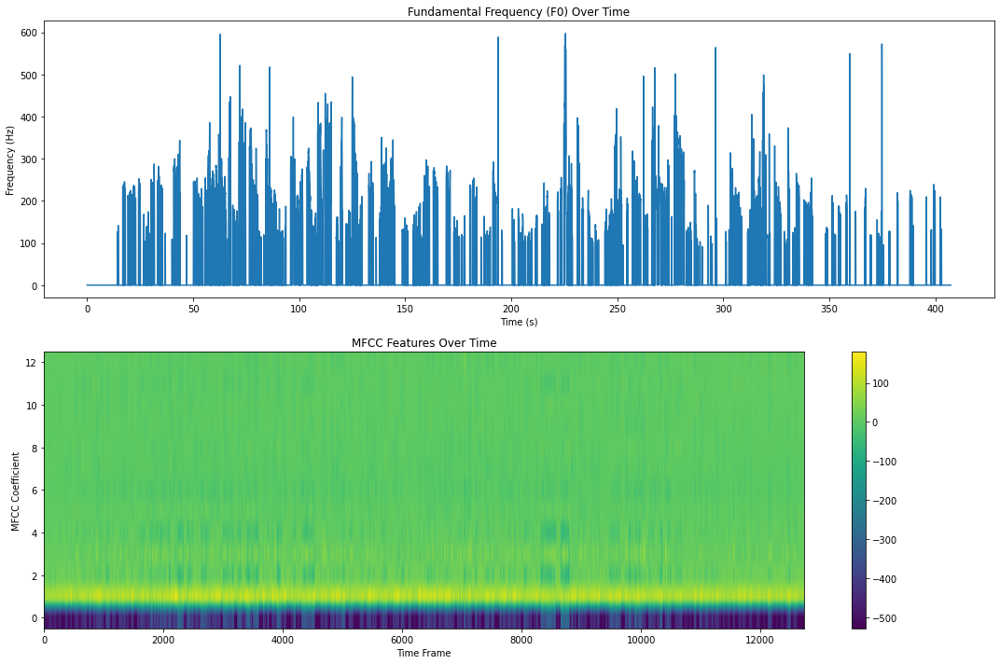

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro05_features.csv


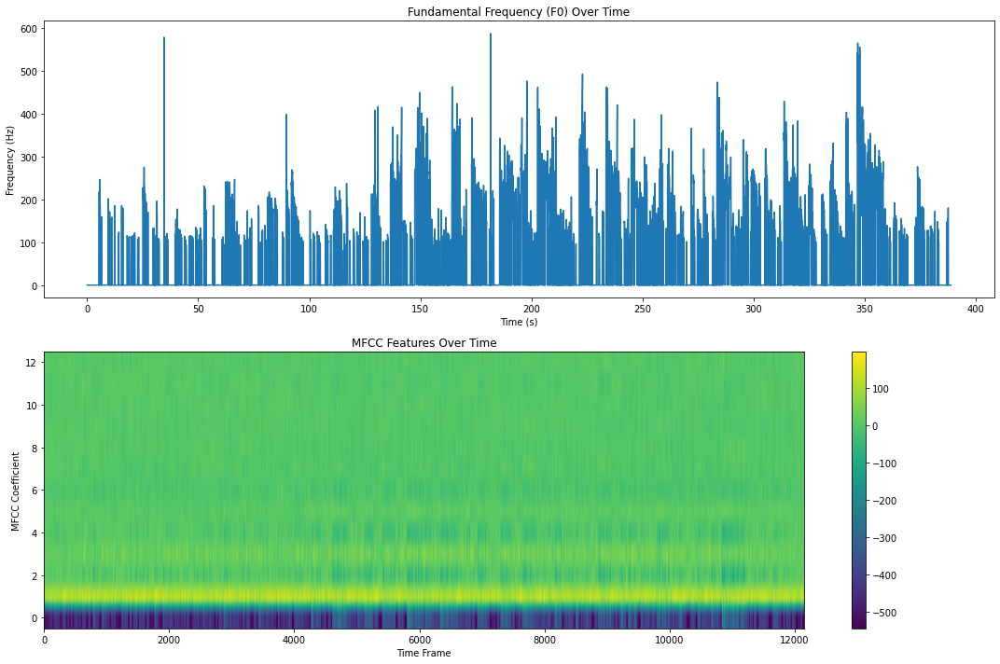

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro06_features.csv


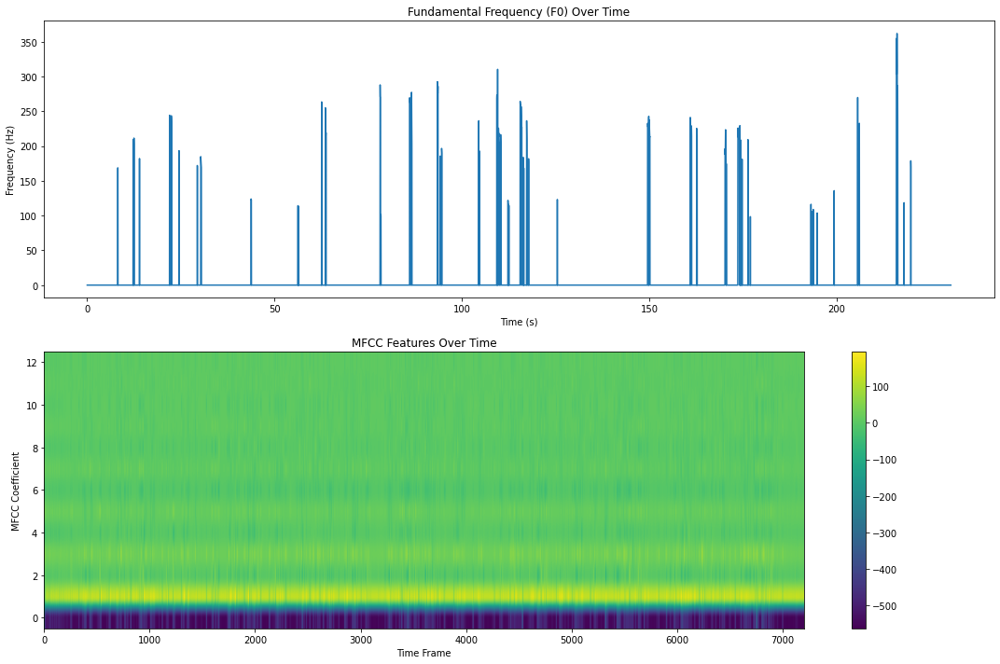

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro07_features.csv


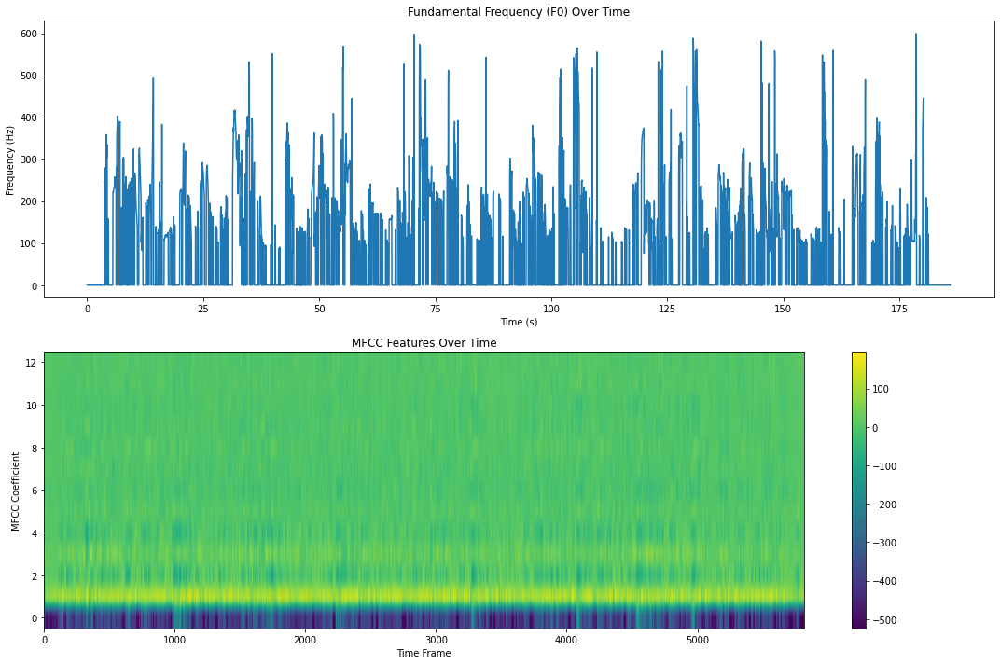

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_impro08_features.csv


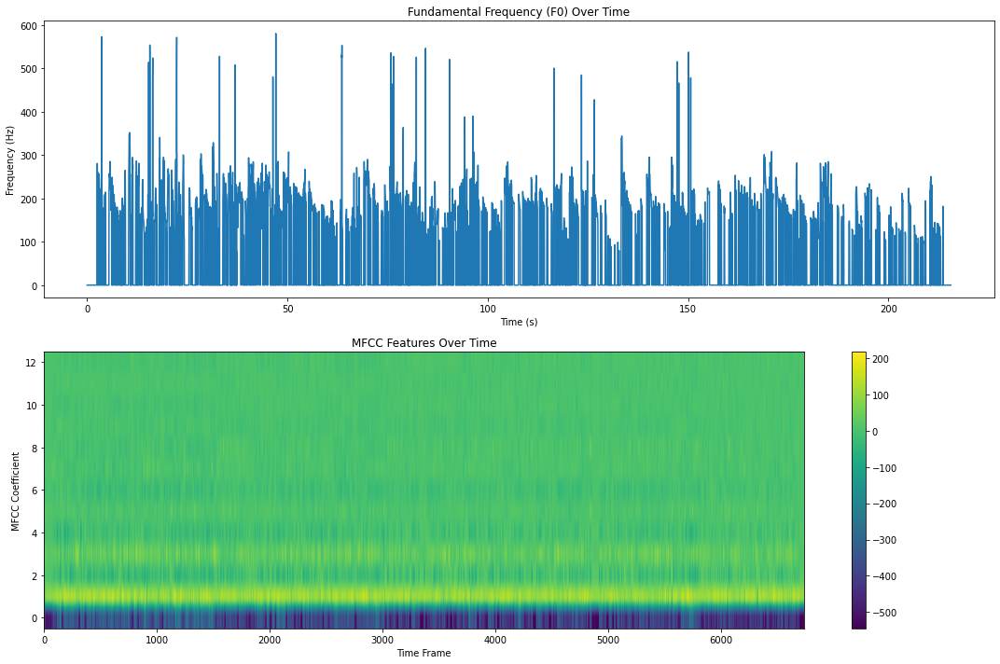

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_script01_1_features.csv


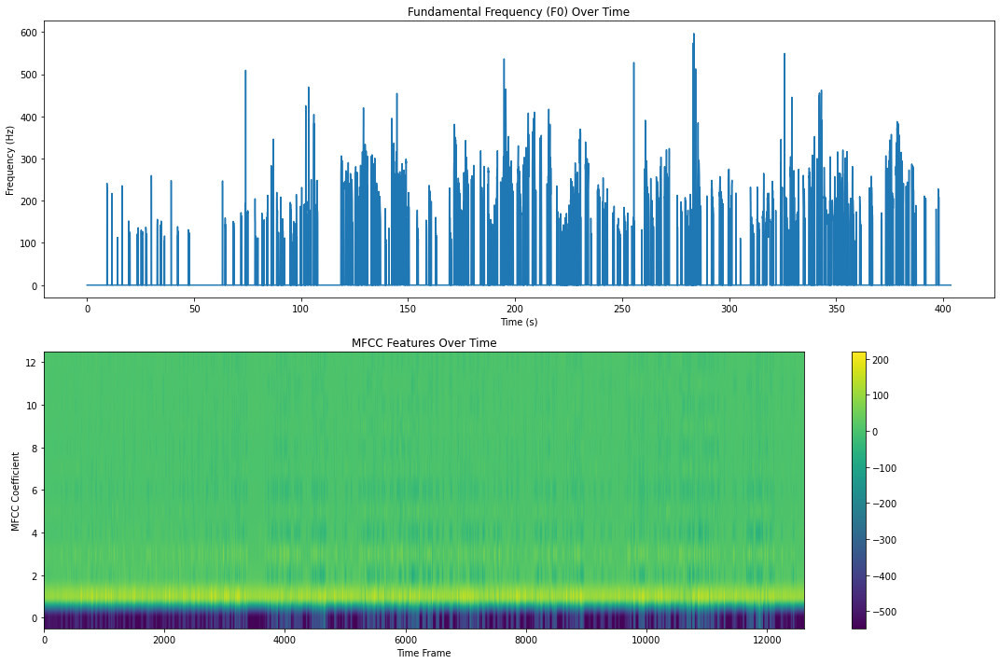

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_script01_2_features.csv


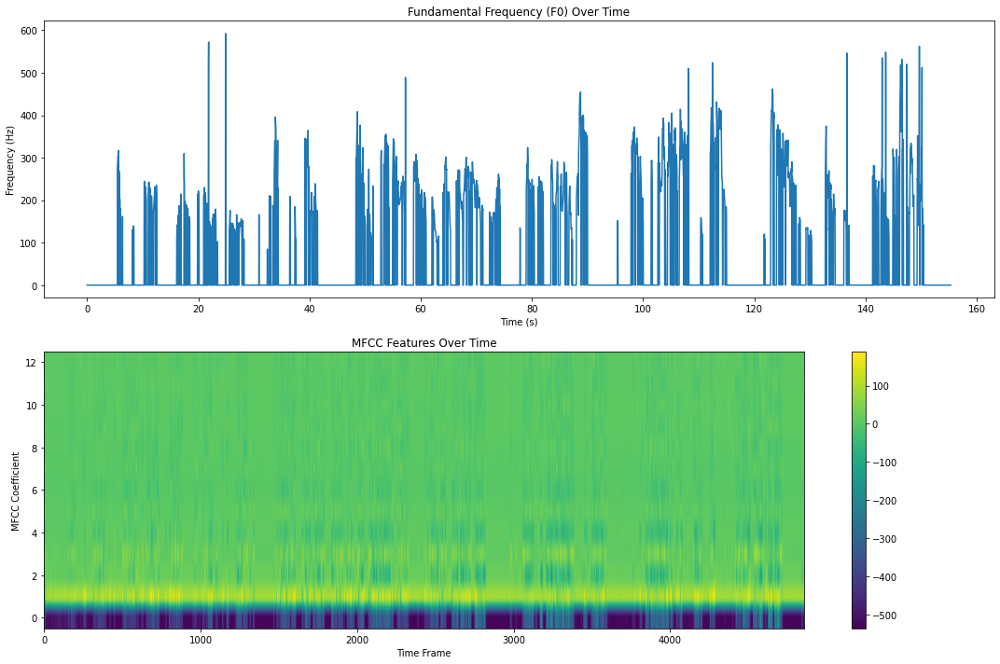

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_script01_3_features.csv


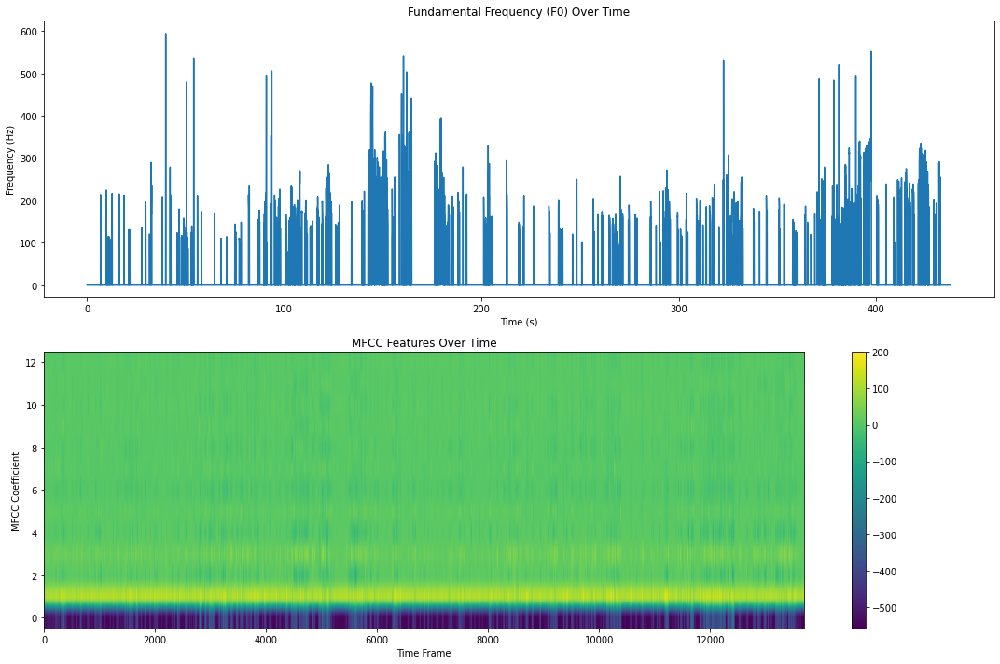

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_script02_1_features.csv


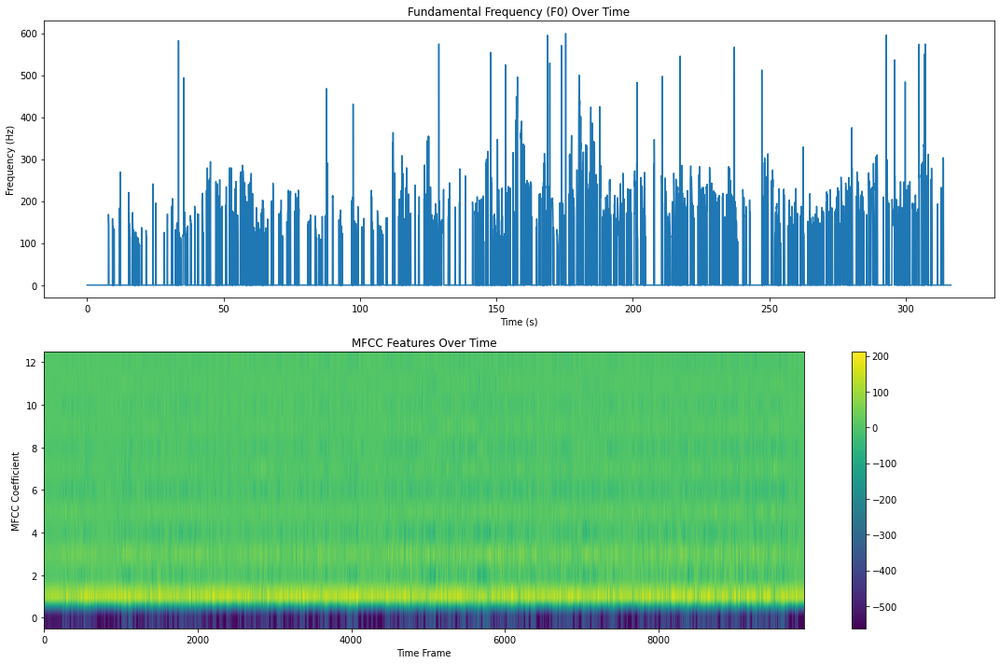

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_script02_2_features.csv


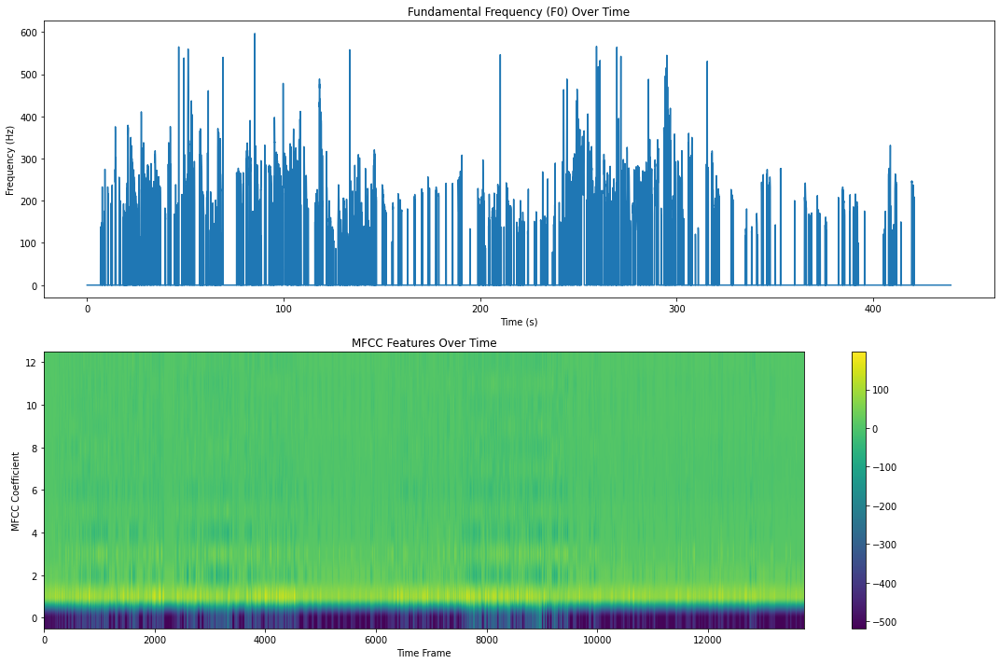

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_script03_1_features.csv


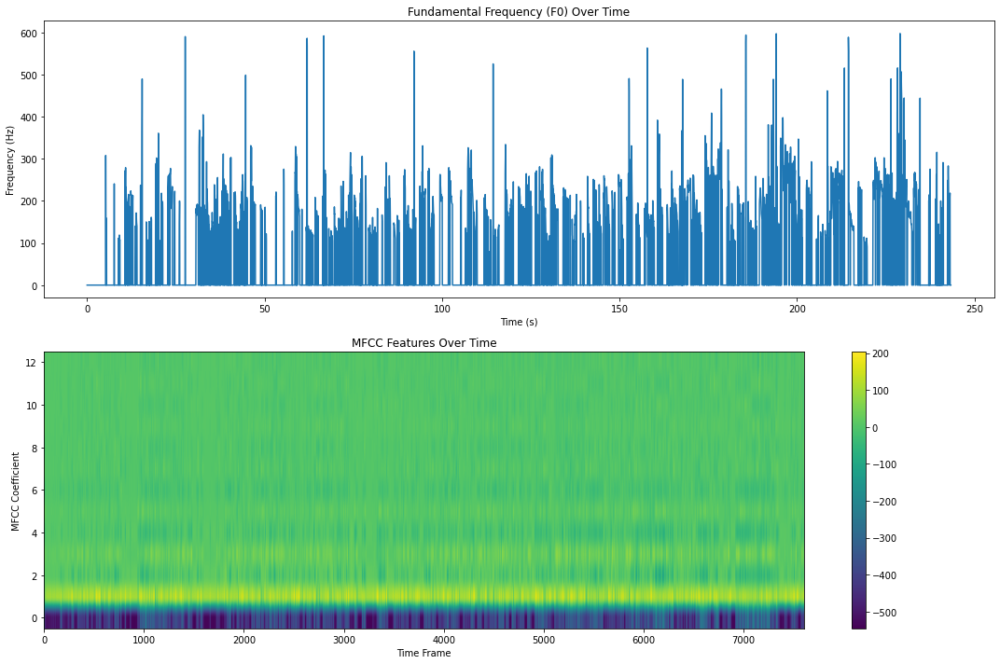

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05F_script03_2_features.csv


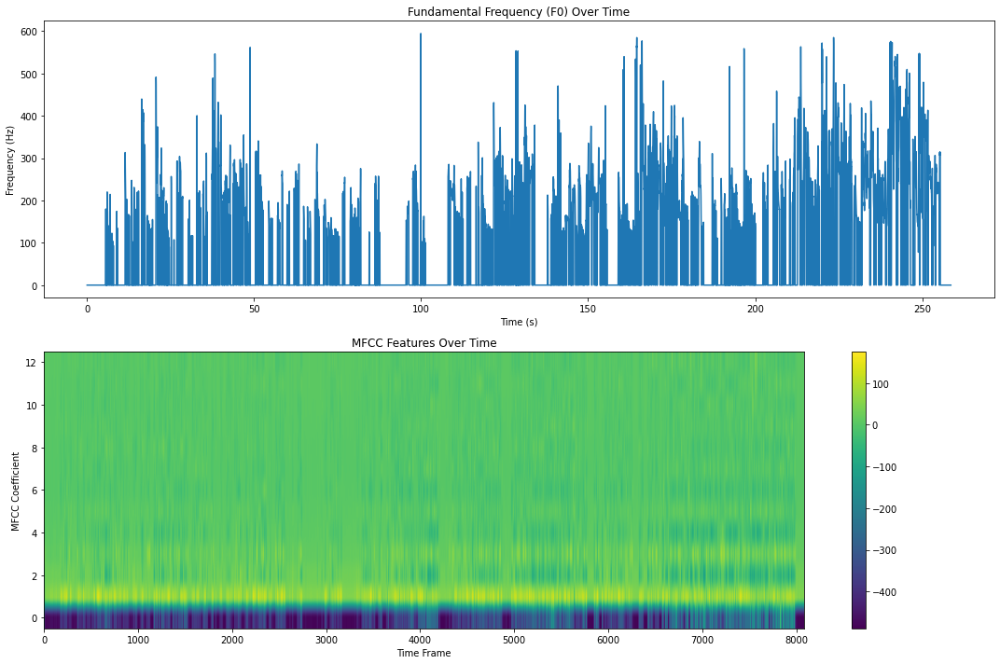

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro01_features.csv


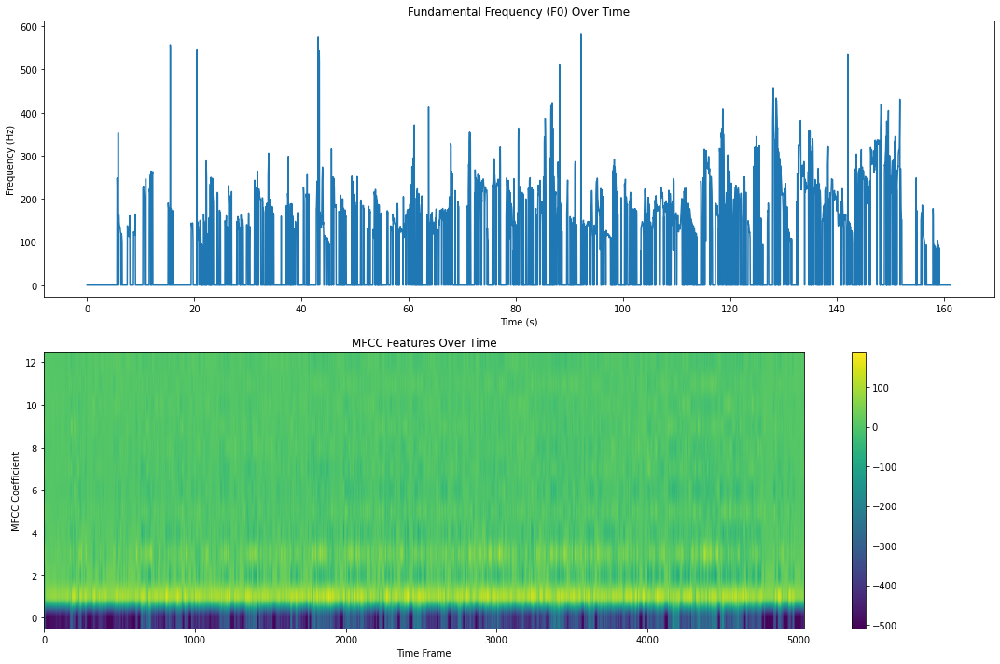

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro02_features.csv


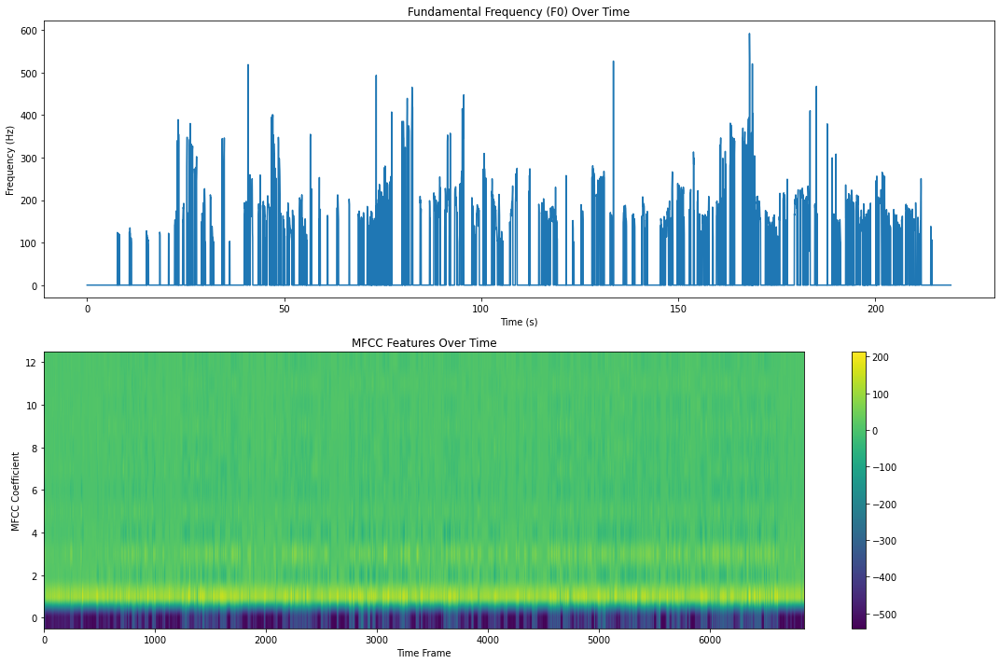

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro03_features.csv


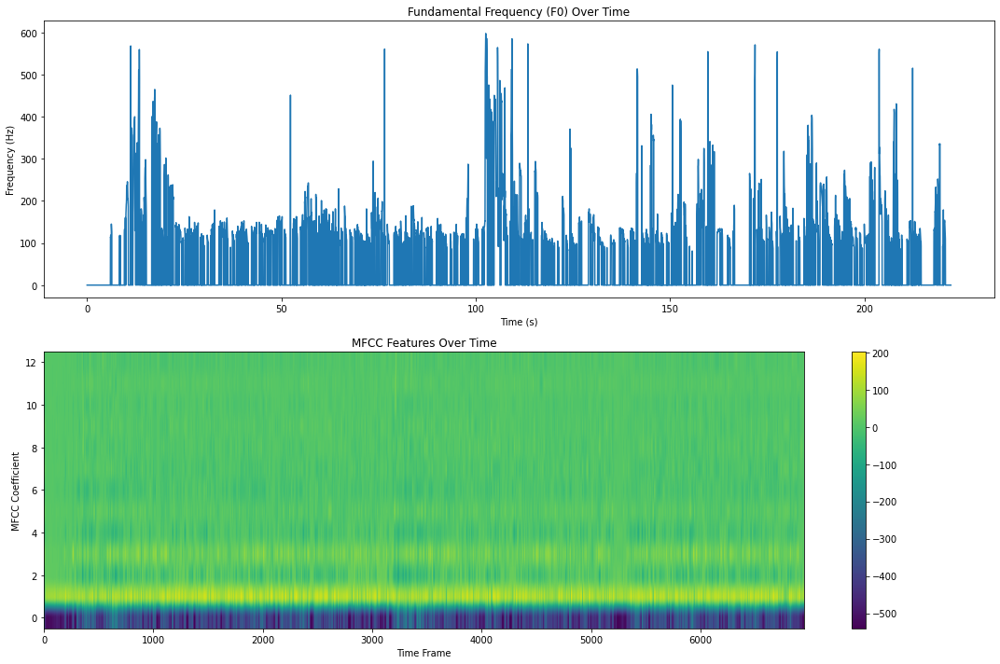

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro04_features.csv


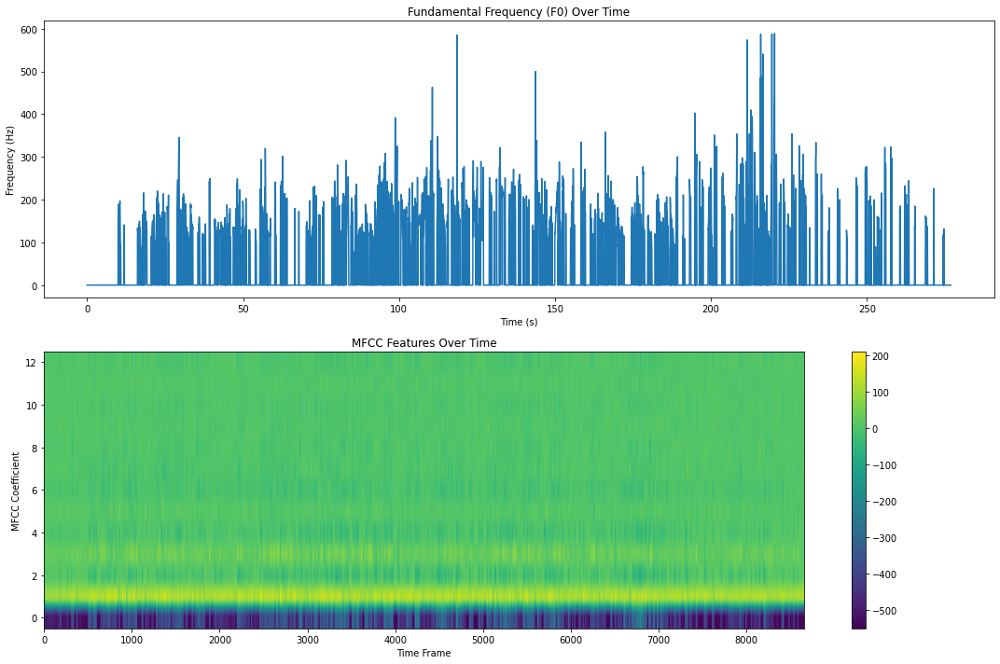

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro05_features.csv


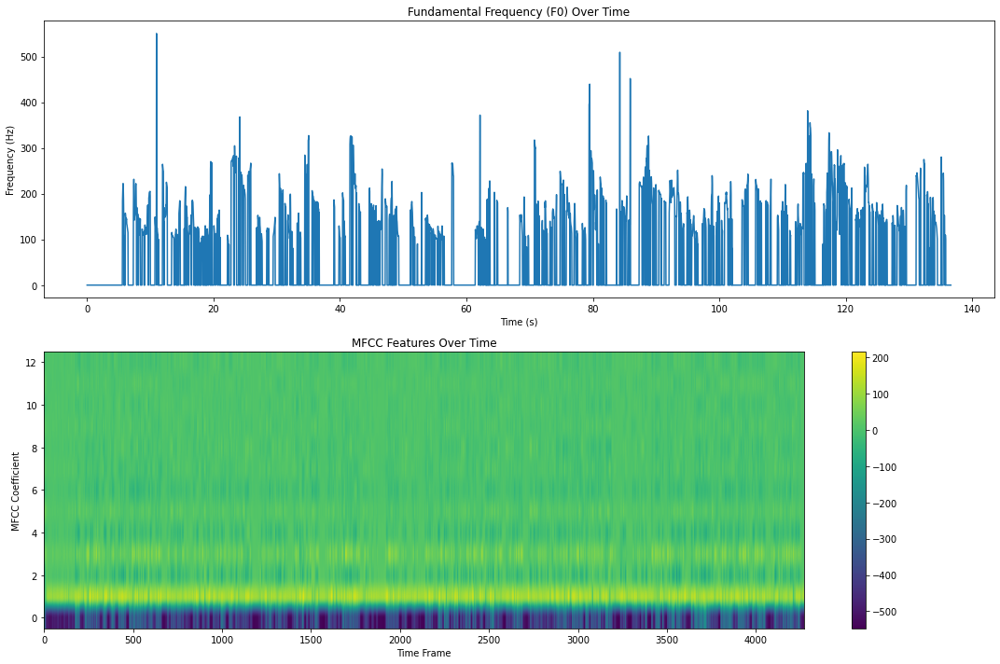

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro06_features.csv


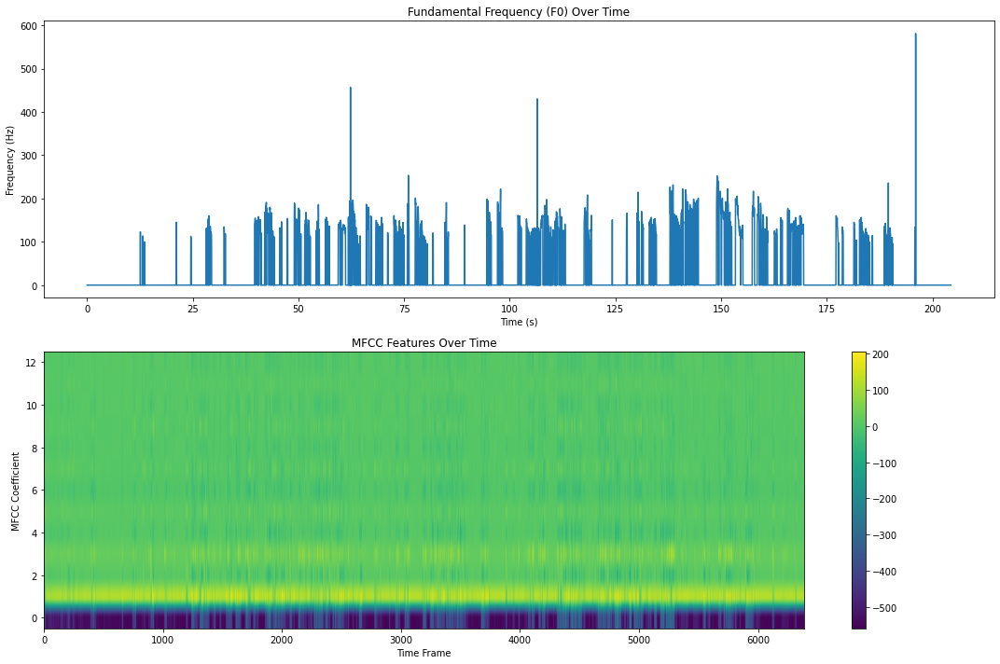

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro07_features.csv


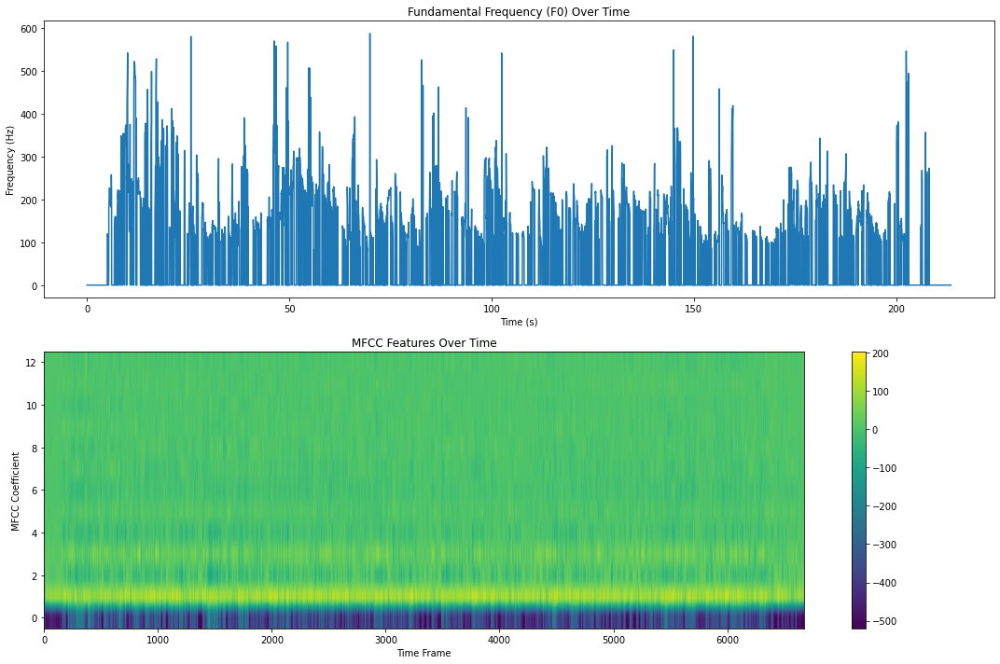

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_impro08_features.csv


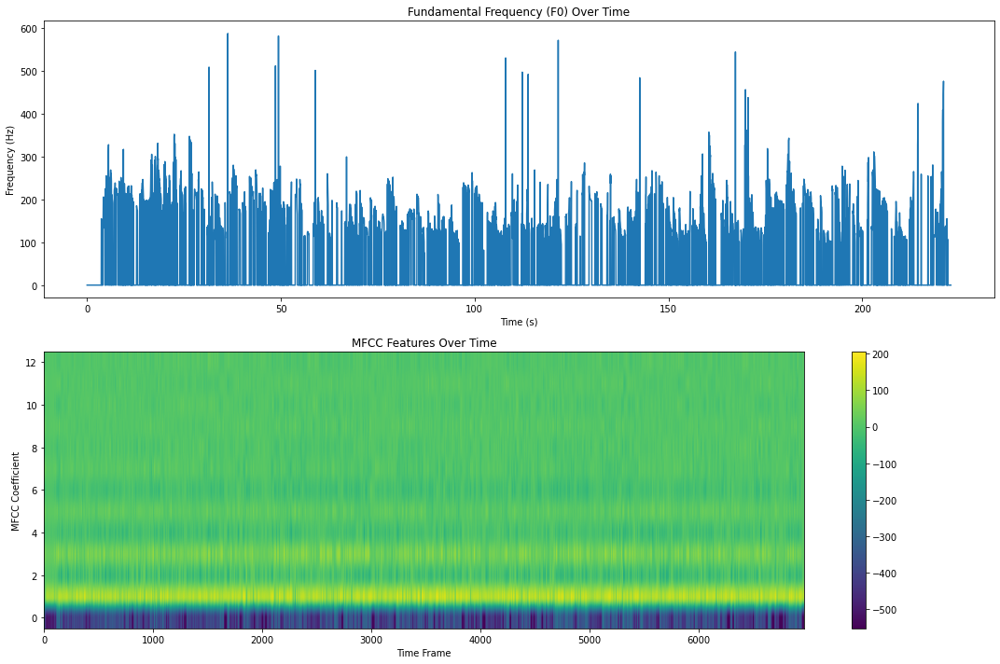

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script01_1b_features.csv


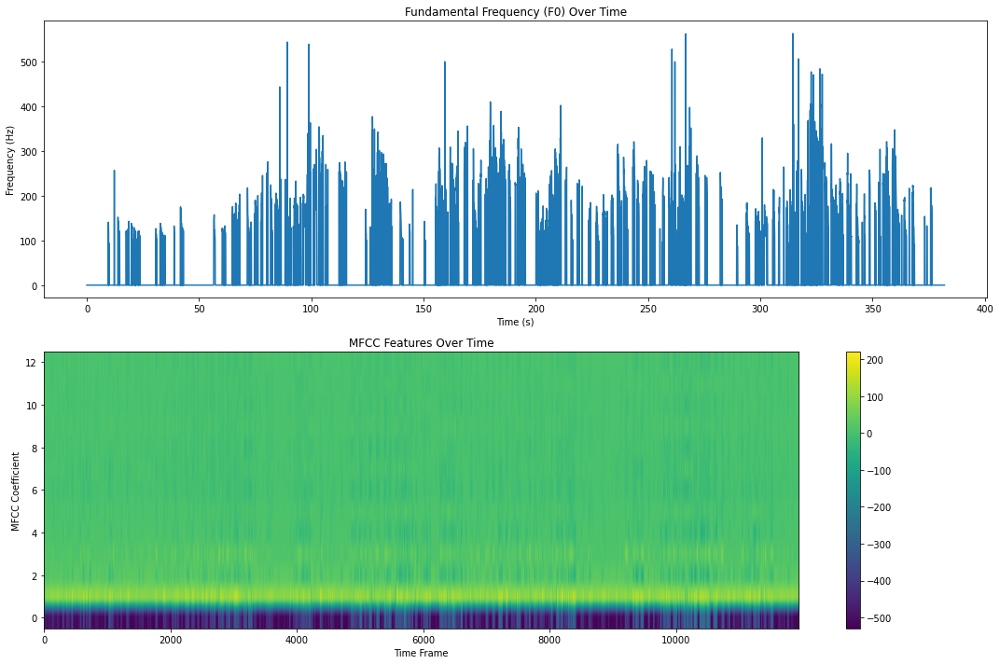

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script01_1_features.csv


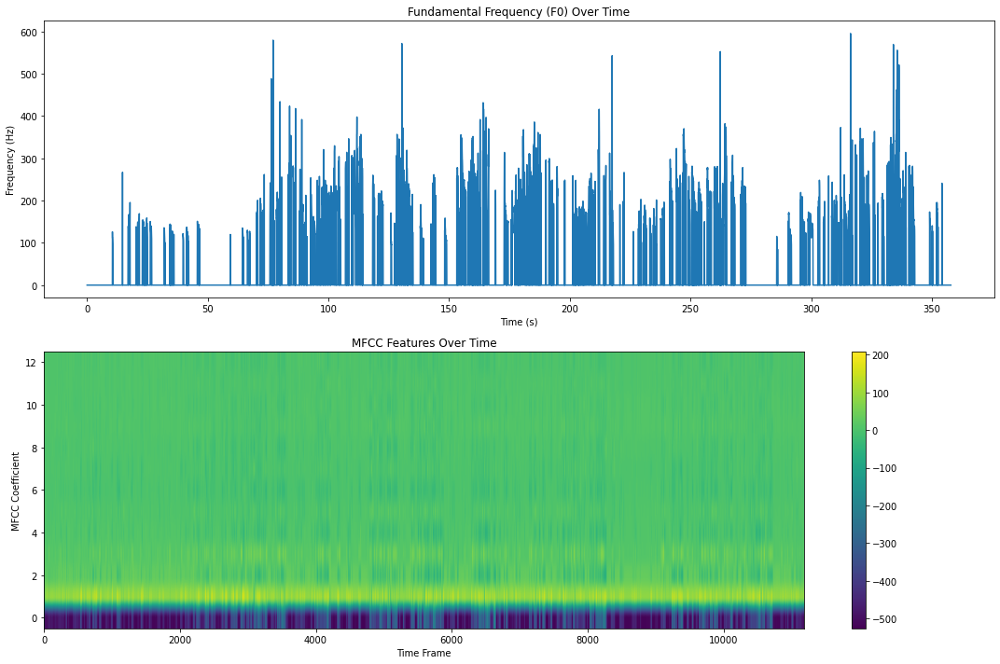

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script01_2_features.csv


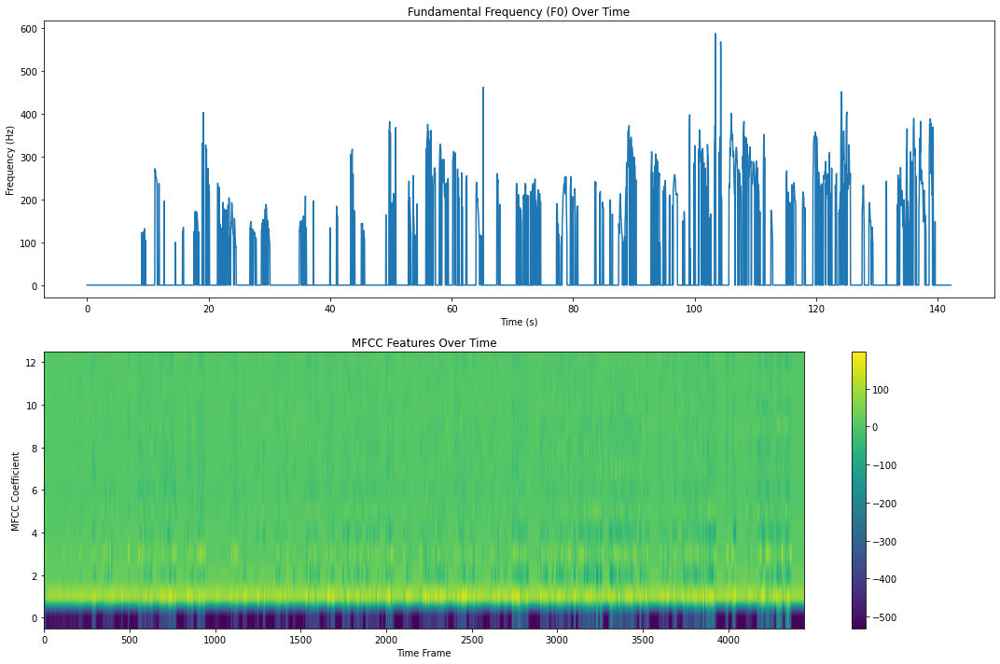

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script01_3_features.csv


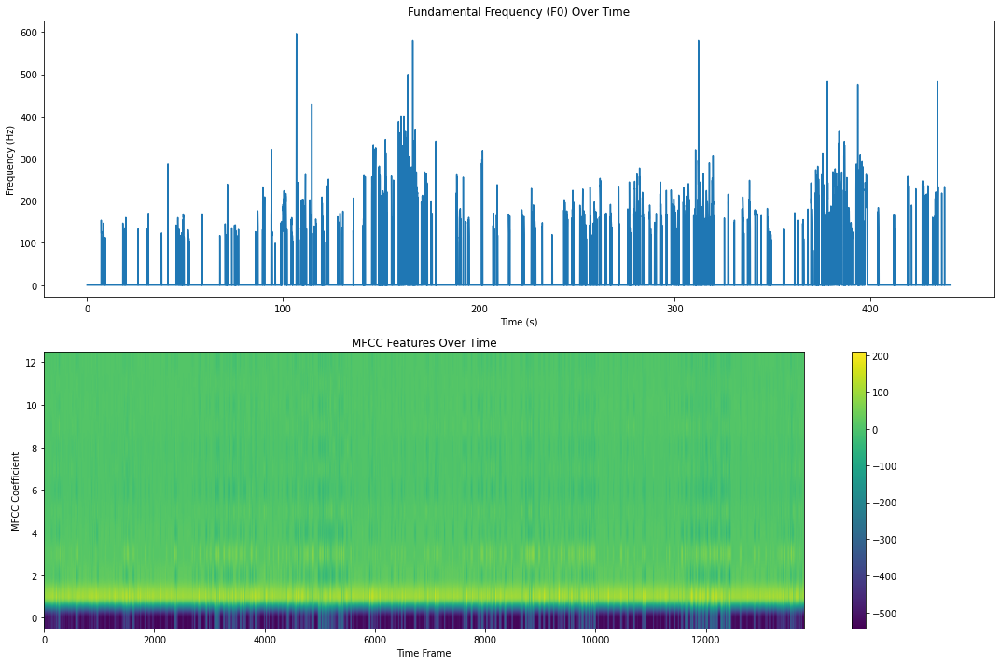

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script02_1_features.csv


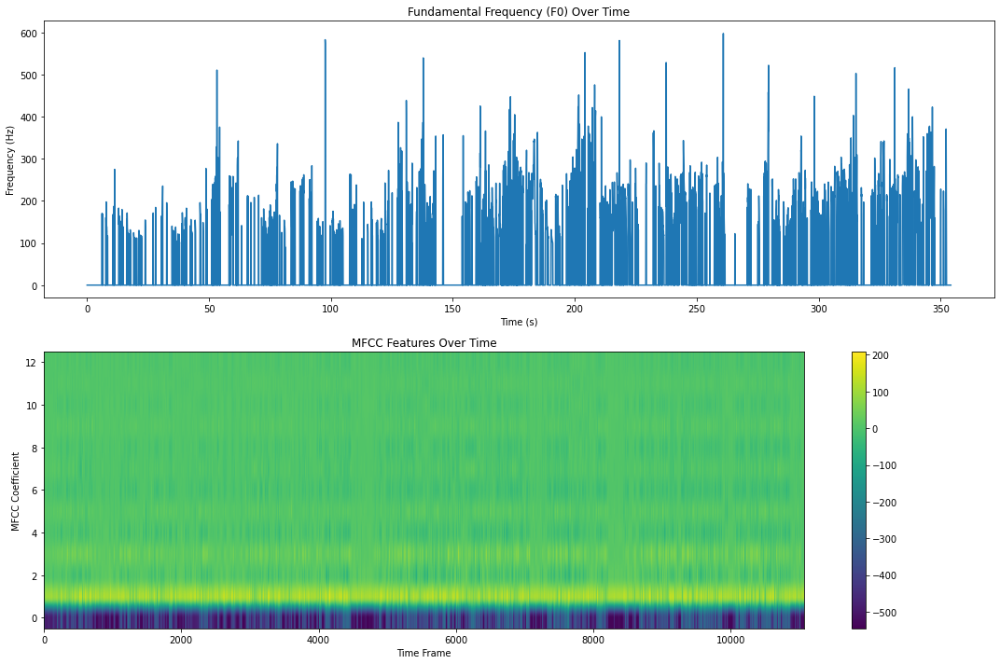

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script02_2_features.csv


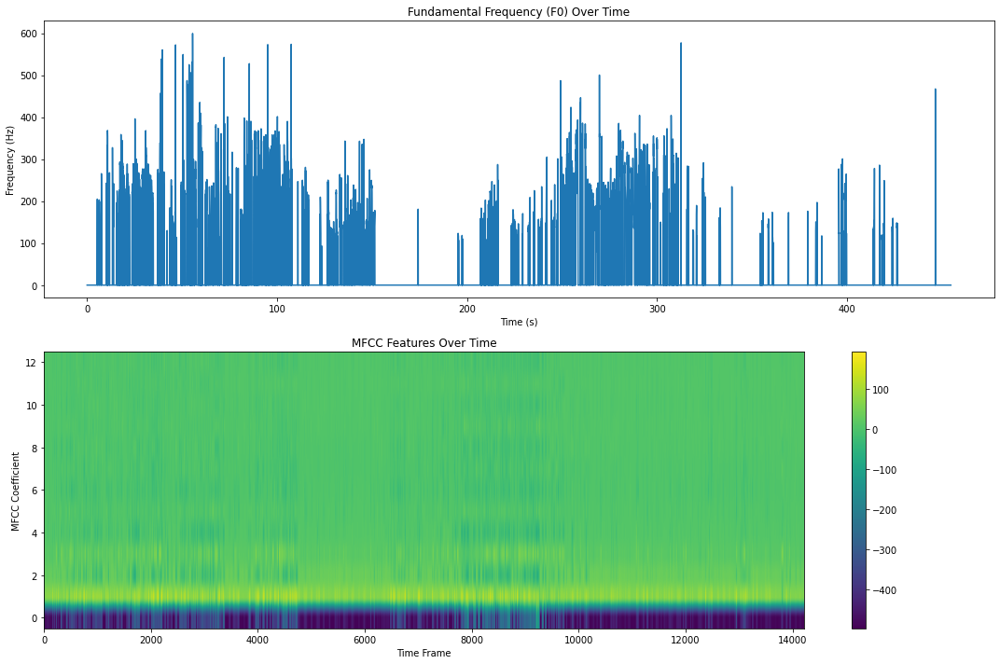

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script03_1_features.csv


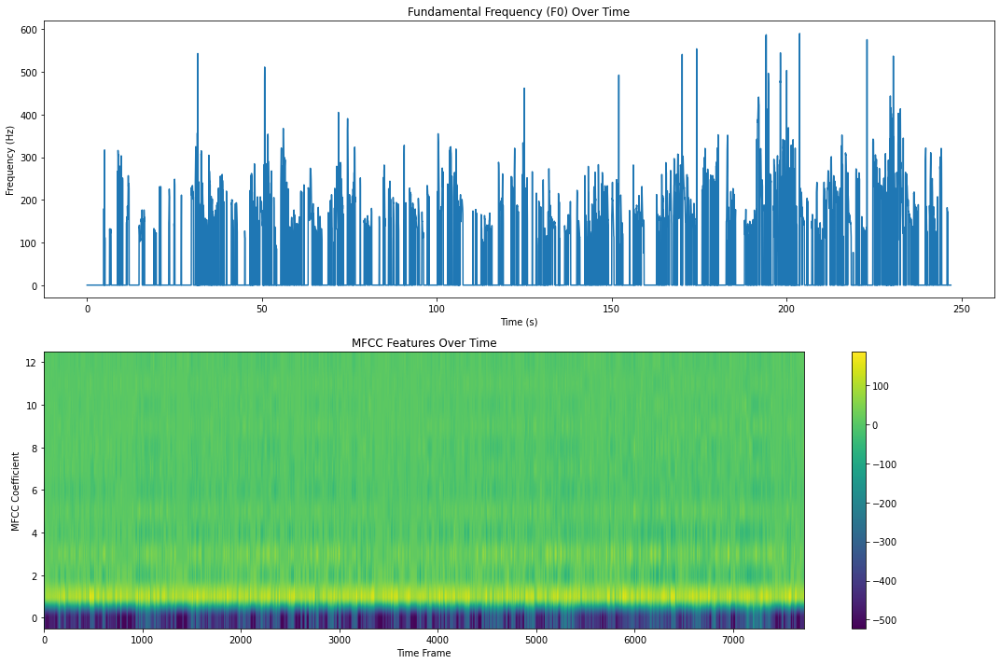

Visualizing features from: C:\Users\hongj\Desktop\Y3 USM\CPC353\Assignment 2\New session\Ses05M_script03_2_features.csv


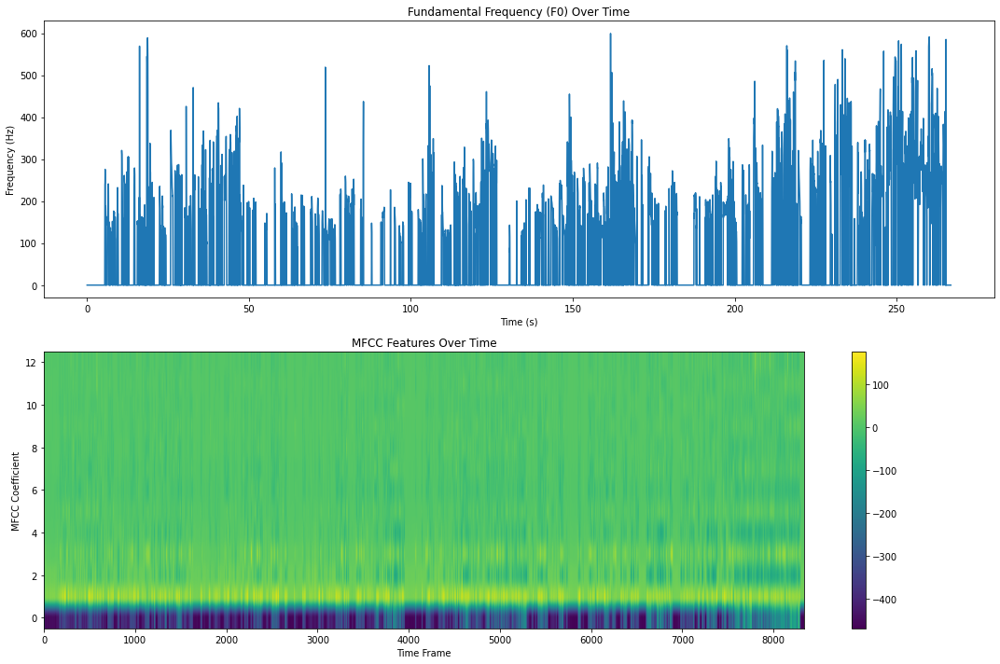

In [22]:
import os

def visualize_all_features(directory):
    csv_files = [f for f in os.listdir(directory) if f.endswith('_features.csv')]
    for csv_file in csv_files:
        csv_path = os.path.join(directory, csv_file)
        print(f"Visualizing features from: {csv_path}")
        visualize_features(csv_path)

# Call the function with the directory containing your CSV files
features_dir = 'C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\New session'
visualize_all_features(features_dir)

In [23]:
# Train model
def train_model():
    train_data, val_data, test_data = prepare_dataset()
    window_size = 50
    X_train, y_train = prepare_sequences(train_data, window_size)
    X_val, y_val = prepare_sequences(val_data, window_size)
    model = create_model((window_size, X_train.shape[-1]))

    callbacks = [
        ModelCheckpoint('best_model.keras', monitor='val_auc', save_best_only=True, mode='max'),
        ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=8, min_lr=0.00001, mode='min'),
        EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True),
        TimeLimit(hours=1),
        Progress(),
        #MemoryUsage(),
        CSVLogger('training_log.csv')
    ]

    print("Starting GPU training...")
    start_time = time.time()
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=400, batch_size=128, callbacks=callbacks, shuffle=True, verbose=1, use_multiprocessing=True, workers=4)
    print(f"Training took {(time.time() - start_time)/60:.2f} minutes")
    return model, history

Found 1 GPU(s): ['/physical_device:GPU:0']


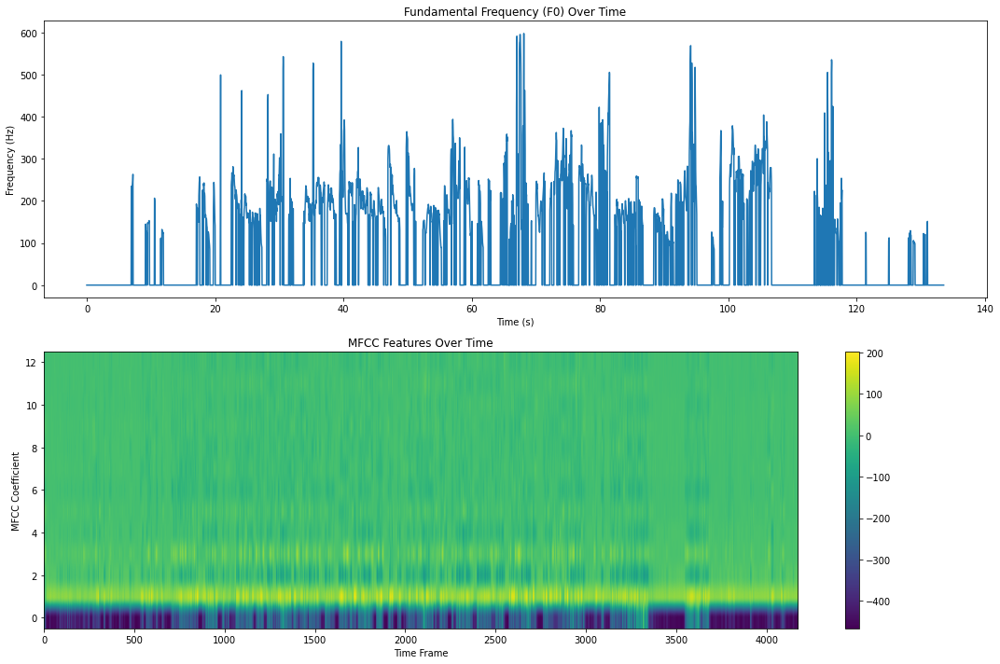

Starting GPU training...
Train on 35458 samples, validate on 12479 samples

Epoch 1/400
Epoch 1/400
Batch 0, loss: 14.8678, time: 6.04s
35458/35458 [==============================] - 19s 532us/sample - loss: 12.6771 - accuracy: 0.5178 - recall_1: 0.4603 - precision_1: 0.3357 - auc_1: 0.5059 - val_loss: 10.4268 - val_accuracy: 0.6634 - val_recall_1: 0.0243 - val_precision_1: 0.4106 - val_auc_1: 0.5165

Epoch 2/400
Epoch 2/400
Batch 0, loss: 10.7788, time: 0.04s
35458/35458 [==============================] - 11s 315us/sample - loss: 9.4121 - accuracy: 0.5420 - recall_1: 0.4311 - precision_1: 0.3476 - auc_1: 0.5176 - val_loss: 8.0544 - val_accuracy: 0.6517 - val_recall_1: 0.0715 - val_precision_1: 0.3783 - val_auc_1: 0.5358

Epoch 3/400
Epoch 3/400
Batch 0, loss: 8.2284, time: 0.04s
35458/35458 [==============================] - 11s 318us/sample - loss: 7.3272 - accuracy: 0.5565 - recall_1: 0.3856 - precision_1: 0.3489 - auc_1: 0.5192 - val_loss: 6.3369 - val_accuracy: 0.6587 - val_recall

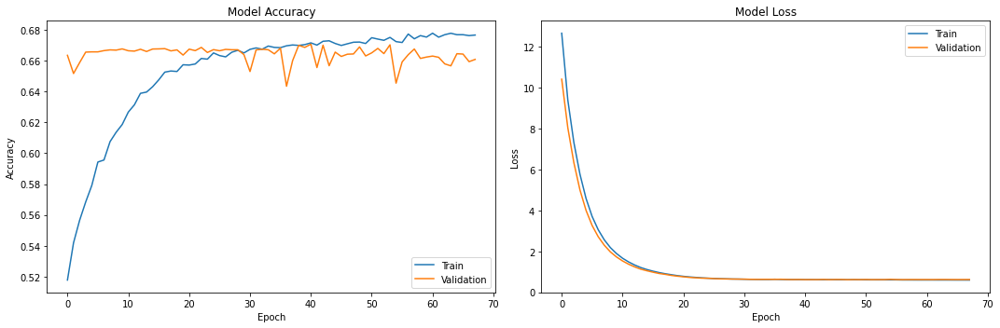

Optimal threshold: 0.343
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.57      0.65      9474
           1       0.43      0.65      0.51      4758

    accuracy                           0.59     14232
   macro avg       0.59      0.61      0.58     14232
weighted avg       0.65      0.59      0.60     14232

Confusion Matrix:
[[5362 4112]
 [1683 3075]]


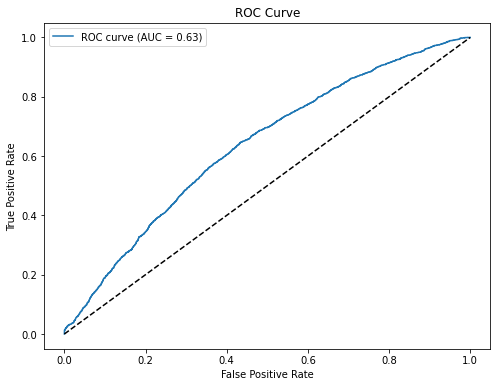

In [24]:
# Main execution
if __name__ == "__main__":
    check_gpu()
    features_dir = 'C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\New session'
    sample_csv = os.path.join(features_dir, 'Ses01F_impro01_features.csv')
    if os.path.exists(sample_csv):
        visualize_features(sample_csv)
    else:
        print(f"File not found: {sample_csv}")

    model, history = train_model()
    plot_training_history(history)
    _, _, test_data = prepare_dataset()
    evaluate_model(model, test_data, 50)

In [25]:

# Callback to print progress
class Progress(Callback):
    def __init__(self):
        super().__init__()
        self.last_time = time.time()

    def on_epoch_begin(self, epoch, logs=None):
        print(f"\nEpoch {epoch+1}/200")
        self.last_time = time.time()

    def on_batch_end(self, batch, logs=None):
        if batch % 10 == 0:
            current_time = time.time()
            print(f"Batch {batch}, loss: {logs['loss']:.4f}, time: {current_time - self.last_time:.2f}s")
            self.last_time = current_time

In [26]:
# Train model
def train_model():
    train_data, val_data, test_data = prepare_dataset()
    window_size =150
    X_train, y_train = prepare_sequences(train_data, window_size)
    X_val, y_val = prepare_sequences(val_data, window_size)
    model = create_model((window_size, X_train.shape[-1]))

    callbacks = [
        ModelCheckpoint('best_model.keras', monitor='val_auc', save_best_only=True, mode='max'),
        ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=8, min_lr=0.00001, mode='min'),
        EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True),
        TimeLimit(hours=1),
        Progress(),
        #MemoryUsage(),
        CSVLogger('training_log.csv')
    ]

    print("Starting GPU training...")
    start_time = time.time()
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=200, batch_size=128, callbacks=callbacks, shuffle=True, verbose=1, use_multiprocessing=True, workers=4)
    print(f"Training took {(time.time() - start_time)/60:.2f} minutes")
    return model, history

Found 1 GPU(s): ['/physical_device:GPU:0']


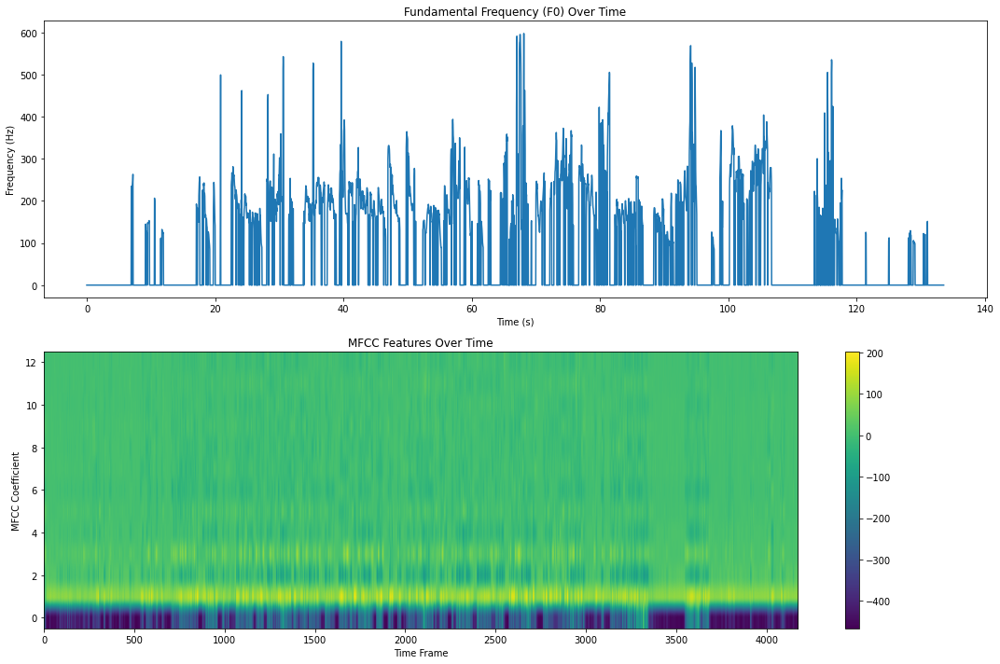

Starting GPU training...
Train on 35982 samples, validate on 12424 samples

Epoch 1/200
Epoch 1/200
Batch 0, loss: 14.9551, time: 6.58s
35982/35982 [==============================] - 34s 954us/sample - loss: 12.5926 - accuracy: 0.5222 - recall_2: 0.4686 - precision_2: 0.3412 - auc_2: 0.5089 - val_loss: 10.2798 - val_accuracy: 0.6486 - val_recall_2: 0.0501 - val_precision_2: 0.3209 - val_auc_2: 0.5228

Epoch 2/200
Epoch 2/200
Batch 0, loss: 10.5765, time: 0.08s
35982/35982 [==============================] - 26s 736us/sample - loss: 8.8855 - accuracy: 0.5321 - recall_2: 0.4165 - precision_2: 0.3361 - auc_2: 0.5066 - val_loss: 7.2574 - val_accuracy: 0.6428 - val_recall_2: 0.0805 - val_precision_2: 0.3437 - val_auc_2: 0.5201

Epoch 3/200
Epoch 3/200
Batch 0, loss: 7.4171, time: 0.09s
35982/35982 [==============================] - 26s 732us/sample - loss: 6.3382 - accuracy: 0.5457 - recall_2: 0.3721 - precision_2: 0.3353 - auc_2: 0.5042 - val_loss: 5.2338 - val_accuracy: 0.6452 - val_recall

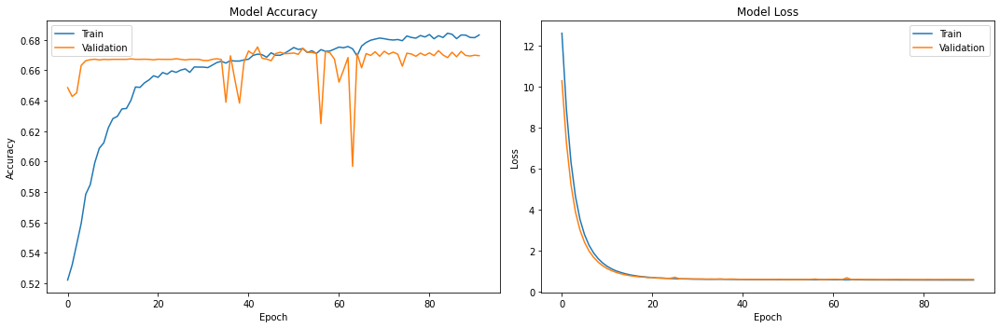

Optimal threshold: 0.352
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.63      0.69      9536
           1       0.45      0.61      0.52      4739

    accuracy                           0.62     14275
   macro avg       0.60      0.62      0.60     14275
weighted avg       0.66      0.62      0.63     14275

Confusion Matrix:
[[5964 3572]
 [1854 2885]]


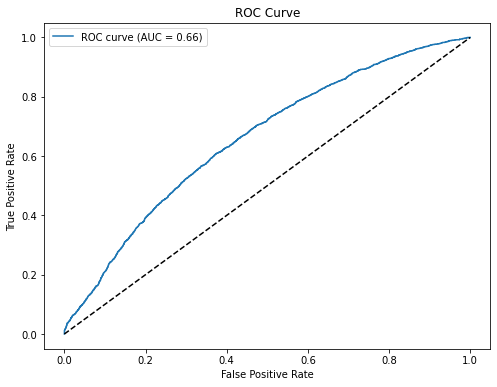

In [27]:
# Main execution
if __name__ == "__main__":
    check_gpu()
    features_dir = 'C:\\Users\\hongj\\Desktop\\Y3 USM\\CPC353\\Assignment 2\\New session'
    sample_csv = os.path.join(features_dir, 'Ses01F_impro01_features.csv')
    if os.path.exists(sample_csv):
        visualize_features(sample_csv)
    else:
        print(f"File not found: {sample_csv}")

    model, history = train_model()
    plot_training_history(history)
    _, _, test_data = prepare_dataset()
    evaluate_model(model, test_data, 150)